In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tqdm.auto import tqdm
import os
import gc

from sklearn.model_selection import GroupKFold, KFold, StratifiedKFold
import lightgbm as lgb
import pickle
from glob import glob

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tqdm.auto import tqdm
import os
import gc
import random
from glob import glob
from sklearn.model_selection import GroupKFold, KFold, StratifiedKFold
import warnings
import seaborn as sns
import re
from requests import get
from sklearn.neighbors import KNeighborsRegressor, NearestNeighbors
from difflib import SequenceMatcher
import lightgbm as lgb
import pickle
import Levenshtein
from sklearn.feature_extraction.text import TfidfVectorizer
from collections import defaultdict
from unidecode import unidecode
import emoji
import re
import pykakasi
from sudachipy import Dictionary, SplitMode
from pythainlp.tokenize import word_tokenize
import pythainlp

random.seed(42)
np.random.seed(42)
warnings.filterwarnings('ignore')

In [2]:
INPUT_PATH = '../input'
OUTPUT_PATH = '../output'
MODEL_PATH = '../models'
TARGET = 'point_of_interest'
N_FOLD = 2

In [3]:
N_NEIGHBORS = 100
NAME_RANK=5
K_NEIGHBORS = 3
DISTANCE = 10000
CATEGORY_COUNT = 100
NAME_THRESHOLD = 0.4

DEBUG = False

def remove_emoji(src_str):
    return ''.join(c for c in src_str if c not in emoji.UNICODE_EMOJI)

In [4]:
with open(os.path.join(OUTPUT_PATH, 'name_variants.pkl'), mode='rb') as f:
    name_dict = pickle.load(f)

In [5]:
kakasi = pykakasi.kakasi()
kakasi.setMode('H', 'a')  # Convert Hiragana into alphabet
kakasi.setMode('K', 'a')  # Convert Katakana into alphabet
kakasi.setMode('J', 'a')  # Convert Kanji into alphabet
conversion = kakasi.getConverter()

def convert_pykakasi(row):
    for column in ["name", "address", "city", "state"]:
        try:
            row[column] = conversion.do(row[column])
        except:
            pass
    return row

tokenizer = Dictionary(dict_type="full").create()

def convert_sudachi(row):
    for column in ["name", "address", "city", "state"]:
        try:
            morphemes = tokenizer.tokenize(row[column], SplitMode.A)
            row[column] = ' '.join([m.reading_form() for m in morphemes if m.reading_form() !='キゴウ'])
        except:
            pass
    return row


def th_romanize(text):
    tokenized_word = word_tokenize(text, engine="newmm")
    romanized_word = [pythainlp.romanize(word, engine='royin') for word in tokenized_word]
    return ' '.join(romanized_word)

def convert_romanize(row):
    for column in ["name", "address", "city", "state"]:
        try:
            row[column] = th_romanize(row[column])
        except:
            pass
    return row

In [6]:
data = pd.read_csv(os.path.join(INPUT_PATH, 'train.csv'))
if DEBUG:
    data = data.iloc[:10000]
print(data.shape)

data[data["country"] == "JP"] = data[data["country"] == "JP"].apply(convert_sudachi, axis=1)
data[data["country"] == "JP"] = data[data["country"] == "JP"].apply(convert_pykakasi, axis=1)
data[data["country"] == "TH"] = data[data["country"] == "TH"].apply(convert_romanize, axis=1)

# cols = ['name', 'address', 'city', 'state']
cols = ['name']
# cols = ['name', 'address', 'city', 'state', 'zip', 'country', 'url', 'phone'] # categoriesは大文字が小文字になると困る。
for col in cols:
#     if col=='name':
#         data[col].update(data[col].map(name_dict))
    data[col] = data[col].fillna('').apply(unidecode)
    data[col] = data[col].str.lower()
    data[col] = data[col].apply(remove_emoji)

data.head()

(1138812, 13)


,id,name,latitude,longitude,address,city,state,zip,country,url,phone,categories,point_of_interest
0,E_000001272c6c5d,cafe stad oudenaarde,50.859975,3.634196,Abdijstraat,Nederename,Oost-Vlaanderen,9700,BE,NaN,NaN,Bars,P_677e840bb6fc7e
1,E_000002eae2a589,carioca manero,-22.907225,-43.178244,NaN,NaN,NaN,NaN,BR,NaN,NaN,Brazilian Restaurants,P_d82910d8382a83
2,E_000007f24ebc95,rantatpm ka ra ket,13.780813,100.484900,,,,NaN,TH,NaN,NaN,Salons / Barbershops,P_b1066599e78477
3,E_000008a8ba4f48,turkcell,37.844510,27.844202,Adnan Menderes Bulvarı,NaN,NaN,NaN,TR,NaN,NaN,Mobile Phone Shops,P_b2ed86905a4cd3
4,E_00001d92066153,restaurante casa cofino,43.338196,-4.326821,NaN,Caviedes,Cantabria,NaN,ES,NaN,NaN,Spanish Restaurants,P_809a884d4407fb


In [7]:
def sub(x):
    return re.sub(r'[^a-zA-Z0-9 ]', ' ', x)
cols = ['name', 'address', 'city', 'state']
# cols = ['name']
for col in cols:
    data[col] = data[col].fillna('').apply(sub)
    data[f'{col}_split'] = data[col].str.split()

In [8]:
# if MOJIBAKE:
#     data.loc[data['name'].str.contains('[买哪侈为裤溦发围货浓调时吧间价爱处灵节怎么办]', na=False), ['name', 'address', 'city']] = '<MOJIBAKE>'

In [9]:
kf = GroupKFold(n_splits=N_FOLD)
for i, (_, val_idx) in enumerate(kf.split(data, data[TARGET], data[TARGET])):
    data.loc[val_idx, "cv"] = i
print(data["cv"].value_counts())

1.0    569406
0.0    569406
Name: cv, dtype: int64


# add Data

In [10]:
with open(os.path.join(OUTPUT_PATH, 'id2com_30.pkl'), mode='rb') as f:
    id2com = pickle.load(f)
node_df = pd.read_csv(os.path.join(OUTPUT_PATH, 'node_df.csv'))
node_df.columns = ['main_category', 'id_code', 'adjacency_frequency', 'betweeness_centrality', 'clustering_coefficient', 'co_net']
node_df = node_df[['main_category', 'adjacency_frequency', 'betweeness_centrality', 'clustering_coefficient', 'co_net']]

def add_co_net(x):
    if x is np.nan:
        return np.nan
    out = -1
    for cat in x.split(', '):
        if cat in id2com.keys():
            out = id2com[cat]
            break

    return out

data['co_net'] = data['categories'].apply(add_co_net)

In [11]:
def add_main_category(x):
    if x is np.nan:
        return np.nan

    return x.split(', ')[0]

data['main_category'] = data['categories'].apply(add_main_category)

In [12]:
aggregated_df = pd.read_csv(os.path.join(INPUT_PATH, 'aggregated_df.csv'))
aggregated_df = aggregated_df.iloc[2:]
aggregated_df.columns = ['main_category', 'median_distances_max', 'median_distances_75', 'median_distances_median', 'median_distances_25', 'median_distances_min', 'count']

float_cols = ['median_distances_max', 'median_distances_75', 'median_distances_median', 'median_distances_25', 'median_distances_min']
aggregated_df[float_cols] = aggregated_df[float_cols].astype(float)
aggregated_df['count'] = aggregated_df['count'].astype(int)
aggregated_df['category_rate'] = aggregated_df['count'] / aggregated_df['count'].sum() # leakではない？

aggregated_df.head()


,main_category,median_distances_max,median_distances_75,median_distances_median,median_distances_25,median_distances_min,count,category_rate
2,ATMs,1.446457e+07,27032.192275,4490.248044,1012.594350,0.000000,1366,0.002505
3,Acai Houses,1.350800e+05,17781.269899,6117.784384,1359.040401,19.017952,25,0.000046
4,Accessories Stores,1.317399e+07,17636.724841,4397.253023,1609.960599,0.000000,890,0.001632
5,Acehnese Restaurants,1.394807e+05,28385.619678,11585.417039,6524.589277,308.232222,22,0.000040
6,Acupuncturists,1.099943e+06,30876.313672,5262.894842,1160.926141,0.000000,67,0.000123


In [13]:
large_scales = list(aggregated_df[(aggregated_df['median_distances_median']>=DISTANCE) & (aggregated_df['count']>=CATEGORY_COUNT)].main_category)
small_scales = list(aggregated_df[(aggregated_df['median_distances_median']<DISTANCE) & (aggregated_df['count']>=CATEGORY_COUNT)].main_category)

def add_scale(x):
    categories = x.split(", ")
    out = -1
    for cat in categories:
        if cat in large_scales:
            out = 1
            break
        if cat in small_scales:
            out = 0
            break
    return out

data['scale'] = data['categories'].fillna('').apply(add_scale)
data.scale.value_counts()

 0    897808
 1    127772
-1    113232
Name: scale, dtype: int64

In [14]:
cols = ['main_category', 'adjacency_frequency', 'betweeness_centrality', 'clustering_coefficient']
data= data.merge(node_df[cols], on='main_category', how='left')

cols = ['main_category', 'median_distances_median', 'category_rate'] # maxとかはリークな気がする。
data= data.merge(aggregated_df[cols], on='main_category', how='left')

In [15]:
# category similarity
cats = data.categories.fillna('')

cat_stats = {}

for c in cats:
    csplit = c.split(", ")
    for c_ in csplit:
        if c_ not in cat_stats:
            cat_stats[c_] = [1, {ca: 1 for ca in csplit}]
        else:
            prev_cat_stats = cat_stats[c_]
            prev_cat_stats[0] += 1
            prev_sims = prev_cat_stats[1]
            
            for ca in csplit:
                prev_sims[ca] = prev_sims.get(ca, 0) + 1
        
for c, val in cat_stats.items():
    
    overall_count = sum(v for ca, v in val[1].items() if ca != c and v > 1)
    
    new_probs = {c: 1.0}
    if overall_count != 0:
        new_probs.update({ca: round(v / overall_count, 3) for ca, v in val[1].items() if v / overall_count > 0.01 and ca != c and v > 1})
        cat_stats[c] = [1.0, new_probs]
        
def get_cat_similarity(cat1, cat2):
    
    if cat1 == '' or cat2 == '':
        return 0.000000001
    
    if cat1 in cat2 or cat2 in cat1:
        return 1.0
    
    best = 0
    
    for c1 in cat1.split(", "):
        for c2 in cat2.split(", "):
            if c1 in cat_stats:
                best = max(best, cat_stats[c1][1].get(c2, 0))
            if c2 in cat_stats:
                best = max(best, cat_stats[c2][1].get(c1, 0))
    
    return best
get_cat_similarity('Bars', 'Cafes, Restaurants')

0.065

In [16]:
hkmeans_cols = [ 'hkmeans_labels', 'name_kmeans_labels', 'address_kmeans_labels',
       'ix_values_kmeans_labels', 'mix_kmeans_labels', 'category_kmeans_labels']

intermed = pd.read_csv(os.path.join(INPUT_PATH, 'train_intermed2.csv'))[hkmeans_cols]
data = pd.concat([data, intermed], axis=1)
del intermed

In [17]:
# len(intermed[['sp_address_raw', 'sp_name', 'sp_address', 'pseudo_geo_city_ix',
#        'pseudo_city_ix', 'pseudo_state_ix', 'country_ix']].pseudo_state_ix.unique())

# Generate Train Data

In [18]:
def get_name_contain(name, match_name):
    name = name.replace(' ', '')
    match_name = match_name.replace(' ', '')
    if name=='' or match_name=='':
        return False
    elif name==match_name or name in match_name or match_name in name:
        return True
    else:
        return False

def sm_ratio_name(name, match_name):
    return SequenceMatcher(None, name, match_name).ratio()

def get_name_iou(name_split, match_name_split):
    if len(set(name_split) | set(match_name_split))==0:
        return 0
    else:
        return len(set(name_split) & set(match_name_split)) / len(set(name_split) | set(match_name_split))

def apply_get_cat_similarity(categories, match_categories):
    return get_cat_similarity(categories, match_categories)

def recall_knn_name(df, Neighbors = 10):
    train = pd.DataFrame()
    dfs = []
    Neighbors = min(Neighbors, len(df))
    print(f'{Neighbors=}')
    knn = NearestNeighbors(n_neighbors = Neighbors)
    knn.fit(df[['latitude','longitude']], df.index)
    dists, nears = knn.kneighbors(df[['latitude','longitude']])
    
    for k in tqdm(range(Neighbors)):            
        cur_df = df[['id']]
        cur_df['match_id'] = df['id'].values[nears[:, k]]
        cur_df['kdist'] = dists[:, k]
        cur_df['kneighbors'] = k
        
        cols = ['name', 'categories']
        for col in cols:
            cur_df[col] = df[col]
            cur_df[f'match_{col}'] = df[col].values[nears[:, k]]

        cols = ['name']
        for col in cols:
            cur_df[f'{col}_split'] = df[f'{col}_split']
            cur_df[f'match_{col}_split'] = df[f'{col}_split'].values[nears[:, k]]
            cur_df[f'{col}_iou'] = np.vectorize(get_name_iou)(cur_df[f'{col}_split'], cur_df[f'match_{col}_split'])
        
        cur_df['name_contain'] = np.vectorize(get_name_contain)(cur_df['name'], cur_df[f'match_name'])
        cur_df['cat_similarity'] = np.vectorize(apply_get_cat_similarity)(cur_df['categories'].fillna(''), cur_df['match_categories'].fillna(''))
        cur_df = cur_df[(cur_df['cat_similarity']>0.0) | (cur_df['kneighbors']<K_NEIGHBORS) | (cur_df['name_iou']>0.0) | (cur_df['name_contain'])]
#                        | (cur_df['address_iou']>0.0)| (cur_df['city_iou']>0.0)| (cur_df['state_iou']>0.0)]
#         cur_df = cur_df[(cur_df['kneighbors']<K_NEIGHBORS) | (cur_df['name_iou']>0.0)]
        dfs.append(cur_df)
        
        if k!=0 and (k % 50 == 0 or k==Neighbors-1):
            print(f'calc rank: {k}')
            tmp = pd.concat(dfs)
            tmp['sm_ratio_name'] = np.vectorize(sm_ratio_name)(tmp['name'], tmp['match_name'])
            tmp['name_rank'] = 99 # 念の為、入れておく
#             tmp['cat_rank'] = 99 # 念の為、入れておく
            train = pd.concat([train, tmp])
            train['name_rank'] = train.groupby('id')['sm_ratio_name'].rank(ascending=False, method='dense')
#             train['cat_rank'] = train.groupby('id')['cat_similarity'].rank(ascending=False, method='dense')
            train = train[((train['name_rank']<=NAME_RANK) & train['sm_ratio_name']>0.0) | 
                                  (train['categories']==train['match_categories']) | (train['sm_ratio_name']>=NAME_THRESHOLD) | 
#                                   (train['cat_similarity']==1.0) | (train['sm_ratio_name']>=NAME_THRESHOLD) | 
#                                   ((train['cat_rank']<=CAT_RANK) & (train['cat_similarity']>0.0) & (train['sm_ratio_name']>0.0)) | 
                                  (train['kneighbors']<K_NEIGHBORS)]
            del tmp, dfs
            dfs = []

    return train

cvs = []
for i in range(N_FOLD):
    tmp = recall_knn_name(data[data['cv']==i], N_NEIGHBORS)
#     tmp = tmp[ ((tmp['sm_ratio_name']>FILTER) & (tmp['name_rank']<=NAME_RANK)) |
#               (tmp['kneighbors']<K_NEIGHBORS) | (tmp['sm_ratio_name']>NAME_THRESHOLD)] # 念の為
    tmp['cv'] = i
    cvs.append(tmp)
train = pd.concat(cvs)
print(train.shape)
train.drop(['name', 'match_name', 'sm_ratio_name', 'name_split', 'match_name_split', 'categories', 'match_categories', 'sm_ratio_name'], axis=1, inplace=True)
train.head()
# 10112386

Neighbors=100


  0%|          | 0/100 [00:00<?, ?it/s]

calc rank: 50
calc rank: 99
Neighbors=100


  0%|          | 0/100 [00:00<?, ?it/s]

calc rank: 50
calc rank: 99
(10581657, 16)


,id,match_id,kdist,kneighbors,name_iou,name_contain,cat_similarity,name_rank,cv
1,E_000002eae2a589,E_000002eae2a589,0.0,0,1.0,True,1.0,1.0,0
2,E_000007f24ebc95,E_000007f24ebc95,0.0,0,1.0,True,1.0,1.0,0
3,E_000008a8ba4f48,E_000008a8ba4f48,0.0,0,1.0,True,1.0,1.0,0
4,E_00001d92066153,E_00001d92066153,0.0,0,1.0,True,1.0,1.0,0
5,E_000023d8f4be44,E_000023d8f4be44,0.0,0,1.0,True,1.0,1.0,0


In [19]:
id2index_d = dict(zip(data['id'].values, data.index)) # tf-idfで使う
data = data.set_index('id')

In [20]:
for col in ['co_net', 'scale']:
    col_values = data.loc[train['id']][col].values
    matcol_values = data.loc[train['match_id']][col].values
    train[col] = col_values
    train[f'match_{col}'] = matcol_values
    train[f'is_match_{col}'] = train[col]==train[f'match_{col}']
# train.drop(['co_net', 'match_co_net', 'scale', 'match_scale'], axis=1, inplace=True)

In [21]:
num_cols = ['adjacency_frequency', 'betweeness_centrality', 'clustering_coefficient', 'median_distances_median', 'category_rate']
for col in num_cols:
    col_values = data.loc[train['id']][col].values
    matcol_values = data.loc[train['match_id']][col].values
    train[col] = col_values
    train[f'match_{col}'] = matcol_values
    train[f'mean_{col}'] = (train[col] + train[f'match_{col}']) / 2
#     train.drop([col, f'match_{col}'], axis=1, inplace=True)

In [22]:
for col in hkmeans_cols:
    col_values = data.loc[train['id']][col].values
    matcol_values = data.loc[train['match_id']][col].values
    train[col] = col_values
    train[f'match_{col}'] = matcol_values
    train[f'diff_{col}'] = (train[col] - train[f'match_{col}']).abs() # 一致しているかだけで差はあまり関係ないと思うが。

In [23]:
# label作り

ids = train['id'].tolist()
match_ids = train['match_id'].tolist()

poi = data.loc[ids]['point_of_interest'].values
match_poi = data.loc[match_ids]['point_of_interest'].values

train['label'] = np.array(poi == match_poi, dtype = np.int8)

# Check Maximum Score

In [24]:
y_true = pd.read_csv(os.path.join(INPUT_PATH, 'train.csv'))[['id', 'point_of_interest']]
def get_id2poi(input_df: pd.DataFrame) -> dict:
    return dict(zip(input_df['id'], input_df['point_of_interest']))

def get_poi2ids(input_df: pd.DataFrame) -> dict:
    return input_df.groupby('point_of_interest')['id'].apply(set).to_dict()

id2poi = get_id2poi(y_true)
poi2ids = get_poi2ids(y_true)
del y_true

In [25]:
ids = list(data.index.unique())
oof_pred = {
   id_x: [id_x] for id_x in ids
}

for idx, row in tqdm(train.iterrows()):
    if row['label']==1:
        oof_pred[row['id']].append(row['match_id'])

0it [00:00, ?it/s]

In [26]:
# for base, match in oof_pred.items():
#     if len(match) == 1:        
#         continue

#     for m in match:
#         if base not in oof_pred[m]:
#             oof_pred[m].append(base)

In [27]:
ids = list(data.index.unique())
scores = []

for id_x in tqdm(ids):
    preds = set(oof_pred[id_x])
    targets = poi2ids[id2poi[id_x]]
    score = len((targets & preds)) / len((targets | preds))
    scores.append(score)
print('max score is ', np.array(scores).mean())
# 0.913(30, co_net)
# 50: 0.928(5), 0.930(10)
# 100: 0.930, 0.938
# 200: 0.934
# 300: 0.938

# scale(10000)
# 50: 0.928
# 300: 0.941

# 0.926
# 0.918
# 0.933
# 0.940
# 0.941

  0%|          | 0/1138812 [00:00<?, ?it/s]

max score is  0.9439394101224088


In [28]:
train['label'].value_counts()
# 0    5067914
# 1    1980366

# 0    3326444
# 1    1952844

0    8446378
1    2135279
Name: label, dtype: int64

In [29]:
train.label.mean()
# 0.232
# 0.223

0.20179060803048143

In [30]:
train.to_csv(os.path.join(OUTPUT_PATH, 'train_tmp2.csv'), index = False)
# train = pd.read_csv(os.path.join(OUTPUT_PATH, 'train_tmp2.csv'))

In [31]:
data.to_csv(os.path.join(OUTPUT_PATH, 'data_tmp.csv'))
# data = pd.read_csv(os.path.join(OUTPUT_PATH, 'data_tmp.csv'))
# data = data.set_index('id')

# data2 = pd.read_csv(os.path.join(INPUT_PATH, 'train.csv'))
# id2index_d = dict(zip(data2['id'].values, data2.index))
# del data2

In [32]:
def reduce_mem_usage(df):
    """ iterate through all the columns of a dataframe and modify the data type
        to reduce memory usage.        
    """
    start_mem = df.memory_usage().sum() / 1024**2
    print('Memory usage of dataframe is {:.2f} MB'.format(start_mem))
    
    for col in df.columns:
        col_type = df[col].dtype
        
        if col_type != object:
            c_min = df[col].min()
            c_max = df[col].max()
            if str(col_type)[:3] == 'int':
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    df[col] = df[col].astype(np.int8)
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    df[col] = df[col].astype(np.int16)
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                    df[col] = df[col].astype(np.int32)
                elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                    df[col] = df[col].astype(np.int64)  
            else:
                if c_min > np.finfo(np.float16).min and c_max < np.finfo(np.float16).max:
                    df[col] = df[col].astype(np.float16)
                elif c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                    df[col] = df[col].astype(np.float32)
                else:
                    df[col] = df[col].astype(np.float64)
        else:
            print(col)
            pass
#             df[col] = df[col].astype('category')

    end_mem = df.memory_usage().sum() / 1024**2
    print('Memory usage after optimization is: {:.2f} MB'.format(end_mem))
    print('Decreased by {:.1f}%'.format(100 * (start_mem - end_mem) / start_mem))
    
    return df

train = reduce_mem_usage(train)

Memory usage of dataframe is 3754.02 MB
id
match_id
Memory usage after optimization is: 1200.88 MB
Decreased by 68.0%


## Candidate Miss Sampling

In [33]:
for id_x in tqdm(ids):
    preds = set(oof_pred[id_x])
    targets = poi2ids[id2poi[id_x]]
    if preds != targets:
        print(f'preds: {preds}')
        print(f'targets: {targets}')
        print(f'{TARGET}: {id2poi[id_x]}')

  0%|          | 0/1138812 [00:00<?, ?it/s]

preds: {'E_f4b00a6db8b587', 'E_0000764d65557e', 'E_0507e10f6eb526'}
targets: {'E_30424388e6852c', 'E_0000764d65557e', 'E_f4b00a6db8b587', 'E_7da6445404a886', 'E_0507e10f6eb526'}
point_of_interest: P_be89c778befb23
preds: {'E_0001e184ce8606'}
targets: {'E_e9df025ab2137d', 'E_0001e184ce8606'}
point_of_interest: P_2a664c8450634b
preds: {'E_00035714ebb9bd'}
targets: {'E_00035714ebb9bd', 'E_2ef141766542d5'}
point_of_interest: P_8b661ff5637bf4
preds: {'E_000496a549f3f6'}
targets: {'E_ed54d340510cc8', 'E_000496a549f3f6'}
point_of_interest: P_92ed48e31b0ab7
preds: {'E_0004ea391c9404', 'E_f3b021594596f6', 'E_dc5a1a772a0232'}
targets: {'E_0004ea391c9404', 'E_f3b021594596f6', 'E_dc5a1a772a0232', 'E_a071c37e006bb3'}
point_of_interest: P_05e49abcfbc6e9
preds: {'E_ae19bb72dbdd23', 'E_269b689a5e1d5c', 'E_59c88fd30a46fa', 'E_95066a24f45573', 'E_e69cb833ca9396', 'E_0005a0ec201631'}
targets: {'E_7364fa80311796', 'E_f1d38d7791b2ea', 'E_bc7b633ffc12ce', 'E_dae15405912d55', 'E_f0c3f14da8bc01', 'E_9de6b67fa

preds: {'E_00f225272c8905'}
targets: {'E_00f225272c8905', 'E_9b17b027e3569b'}
point_of_interest: P_e6e95b11780257
preds: {'E_00f28bd12db746'}
targets: {'E_00f28bd12db746', 'E_0278ef4f14ca9f'}
point_of_interest: P_ab7895757b2c0a
preds: {'E_1d4d2de4982877', 'E_6df7fda7737f72', 'E_a6f52c23467075', 'E_4b98666ae7e151', 'E_c1a7a0c5248c8b', 'E_00f40775f59131'}
targets: {'E_1d4d2de4982877', 'E_6df7fda7737f72', 'E_a6f52c23467075', 'E_c47b1beae9a0e0', 'E_4b98666ae7e151', 'E_5fd979a73b8e0d', 'E_c1a7a0c5248c8b', 'E_00f40775f59131', 'E_c37f51a8be6e7c'}
point_of_interest: P_4e4467f232c058
preds: {'E_00f4126a3408a1'}
targets: {'E_d383ccadb50721', 'E_c72eddbcecbde2', 'E_b6836b37c574eb', 'E_56d1cb5530e79b', 'E_f0688f74fa04e3', 'E_570e595a0c2155', 'E_4efdafbcd07b20', 'E_b438d50390230c', 'E_46ef95847e0610', 'E_4d1e3f36d6f0ad', 'E_32ac3640b720c3', 'E_d7d202a524d4db', 'E_da80ff62ad60d6', 'E_3ee27a715dbdcd', 'E_d55a8aa27b2f87', 'E_b65dae20d6350a', 'E_00f4126a3408a1', 'E_2aed4fdf08f987', 'E_bba3c9afc50594', 

targets: {'E_a541a2f09fe170', 'E_1c102ada90189c', 'E_6f8bcd8aba41db', 'E_1c46c304af94f3', 'E_01a172b11e60a4', 'E_f9b77376196223', 'E_d0f4ce3e24e512'}
point_of_interest: P_929524a3ac3e5d
preds: {'E_01a1d4dba1cad6', 'E_0d7a698ce90ebc'}
targets: {'E_01a1d4dba1cad6', 'E_cd9b99ef808fbb', 'E_0d7a698ce90ebc'}
point_of_interest: P_90c0982f0be7cc
preds: {'E_9f9f0949fa2b2b', 'E_01a21fcd5001a9', 'E_e0b34005a203ee'}
targets: {'E_9f9f0949fa2b2b', 'E_e0b34005a203ee', 'E_01a21fcd5001a9', 'E_121d4494e12b63'}
point_of_interest: P_8e51eec0c999f6
preds: {'E_01a279ca8a32f7', 'E_4bc123278b689c'}
targets: {'E_01a279ca8a32f7', 'E_4bc123278b689c', 'E_3160d0ca6e2ade'}
point_of_interest: P_cc629440073ea6
preds: {'E_01a341fcf8c9e1'}
targets: {'E_01a341fcf8c9e1', 'E_446fdfdff1a077'}
point_of_interest: P_851868249d5a0d
preds: {'E_f3dc39a85b44aa', 'E_3a707c932da7f9', 'E_86493fdcff0915', 'E_01a3d36ec33fee', 'E_cb26c71175c821', 'E_35a6d7662d96a9'}
targets: {'E_0828b713449227', 'E_f3dc39a85b44aa', 'E_3a707c932da7f9', 

point_of_interest: P_438521c0ca480c
preds: {'E_02dd782645f9e2'}
targets: {'E_02dd782645f9e2', 'E_63e73a7f20d67c'}
point_of_interest: P_d9713feb23d2f2
preds: {'E_0b2c490286187d', 'E_f852f5e5fd6fed', 'E_02dd8c40db5704', 'E_49df4e66034ede'}
targets: {'E_0b2c490286187d', 'E_add53c6d209ff8', 'E_02dd8c40db5704', 'E_49df4e66034ede', 'E_f852f5e5fd6fed'}
point_of_interest: P_298b579ebed59c
preds: {'E_02dd9abea881f2'}
targets: {'E_02dd9abea881f2', 'E_f0eb5d9963bd1a'}
point_of_interest: P_86d73ef7f67f39
preds: {'E_02ddfba16cc1d4', 'E_aaa332288d0c32'}
targets: {'E_02ddfba16cc1d4', 'E_aaa332288d0c32', 'E_8b793dedae842d'}
point_of_interest: P_81d1b37b3c4ae7
preds: {'E_fe1ca694a8958f', 'E_02dea5e6063bcb'}
targets: {'E_fe1ca694a8958f', 'E_02dea5e6063bcb', 'E_0c5407c4b04ca0'}
point_of_interest: P_fedb5316941cb4
preds: {'E_02df6f5cfaa7ff', 'E_fca37b7c04b019', 'E_3d998e471bfa01', 'E_7de6e5b1500e5d', 'E_6b1eb3c772be8c', 'E_1d4c836cfc1a09'}
targets: {'E_7a91d31123bbdd', 'E_0508e315cf54f4', 'E_02df6f5cfaa7f

preds: {'E_0418d6e41c8086'}
targets: {'E_c3a2b7a89fc607', 'E_0418d6e41c8086', 'E_63502065d9f149'}
point_of_interest: P_ea3ec1c1aa5a14
preds: {'E_5f76be46a7715c', 'E_041a31adcc14d1'}
targets: {'E_99acd051247043', 'E_5f76be46a7715c', 'E_041a31adcc14d1'}
point_of_interest: P_5f368ed8da17cc
preds: {'E_041ba0bd21f5e1'}
targets: {'E_ac1f217ccf86d7', 'E_041ba0bd21f5e1'}
point_of_interest: P_05d939269cf95c
preds: {'E_041bfdb4f40ed3', 'E_afbbeb6cbf1d7b'}
targets: {'E_efb71c301b900b', 'E_041bfdb4f40ed3', 'E_93e5626b62f291', 'E_afbbeb6cbf1d7b'}
point_of_interest: P_9ce8f4f714fd96
preds: {'E_041c3ce8092f60', 'E_1eced4ac95ec3c'}
targets: {'E_041c3ce8092f60', 'E_644345ae95be63', 'E_1eced4ac95ec3c'}
point_of_interest: P_7db94df0f91ff5
preds: {'E_934661d5b4d91d', 'E_041cc4978cc62a'}
targets: {'E_934661d5b4d91d', 'E_a5a1df5450618c', 'E_041cc4978cc62a'}
point_of_interest: P_74f2e3d7f45703
preds: {'E_b3d1cae8b7bb6a', 'E_e8a1fc4ca81838', 'E_0f2b05d8156037', 'E_5c03fe50388b9a', 'E_e1fbbab21c2eb0', 'E_7cd20

point_of_interest: P_3f6dbeaf586ad5
preds: {'E_057eb4cb6c9ee7'}
targets: {'E_057eb4cb6c9ee7', 'E_96044b80d9ae79'}
point_of_interest: P_8f24f99648f3b7
preds: {'E_057f0dc275d165'}
targets: {'E_49f46b5dea7eb9', 'E_1b1f958ec923e5', 'E_3fa27058f566c3', 'E_ea03f75f23158a', 'E_23884755ab4a85', 'E_02b4afac7935be', 'E_3a3df40fde447b', 'E_5e23ad2ded98c3', 'E_cb20b719698b87', 'E_83cad51b1a1675', 'E_7cf370dd61f332', 'E_174802c5f09f5e', 'E_057f0dc275d165', 'E_01a8cab05571a3', 'E_933692d194f71b', 'E_0451ac54d41e52', 'E_7057bf1f13ae99', 'E_b5754d3a47fdd0', 'E_232054ce6613ea', 'E_df4d3ca873f77e', 'E_ebd98fbb84a0c4', 'E_3edf32d5507894', 'E_a70174319f409d', 'E_f7c761f009e344', 'E_380fd80a4b691d', 'E_0289d81e89f97e', 'E_4678bf3d68ff36', 'E_8113bc591851d6', 'E_b535c06113a1a5', 'E_865b82e7ac9520', 'E_aa3ff4e5bb57bc', 'E_ef93c3a7969853', 'E_003d6af6b46b5d', 'E_043d6c4bf773c0', 'E_79760ff3698045', 'E_6384e8c676fe9a', 'E_c7802f5eaf6346', 'E_b7ab19f52a720f', 'E_52034e313be8f2', 'E_32618d1c85de1e', 'E_c84251712

point_of_interest: P_514b5b47ad7faa
preds: {'E_151b6da5a1c786', 'E_071bd90dc194fb'}
targets: {'E_151b6da5a1c786', 'E_071bd90dc194fb', 'E_0552d97561b35a'}
point_of_interest: P_ddc5d89317dd51
preds: {'E_071c33afe28608'}
targets: {'E_550dca022e0df7', 'E_a7767dc7a3c7c3', 'E_178da577c0eb61', 'E_93cc33de61f693', 'E_2fa100ba72baf2', 'E_b3d42eb40c85c2', 'E_3151772d1c5394', 'E_f8c88f208adc85', 'E_c029a973235c34', 'E_8c8052368f006b', 'E_30a4fa82031782', 'E_d8f6d18a039f6a', 'E_39af3cf2c8336f', 'E_e3141011215586', 'E_1a3ccfbf008ed4', 'E_071c33afe28608', 'E_c21b0e565a1f92'}
point_of_interest: P_cd8bfce93cbe6f
preds: {'E_071cf058003f56'}
targets: {'E_071cf058003f56', 'E_ab0c98ccc4e0c6'}
point_of_interest: P_48e3ed6c83cdfc
preds: {'E_91feb46f35ae91', 'E_90d19b2ed7328a', 'E_dbf8d4499c8635', 'E_224875808636a9', 'E_071d4393af6c01'}
targets: {'E_9f69f82e43d42e', 'E_91feb46f35ae91', 'E_90d19b2ed7328a', 'E_dbf8d4499c8635', 'E_224875808636a9', 'E_0f9fe030cb252f', 'E_7220021b801352', 'E_071d4393af6c01'}
poin

targets: {'E_ce71330c2919d3', 'E_08b585e31c3e78'}
point_of_interest: P_d18f3d77e8b3af
preds: {'E_08b58f1169936f'}
targets: {'E_08b58f1169936f', 'E_017280d4ed0fe6', 'E_9bab0cc1ca1191'}
point_of_interest: P_f31bc89bdfc60f
preds: {'E_08b655f2bc511e'}
targets: {'E_b3a5529d3db2a8', 'E_08b655f2bc511e'}
point_of_interest: P_f3230f65ca8d86
preds: {'E_08b66d6950cdc3'}
targets: {'E_f3e99078944ed2', 'E_08b66d6950cdc3'}
point_of_interest: P_c38293afad4bda
preds: {'E_08b679de873f69', 'E_04ae8c74f174ed', 'E_f0f569c765fd39', 'E_eb55f663839205', 'E_dcf5bd5684fd56', 'E_ad8de8f0aa3b39', 'E_453158170c3998', 'E_1c819216c30951', 'E_602c489d5b49b4', 'E_bb9922cdb53527', 'E_cdd26cdd09bdda', 'E_0b26877f44c1fb'}
targets: {'E_80a6b0f42eba6b', 'E_fac6c6dd90cc9e', 'E_e4004630d94d29', 'E_0b26877f44c1fb', 'E_08b679de873f69', 'E_f88e5e2a8f5513', 'E_eb55f663839205', 'E_15ff3cb918b2b8', 'E_dcf5bd5684fd56', 'E_cdd26cdd09bdda', 'E_04ae8c74f174ed', 'E_f0f569c765fd39', 'E_5765d3272b02ae', 'E_59307d289940c5', 'E_5f898626358

preds: {'E_aab640b9537162', 'E_ce96691856279b', 'E_2b3a61d3bbb56d', 'E_a516733edd6195', 'E_0a619dbe10f902', 'E_2917a75e160698', 'E_aa2f455b969c5d'}
targets: {'E_ec885ff7df8f76', 'E_7cb54f713f41ec', 'E_aab640b9537162', 'E_ce96691856279b', 'E_2b3a61d3bbb56d', 'E_e5de939d66bff8', 'E_a516733edd6195', 'E_0a619dbe10f902', 'E_2917a75e160698', 'E_aa2f455b969c5d'}
point_of_interest: P_8f731aab9cdcb6
preds: {'E_0a6206bd9e7fa2'}
targets: {'E_8ba9b04a0b7043', 'E_0a6206bd9e7fa2', 'E_9dd692b7965c91'}
point_of_interest: P_23611f7048eda7
preds: {'E_0a62633f828988'}
targets: {'E_679bf3ecbcfbdc', 'E_c0fce0bb157bd8', 'E_c37a3133ce4f2b', 'E_f67842e130ef84', 'E_95ed8fea24aadc', 'E_fbd00b673e3530', 'E_d144341223c44c', 'E_08626f02542dc2', 'E_297ad0afd01e9b', 'E_093f5be893a79c', 'E_ad67bcc9c84ade', 'E_f54fa0bb15abb6', 'E_6e5602d438e403', 'E_89954d454f762d', 'E_5d63451fa36eae', 'E_dbd7366e3e0d6c', 'E_1f54ec09fc1c24', 'E_5716f60c73471c', 'E_e2a30cdce73965', 'E_94b601ddc6935d', 'E_9798acc898f83f', 'E_1bf1c0e0dff

point_of_interest: P_cd2840e8b8fe99
preds: {'E_0c4b04541e21f9'}
targets: {'E_c12e4f4d87baee', 'E_0c4b04541e21f9'}
point_of_interest: P_46b190b5986b47
preds: {'E_0c4b8f991cdeff'}
targets: {'E_7a46e63ed3b02f', 'E_0c4b8f991cdeff'}
point_of_interest: P_c7afbef0d8d025
preds: {'E_7ec60acfc8e132', 'E_0c4bb66a61b6ca'}
targets: {'E_7ec60acfc8e132', 'E_0c4bb66a61b6ca', 'E_bd9843bddd2cd4'}
point_of_interest: P_decb077d1f46ce
preds: {'E_1516256b98f527', 'E_da8874e1280a18', 'E_901dccdcdd7c6c', 'E_0c4c0a775baedc'}
targets: {'E_da106de87c74b3', 'E_93017822715927', 'E_da8874e1280a18', 'E_3865398a857501', 'E_901dccdcdd7c6c', 'E_f6f6b55bade1b4', 'E_0c4c0a775baedc', 'E_5df35889080ee1', 'E_1516256b98f527', 'E_1850b17e498e1f'}
point_of_interest: P_5d7d8dfd57c6e1
preds: {'E_0c4c17a8911b62'}
targets: {'E_0e16ba04452630', 'E_0c4c17a8911b62'}
point_of_interest: P_0d9e677bdc6681
preds: {'E_0c4c87f5cc519c'}
targets: {'E_0c4c87f5cc519c', 'E_f68adde407b735'}
point_of_interest: P_dce6a0c069d273
preds: {'E_fff7e3b47

preds: {'E_0e0ddcc4f91bc7'}
targets: {'E_3587d8c45682d5', 'E_0e0ddcc4f91bc7'}
point_of_interest: P_4c26547b0dfbed
preds: {'E_0e0df46e363bd4'}
targets: {'E_1b7468103a9de5', 'E_0e0df46e363bd4'}
point_of_interest: P_15cde50893396a
preds: {'E_0e0e1018b60a6c', 'E_89ca7154c70984'}
targets: {'E_06d3d53db9162f', 'E_0e0e1018b60a6c', 'E_89ca7154c70984'}
point_of_interest: P_46781a238e2c16
preds: {'E_3b9b3e2ae53bad', 'E_111e92ccb2365b', 'E_41cf3c03fcbfd7', 'E_1d40a4536b33bc', 'E_3d74202f93cdd4', 'E_37d51c0cc3735e', 'E_0e0e97c6d40f84'}
targets: {'E_3b9b3e2ae53bad', 'E_111e92ccb2365b', 'E_1d40a4536b33bc', 'E_41cf3c03fcbfd7', 'E_3d74202f93cdd4', 'E_37d51c0cc3735e', 'E_091391b5770b8d', 'E_0e0e97c6d40f84'}
point_of_interest: P_68afb75fe40f6f
preds: {'E_b25a9d0267bd71', 'E_c9e1c0ec01d73a', 'E_0e0ea6efac2ced'}
targets: {'E_3088f0e427b1f5', 'E_b25a9d0267bd71', 'E_0e0ea6efac2ced', 'E_c9e1c0ec01d73a'}
point_of_interest: P_2b2d1ffb79b8c5
preds: {'E_0e0eca6f9bae7c'}
targets: {'E_6c009302122930', 'E_0e0eca6f9

preds: {'E_0fde244ffb6b27', 'E_7a969d7a6dd4b3', 'E_95367bb40b3622'}
targets: {'E_7a969d7a6dd4b3', 'E_b9ca04c67399c6', 'E_050efa1f585a8b', 'E_0fde244ffb6b27', 'E_95367bb40b3622'}
point_of_interest: P_2dc6692d8fe931
preds: {'E_0fdea675e02f51'}
targets: {'E_0fdea675e02f51', 'E_11ab917f933cb1'}
point_of_interest: P_8af97381b98b23
preds: {'E_0fdf0e1a70fe4a'}
targets: {'E_0fdf0e1a70fe4a', 'E_cd0c9aa9531124'}
point_of_interest: P_b5c5daff88329d
preds: {'E_a43d3b976b13bd', 'E_224baad507fa8b', 'E_0f05b55c431df4', 'E_0fe00a6bbfabe7'}
targets: {'E_a43d3b976b13bd', 'E_224baad507fa8b', 'E_4360c30ec88899', 'E_fab6778958c2f5', 'E_0f05b55c431df4', 'E_0fe00a6bbfabe7'}
point_of_interest: P_f39ccdf4579d9e
preds: {'E_0fe063a786d190'}
targets: {'E_fcc3625045d09f', 'E_0fe063a786d190'}
point_of_interest: P_2921de75753291
preds: {'E_0fe132c114688b'}
targets: {'E_f845c05cc415dd', 'E_0fe132c114688b'}
point_of_interest: P_d10f9fc0969885
preds: {'E_bcd6be62abb2df', 'E_0fe1b040ffbeb3'}
targets: {'E_bcd6be62abb2df'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



point_of_interest: P_3edd2a2cc74cc0
preds: {'E_3480cd40d29de6', 'E_c792bccc689c7d', 'E_c2139bcb2eb7b6', 'E_ea153c7ea124cb', 'E_c78d0ac07d7257', 'E_33030ee1e508ea', 'E_a444a51b7eab86', 'E_f665da18160b2e', 'E_da0028931f42c7', 'E_9ddb5bfac26a25', 'E_12890759b98119', 'E_19b27af6acfa35', 'E_1da591591bdf75', 'E_b689f0096de09b', 'E_b400dfa69fbd98', 'E_fd6fd00996f5d7', 'E_dd14f2466de135', 'E_969020041b2a4b', 'E_6b53216070bd3a', 'E_2d64edecf2a5d2'}
targets: {'E_3480cd40d29de6', 'E_c792bccc689c7d', 'E_c2139bcb2eb7b6', 'E_ea153c7ea124cb', 'E_93098e630c0ace', 'E_c78d0ac07d7257', 'E_33030ee1e508ea', 'E_a444a51b7eab86', 'E_f665da18160b2e', 'E_da0028931f42c7', 'E_9ddb5bfac26a25', 'E_12890759b98119', 'E_19b27af6acfa35', 'E_5453e62c11429c', 'E_1da591591bdf75', 'E_b689f0096de09b', 'E_b400dfa69fbd98', 'E_fd6fd00996f5d7', 'E_dd14f2466de135', 'E_969020041b2a4b', 'E_6b53216070bd3a', 'E_2d64edecf2a5d2'}
point_of_interest: P_838c0abf3211f2
preds: {'E_1da62a1053a054'}
targets: {'E_5cb91650cfbc48', 'E_1da62a105

preds: {'E_fae90fed428390', 'E_1f9a7750f3757c', 'E_8354c1ff0285b0'}
targets: {'E_fae90fed428390', 'E_1f9a7750f3757c', 'E_8354c1ff0285b0', 'E_fec37846f957eb'}
point_of_interest: P_30faf7de0d1bf1
preds: {'E_c87ec48ac40478', 'E_1f9aba6cd53df6', 'E_d974046cc2890d'}
targets: {'E_c87ec48ac40478', 'E_1f9aba6cd53df6', 'E_d974046cc2890d', 'E_4c11674be749b1'}
point_of_interest: P_002371174fe830
preds: {'E_40d7183c6224e9', 'E_1f9b9d9db8186f'}
targets: {'E_441c946903bf28', 'E_40d7183c6224e9', 'E_1f9b9d9db8186f'}
point_of_interest: P_0a4851581e965e
preds: {'E_1f9bd981755081'}
targets: {'E_1f9bd981755081', 'E_2bf16961758e75', 'E_f596917d3cbe89'}
point_of_interest: P_0a29722b077138
preds: {'E_1f9dc7dc70166a'}
targets: {'E_1f9dc7dc70166a', 'E_7b989d84f24be5'}
point_of_interest: P_5a3b6a0b6b897f
preds: {'E_1f9e68d229f403'}
targets: {'E_865f5c31aeed23', 'E_0b0b0c6a59cd9c', 'E_1f9e68d229f403', 'E_383fadb350089b', 'E_8379004cc514ff', 'E_e139ff4fc68020', 'E_b3cec5a55a5124', 'E_c9054f46b8456a', 'E_4341101da

targets: {'E_d07935554618c3', 'E_4a3440a08c5f99', 'E_21b0d3f0bcc29d', 'E_16dea63223ad9c'}
point_of_interest: P_e06e253c2ec62a
preds: {'E_400f0f9e0f0f67', 'E_21b2f2ec48124b', 'E_6eb434c04c5341'}
targets: {'E_813907a2f085a1', 'E_6eb434c04c5341', 'E_21b2f2ec48124b', 'E_400f0f9e0f0f67'}
point_of_interest: P_4b663d8fbcecdf
preds: {'E_21b31ceb2298c6'}
targets: {'E_3c3abd623db90b', 'E_21b31ceb2298c6'}
point_of_interest: P_2903f5ce8a9733
preds: {'E_21b3275cb625c2'}
targets: {'E_e38f6ef461f1e7', 'E_21b3275cb625c2', 'E_e4e102253dd78b'}
point_of_interest: P_34de47af098402
preds: {'E_21b432df72a449'}
targets: {'E_578ce2bccc027c', 'E_21b432df72a449'}
point_of_interest: P_9f639f8519c70d
preds: {'E_6a6483cf2e15ae', 'E_370467d74dfefa', 'E_21b5371532cbf9', 'E_43744b2ace5846', 'E_07287453414c74', 'E_5f29fbfdbf2d45', 'E_74b446f80e535d', 'E_013994b0e59493', 'E_a29ae9800bed6a'}
targets: {'E_6a6483cf2e15ae', 'E_370467d74dfefa', 'E_21b5371532cbf9', 'E_43744b2ace5846', 'E_af4dddfa867e44', 'E_07287453414c74', 

preds: {'E_22fbd0f0784cf4'}
targets: {'E_22fbd0f0784cf4', 'E_b0c2c0f5fd29a7'}
point_of_interest: P_0cab21d5969cd9
preds: {'E_22fc791ffcb3fb', 'E_6c7921563bf0a2'}
targets: {'E_22fc791ffcb3fb', 'E_03ee5d5ca6c75a', 'E_6c7921563bf0a2'}
point_of_interest: P_6236aa77806208
preds: {'E_22fc8310132836'}
targets: {'E_22fc8310132836', 'E_ecde9c33487577'}
point_of_interest: P_4f775a3d562a2c
preds: {'E_aff2ef8324155b', 'E_22fc9926da8bf9', 'E_9edc17f7fca996', 'E_228e7d8d12cc53'}
targets: {'E_aff2ef8324155b', 'E_22fc9926da8bf9', 'E_9edc17f7fca996', 'E_06f755ec49cf79', 'E_228e7d8d12cc53'}
point_of_interest: P_71e9e84036d876
preds: {'E_e86b3f03608de1', 'E_2231cc55a4eb6e', 'E_3bfaf4481024f3', 'E_ab3edaf4ad7f9c', 'E_a27cadf4bedb30', 'E_0aa53f494f4a2f', 'E_73d87ecc7a486f', 'E_80e5f0e7909dac', 'E_667968b649457c', 'E_0f40eb523fbbca', 'E_8b71d1004b43a2', 'E_21417c7408a874', 'E_2fbf8d1066788f', 'E_beb94d6c6a1623', 'E_4f9b7d740d8909', 'E_d04cf04eea2131', 'E_ac060e6fa9d010', 'E_093ce4cd713383', 'E_553a3edad2170

targets: {'E_24190ee08a7f89', 'E_14fb82b8677b71', 'E_b1f5ad176151d4', 'E_3adf92321e525c', 'E_887e296d448b48', 'E_a64c13a0cc935b'}
point_of_interest: P_ac5e8fc862712b
preds: {'E_82622ffad57b05', 'E_fe33e0edca1cfa', 'E_241987ba8887fb'}
targets: {'E_9baa26bf36c7d7', 'E_fe33e0edca1cfa', 'E_82622ffad57b05', 'E_ab6ff4e74379a5', 'E_241987ba8887fb'}
point_of_interest: P_3a80f3ebae0bcc
preds: {'E_2419fd26342d7b', 'E_081444acba81ba'}
targets: {'E_65260a8e336c1d', 'E_07722d7b83f6ff', 'E_17cbda1b5b1c40', 'E_47202c83f3fc48', 'E_e32156250b7d84', 'E_2419fd26342d7b', 'E_081444acba81ba', 'E_3e3fc80afd8588', 'E_2dbeaceb5eaa4a'}
point_of_interest: P_be1df463fb7a72
preds: {'E_241ae45efef6d0', 'E_df2c0fc7cc3469'}
targets: {'E_dd7e07de7fe1f3', 'E_241ae45efef6d0', 'E_df2c0fc7cc3469'}
point_of_interest: P_6150d585e4aba4
preds: {'E_241b09dee2165c'}
targets: {'E_241b09dee2165c', 'E_52f33f758419c0'}
point_of_interest: P_6514960d1f08ac
preds: {'E_239fc69cadd884', 'E_1d03bf14b131a4', 'E_f542a66fcf0124', 'E_241b815

targets: {'E_239783878a8c98', 'E_25a9e62cf19e24'}
point_of_interest: P_263420ba18f8c6
preds: {'E_25ad67f125d268'}
targets: {'E_25ad67f125d268', 'E_c2089cc0dd45d7'}
point_of_interest: P_502058d224fe0a
preds: {'E_25adab00d936c5'}
targets: {'E_25adab00d936c5', 'E_450ab5b5665470', 'E_3a178f84210c98', 'E_04df9cb2e50be4'}
point_of_interest: P_d244d0dc61433d
preds: {'E_25ae1e823f2425'}
targets: {'E_735306fd3bd00d', 'E_25ae1e823f2425'}
point_of_interest: P_39f8135a85d64b
preds: {'E_25aebd4a5c6f13'}
targets: {'E_21ca1b8e5dce06', 'E_25aebd4a5c6f13'}
point_of_interest: P_f089ac4328d7cb
preds: {'E_25aed64ff1fdfe'}
targets: {'E_25aed64ff1fdfe', 'E_58aee7923880f6'}
point_of_interest: P_5af44e03121122
preds: {'E_31d8f68d386cb6', 'E_cc126dd3d58d18', 'E_cc4ffd31fc3a5a', 'E_67d9d60c3b9dce', 'E_793e440541a1c5', 'E_25af1699ed9f62', 'E_9095cb4b3c5c0e', 'E_c67daeccebaae3'}
targets: {'E_31d8f68d386cb6', 'E_dde1b34c578397', 'E_cc126dd3d58d18', 'E_cc4ffd31fc3a5a', 'E_67d9d60c3b9dce', 'E_793e440541a1c5', 'E_25a

point_of_interest: P_2a4540f30ed110
preds: {'E_279b60cd7cb794'}
targets: {'E_279b60cd7cb794', 'E_8c4cc3b7aa0100'}
point_of_interest: P_03b4ada4307170
preds: {'E_3617766abf00d4', 'E_4fdc0db6107b51', 'E_279c024c034ab5', 'E_d6cc0044669fd7', 'E_3cc4e57cfead72'}
targets: {'E_3617766abf00d4', 'E_4fdc0db6107b51', 'E_3cc4e57cfead72', 'E_279c024c034ab5', 'E_d6cc0044669fd7', 'E_3499c84801bf62', 'E_aa0ccb995bd40e'}
point_of_interest: P_8fa292fc30ffd6
preds: {'E_279c9d241efe63'}
targets: {'E_86cc9077d0ea1f', 'E_279c9d241efe63'}
point_of_interest: P_45cf0d1a1fdc10
preds: {'E_279d1d1ef2b81a', 'E_e951e40ddbc2f2', 'E_6fc49a2b6c791e'}
targets: {'E_15836d16f90ffe', 'E_e951e40ddbc2f2', 'E_b39ee34ea06673', 'E_279d1d1ef2b81a', 'E_3c93208a03c373', 'E_c9e8c7c5e80b8d', 'E_1835ab923c4f53', 'E_2b8a02a6837206', 'E_0430c40cf42186', 'E_5e34309c0b50ea', 'E_ad0d7b9bace71f', 'E_f91f2917a2c625', 'E_6fc49a2b6c791e', 'E_0b2b12ff6b1062', 'E_36864d69a79799', 'E_5a987d5154fe7d', 'E_07d4ab26aab962', 'E_b53293f723e3b5'}
poin

point_of_interest: P_f81661ccadd28d
preds: {'E_29420d30a3faf9', 'E_3fdeae89a8c964', 'E_63964a16f38e39', 'E_9d1ccdf50e3e9e', 'E_3df142d051b494', 'E_4edfdf83f8e619', 'E_748832f6884d4c'}
targets: {'E_748832f6884d4c', 'E_3fdeae89a8c964', 'E_63964a16f38e39', 'E_9d1ccdf50e3e9e', 'E_3df142d051b494', 'E_4edfdf83f8e619', 'E_17ae614cc811fd', 'E_29420d30a3faf9'}
point_of_interest: P_7e58575ce77068
preds: {'E_239fc69cadd884', 'E_1d03bf14b131a4', 'E_f542a66fcf0124', 'E_29421005231a0f', 'E_28cd4f595962d8', 'E_65314622d191f0', 'E_5fba542f11079b', 'E_9ce4507e4f73df'}
targets: {'E_239fc69cadd884', 'E_1d03bf14b131a4', 'E_f542a66fcf0124', 'E_fb0d524fb8406b', 'E_241b81538f2b87', 'E_29421005231a0f', 'E_28cd4f595962d8', 'E_65314622d191f0', 'E_5fba542f11079b', 'E_9ce4507e4f73df'}
point_of_interest: P_c7e15622772a69
preds: {'E_348ceabd37c491', 'E_2cd6548303e21f', 'E_c53d7adeaa7755', 'E_392d2dfdffe8dc', 'E_6ac9c2fffffcd7', 'E_295a215ec9df7f', 'E_e42444194ab7ab', 'E_9ad2f4ecae56d1', 'E_f69ed6e4a739be', 'E_29423

point_of_interest: P_10c0d19af42e5e
preds: {'E_37a432aabeaa7e', 'E_2ab9d074d9d374', 'E_994b9d1509fe49'}
targets: {'E_37a432aabeaa7e', 'E_2ab9d074d9d374', 'E_13790524986864', 'E_994b9d1509fe49'}
point_of_interest: P_91cbcc6774a798
preds: {'E_2aba3d984bdc59'}
targets: {'E_bb56804a37e40c', 'E_2aba3d984bdc59', 'E_1efe2d39ba497c', 'E_112d3c6bc2a6da'}
point_of_interest: P_fdea5a15be82e5
preds: {'E_2aba66a99e5918'}
targets: {'E_2aba66a99e5918', 'E_96f61dd8416a82'}
point_of_interest: P_614ea9741afd52
preds: {'E_893535addf9bd6', 'E_2abadb5a1fe1ce', 'E_f8cfbb94d13cd7', 'E_dbc2c628e5da11'}
targets: {'E_dbc2c628e5da11', 'E_893535addf9bd6', 'E_f8cfbb94d13cd7', 'E_b7b7ebc9369bb0', 'E_2abadb5a1fe1ce'}
point_of_interest: P_3e322a5945ab45
preds: {'E_2abb971bc1fada'}
targets: {'E_3682589156cd5f', 'E_2abb971bc1fada'}
point_of_interest: P_a9b18e5d278b9b
preds: {'E_e1bad32a7964b2', 'E_2abbb5109749a9'}
targets: {'E_9a8dda30a98715', 'E_e1bad32a7964b2', 'E_2abbb5109749a9'}
point_of_interest: P_a7e75467905a87


preds: {'E_2f46c9cd0100f5', 'E_3d16bffeb91db3', 'E_534e893a5b17fe', 'E_2c2555c657d67d', 'E_8d1c8d9334a482', 'E_e9d40e901e05e5'}
targets: {'E_2f46c9cd0100f5', 'E_3d16bffeb91db3', 'E_534e893a5b17fe', 'E_2c2555c657d67d', 'E_8d1c8d9334a482', 'E_e9d40e901e05e5', 'E_b3fe3a28e698db', 'E_f9b3db908a7026', 'E_5156b52fbb1589'}
point_of_interest: P_fdfd7415485162
preds: {'E_2c25c112e27300'}
targets: {'E_17060b39399399', 'E_2c25c112e27300', 'E_3f601e3f272d41'}
point_of_interest: P_2a6800b0feb24a
preds: {'E_7b1c45b48c7f68', 'E_55af665871376b', 'E_facba29e5631a6', 'E_4081d78e8cc6c5', 'E_f76f75e1f672e8', 'E_ab6e85b865bcdf', 'E_9066bd64069650', 'E_7654f4f27eb2f7', 'E_0475c1898ce0f7', 'E_7ad537b99f7e70', 'E_b733be47f39131', 'E_34f16b5ab7bec2', 'E_1ed93029d42fb9', 'E_381f0f2fe7e695', 'E_d8a1aef1f9d969', 'E_49256341993f63', 'E_71ecfae56ee721', 'E_8162ca8f037387', 'E_b15e221ed5658b', 'E_49675f96b974e0', 'E_2c2791cd8331d8'}
targets: {'E_7b1c45b48c7f68', 'E_55af665871376b', 'E_facba29e5631a6', 'E_4081d78e8cc

point_of_interest: P_1ebfad33e294c2
preds: {'E_2de3b7945c7621', 'E_c3f0e6710cc835', 'E_39ec74f1b3e358'}
targets: {'E_c92c7c00cdd2c1', 'E_f21844c8fea3f6', 'E_655d91af9b36a5', 'E_bba1281fed5591', 'E_92e2dd868ec564', 'E_02ad9690353648', 'E_2de3b7945c7621', 'E_33e96fed2fe5fe', 'E_ce55543931c178', 'E_d2e96c4b2a8615', 'E_f62d0922a6eea5', 'E_c2d79ee614b123', 'E_39ec74f1b3e358', 'E_01621a5a734225', 'E_4f86b0292680d8', 'E_0b98021be3c8ba', 'E_9e211102a88f9f', 'E_546759cce2d4e6', 'E_e5986466d29f33', 'E_ec7d326eeca6db', 'E_026fac436f69a7', 'E_c3f0e6710cc835', 'E_64d6a279b62cbe', 'E_4c7dc034b867ca', 'E_ec92251d53330d', 'E_423d2564a942b5', 'E_df56ede3809c69', 'E_f9d53491ece9f4', 'E_fe772ebfee56a6', 'E_0d288ad2cf6a21', 'E_cdf4f6073f7faa', 'E_4059e78f2ea15a', 'E_80fa434f097161', 'E_55118e4534734f', 'E_d52c10f3198052', 'E_85afedd80ebeac', 'E_15e57203e40dba', 'E_1df337d478de69', 'E_6108c38814c5d2'}
point_of_interest: P_f39edfd97fa5da
preds: {'E_6cbddc71569421', 'E_1651746c3f42d5', 'E_2de4a58de0947e'}
ta

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




targets: {'E_39a15da23b1296', 'E_768fa183bc5620', 'E_3439919620a76f'}
point_of_interest: P_bfa29ff95db47d
preds: {'E_712e195c78e495', 'E_39a1807e42dd21'}
targets: {'E_712e195c78e495', 'E_39a1807e42dd21', 'E_c2adc9d485111c'}
point_of_interest: P_0182d6deedb355
preds: {'E_39a1cb45586b31'}
targets: {'E_39a1cb45586b31', 'E_d3adb3738a5e5c'}
point_of_interest: P_59cc5b69d0b8bb
preds: {'E_39a3bfbdfbaf2c'}
targets: {'E_39a3bfbdfbaf2c', 'E_0e8449ea78bbca'}
point_of_interest: P_82d59322fc3c79
preds: {'E_39a450455bc93e'}
targets: {'E_39a450455bc93e', 'E_1caacf2002a49c'}
point_of_interest: P_bb77388b9089e1
preds: {'E_39a4c1cf084830'}
targets: {'E_8541c153888906', 'E_39a4c1cf084830'}
point_of_interest: P_104f5e4de95ac6
preds: {'E_39a5ed2bbd4743', 'E_5f1acdc7ff554b'}
targets: {'E_d121b76bec9929', 'E_39a5ed2bbd4743', 'E_5f1acdc7ff554b'}
point_of_interest: P_fba65a39e80846
preds: {'E_4748e6c0b1bb43', 'E_053e414aff26b6', 'E_39a61f5bc6b758'}
targets: {'E_4748e6c0b1bb43', 'E_053e414aff26b6', 'E_809c1592

point_of_interest: P_8cbb214026f66f
preds: {'E_3b886f2e591a1d'}
targets: {'E_045598a47884cf', 'E_1130f20c398ce7', 'E_bb4ce5de36d5c2', 'E_3b886f2e591a1d', 'E_65e175a3fdee35', 'E_c40096a403dfd1', 'E_681b79180f9a03', 'E_1b862d2db33739', 'E_5e13217f3ede52', 'E_324b85e4a0446c', 'E_b82dc8537a1a1e', 'E_43c13e6d422da1', 'E_44393379c1cbf2', 'E_d7e26bf8dc6318', 'E_4346d237c7e6c8', 'E_c81f4c9b903379', 'E_9a8875ab1830a2', 'E_c78a528d7e0872', 'E_b4a006b4f37869', 'E_bdf8cd4713d779', 'E_8a9134d8e7f1c6', 'E_b05bad74a52d89', 'E_8ddda7461d8943', 'E_58002f634d334c', 'E_e68d43970812ef', 'E_5080427e7de1d2', 'E_03c17700d2f62e', 'E_45796b3ebd9d8a'}
point_of_interest: P_51dbeabb7cf8aa
preds: {'E_3b8985d527cd20'}
targets: {'E_fbc6f4c163ba02', 'E_96a612b29db176', 'E_6915947f03a184', 'E_bd7f953e1654ee', 'E_fbbb98925c6c12', 'E_a5a29c8472dbb3', 'E_e344b659d666c5', 'E_9f75f00962304a', 'E_7b920730c431f6', 'E_27283732be4721', 'E_216a9aec4a8304', 'E_3b8985d527cd20', 'E_eb3df435411b05', 'E_58a00a405268d5', 'E_f4dcfc9c5

targets: {'E_3d92f8f4b4d4a4', 'E_a7a8a065b878a5'}
point_of_interest: P_db66960c527618
preds: {'E_715b9b338de809', 'E_3d93b6fa9487fe'}
targets: {'E_35807d72443dfc', 'E_e20dd252f71903', 'E_715b9b338de809', 'E_3d93b6fa9487fe'}
point_of_interest: P_333c549c2aeca2
preds: {'E_3d93bd9172a75b'}
targets: {'E_1913ee648a1365', 'E_3d93bd9172a75b'}
point_of_interest: P_18ff3577bfad83
preds: {'E_3d9532b52c424c'}
targets: {'E_0addcc2e40489f', 'E_bed8d03c295769', 'E_3d9532b52c424c'}
point_of_interest: P_bed66967c8df41
preds: {'E_3d95c410347afc'}
targets: {'E_3d95c410347afc', 'E_12d10a6c02e814'}
point_of_interest: P_19378ede302898
preds: {'E_3d95ce71c5bc5b'}
targets: {'E_3d95ce71c5bc5b', 'E_19288ab6dceadf'}
point_of_interest: P_a41677a2d37264
preds: {'E_3d96b3d0b0a3ea'}
targets: {'E_3d96b3d0b0a3ea', 'E_e50adb7c200284', 'E_a052cf23c23e33', 'E_8a87759f132391', 'E_fb49ca7606347a'}
point_of_interest: P_b09a9d90a5f0e4
preds: {'E_3d97fd42f31ac8'}
targets: {'E_0199ad26c8017b', 'E_3d97fd42f31ac8', 'E_d11dc31ed

point_of_interest: P_ae7c55a13d8c80
preds: {'E_3fa53e7dd4e268'}
targets: {'E_03aebb5ad0d8af', 'E_379f5db3c010aa', 'E_0074f4fb620ba6', 'E_508d8f39f3d152', 'E_ec78d0a74e84c7', 'E_13df153a0601f3', 'E_b1759fd0056d7a', 'E_3fa53e7dd4e268', 'E_bb7b1ca29887db'}
point_of_interest: P_d7867da7845cbb
preds: {'E_3fa641e8c7a31b'}
targets: {'E_26129837113ad9', 'E_3fa641e8c7a31b'}
point_of_interest: P_223c813e7156bf
preds: {'E_3fa69132bf96f1', 'E_897a6e84733263', 'E_3f2509dda6fad6', 'E_f6898e213f88ef', 'E_4fb09781693543', 'E_ae8ec10e6e0031', 'E_81c4c1005af3e8', 'E_f791e59356cefd', 'E_fbbd4f617b4a69', 'E_826bed9c37696d', 'E_d55cd44d7559c5', 'E_d4a7dc8a46dc1a', 'E_1de7e9619d79d0', 'E_114b42653f2dcd', 'E_b1cc8e99a1c615', 'E_2fad2f1cefa8cb', 'E_de19629d46563c', 'E_f89af657042d90', 'E_fe43e9366d948a', 'E_cff6316c50b70b', 'E_c806116a488c8b', 'E_27602a972cac11', 'E_5284dba5f4300f', 'E_b776cd05dc6ae2', 'E_f5e9ed0257747b', 'E_e29327b4713c8c', 'E_674ad6640c09e4', 'E_748be169762701', 'E_9d1a52ecc15815', 'E_999ff

preds: {'E_41caafdfe918e4', 'E_2503b6fd511350'}
targets: {'E_41caafdfe918e4', 'E_2eceb3ba42da2f', 'E_2503b6fd511350'}
point_of_interest: P_1c71a998851760
preds: {'E_41cb3b26c519a8'}
targets: {'E_8e7664b88a57e6', 'E_9ca79f40cfd777', 'E_9ec41e6ec46857', 'E_c29478bf919f5f', 'E_43e8b6eda34896', 'E_41cb3b26c519a8', 'E_cd963294986b93', 'E_2d9d83181399f5', 'E_55332eae97e1c0', 'E_1dfa86a4fed04c', 'E_9cb5ee14159589', 'E_8d3c176a5bf81a', 'E_ae8c2c9e2d5237', 'E_ae819da291038d', 'E_17ed78facaa163', 'E_ec021179759cac', 'E_478f05ffd6cf37', 'E_492bd780df7c21', 'E_f55e8333fb1649', 'E_13b0006ffd2c35', 'E_b4279629aaf179', 'E_408059b7a8af05', 'E_0e4752ca62aaa9', 'E_17f1e0102752b5', 'E_cbb59e398fb592', 'E_bf6338e88b6adc', 'E_65f7293c4b9b59', 'E_6ac370df3121eb', 'E_7d33678c569cb1', 'E_264683878bcb3a', 'E_884995d2e1bf57', 'E_6ff504d1d40cba', 'E_dea135429265a6', 'E_b31c54ba2f99e3'}
point_of_interest: P_9b73605e5e413e
preds: {'E_41cb818539935e', 'E_34c859e50905df', 'E_791137561bffec', 'E_df17fdf0dd55a0', 'E_9

targets: {'E_f1293ad7c776b7', 'E_f59468a732ab5c', 'E_43c68627c18a20', 'E_74f51bbf53d45d'}
point_of_interest: P_2791fea21c4671
preds: {'E_629a016cd23355', 'E_6f9e75530cf7b1', 'E_0e1685eacd51cc', 'E_0ce52e15e1182d', 'E_2a1e93f691a943', 'E_43c704e14ba7ab', 'E_e0085b5b2e3af5', 'E_b569d289be9ad7', 'E_9fbacdb4c3080d'}
targets: {'E_629a016cd23355', 'E_6f9e75530cf7b1', 'E_a9f61547188e47', 'E_0c2ff3f7071e0d', 'E_0e1685eacd51cc', 'E_0ce52e15e1182d', 'E_2a1e93f691a943', 'E_43c704e14ba7ab', 'E_feeca12e076844', 'E_e0085b5b2e3af5', 'E_b569d289be9ad7', 'E_9fbacdb4c3080d'}
point_of_interest: P_7f59c003b447a1
preds: {'E_64153083f79f78', 'E_5930b83a258341', 'E_9304cc9714f54d', 'E_fc08204edf6e14', 'E_e6ea395f6107e3', 'E_b4513c27872acd', 'E_a586eadf0080ec', 'E_add34db0029a90', 'E_00f91ad3d844c7', 'E_90b8d5d3d1670b', 'E_1f28b9914bf118', 'E_43c820a076edd3', 'E_e64111a454c468', 'E_bcb36c33d4ab6a', 'E_ad5e43b36532fa', 'E_72ae77050f445f', 'E_5fdb7a6d841a99', 'E_ece5864aa16090', 'E_87dd644eb4de3c', 'E_e91fa0e92

point_of_interest: P_77a5db4ebc00b7
preds: {'E_d7624e757aaef4', 'E_d6f05edfedc02a', 'E_48d4a200a2298a', 'E_3f0e68deee3069', 'E_45cd4892f21a47', 'E_f3177942a52982'}
targets: {'E_d7624e757aaef4', 'E_3daaed757731f3', 'E_d6f05edfedc02a', 'E_48d4a200a2298a', 'E_3f0e68deee3069', 'E_45cd4892f21a47', 'E_f3177942a52982', 'E_f766d190deb9b5'}
point_of_interest: P_4a14dcb55934fc
preds: {'E_43cbb90543e259', 'E_45cde2837ab311'}
targets: {'E_93ad5c57feb924', 'E_45cde2837ab311', 'E_43cbb90543e259'}
point_of_interest: P_b58f055fa90c6b
preds: {'E_45cdf6191c1880'}
targets: {'E_45cdf6191c1880', 'E_d9a7402da2fda7', 'E_9f28099a619ae5'}
point_of_interest: P_fabf448964bc6d
preds: {'E_d63939aa063aca', 'E_0d3650a1649a3a', 'E_99c8338dd52f7d', 'E_b668b57d7729c8', 'E_80c8c44aebded4', 'E_f3f17649693034', 'E_c125dc49e0424d', 'E_45cea5befcd9ea'}
targets: {'E_0cf0de4f8d213f', 'E_d63939aa063aca', 'E_0d3650a1649a3a', 'E_99c8338dd52f7d', 'E_b668b57d7729c8', 'E_19ac63c86a8720', 'E_d9dedf5a58b012', 'E_ad6a1aecce3466', 'E_8

preds: {'E_47fdcc1a9033f9'}
targets: {'E_fe9ea0639a50b2', 'E_47fdcc1a9033f9'}
point_of_interest: P_07596099b14ab7
preds: {'E_445fbe712ae388', 'E_47fe1dffae1e2a'}
targets: {'E_26482b6823e6ca', 'E_445fbe712ae388', 'E_47fe1dffae1e2a'}
point_of_interest: P_df0c4ff94d460f
preds: {'E_31093931e41531', 'E_47fec2e1fea9c5'}
targets: {'E_31093931e41531', 'E_bc7ad42b5be947', 'E_47fec2e1fea9c5'}
point_of_interest: P_8cc1518d7670da
preds: {'E_86630c10698462', 'E_de6bcde552609e', 'E_18c6fc28db9df0', 'E_4c82ff6ea914b7', 'E_102cfb2ba2ab94', 'E_47fef50728681f'}
targets: {'E_7f74004876b541', 'E_86630c10698462', 'E_de6bcde552609e', 'E_18c6fc28db9df0', 'E_4c82ff6ea914b7', 'E_102cfb2ba2ab94', 'E_47fef50728681f'}
point_of_interest: P_7d6c2761fd9eb3
preds: {'E_47ff1d30ee4857', 'E_dd45607b3c9632', 'E_66ab6c3bc55eb9', 'E_4711815dd59146'}
targets: {'E_47ff1d30ee4857', 'E_4711815dd59146', 'E_66ab6c3bc55eb9', 'E_50996f24b3cb5d', 'E_dd45607b3c9632'}
point_of_interest: P_5499b9e4109d2a
preds: {'E_47ffd542d831c1'}
ta

targets: {'E_4a1dd07b5c02aa', 'E_d79e35d4d3acda'}
point_of_interest: P_58dd5f9502855e
preds: {'E_4a1e3d97ae9f83', 'E_b9b897dface759'}
targets: {'E_94bcae642562d6', 'E_52d2ab1c78f5d2', 'E_1a801b44eb2861', 'E_4a1e3d97ae9f83', 'E_0807343dd34b3f', 'E_d8cbcfb4ac9506', 'E_0a2d2eed2cd9c7', 'E_6c425643baa2c1', 'E_8201be78817f5c', 'E_e57030b747aeca', 'E_b9b897dface759'}
point_of_interest: P_f53248dab96474
preds: {'E_4a1ef09547441a'}
targets: {'E_9f51379715bfb0', 'E_7ff6e1129f28cc', 'E_1f26c52e97c40c', 'E_4a1ef09547441a', 'E_a57d4ec31ab587', 'E_e3d4768898c112', 'E_391fcb70a6f7fc', 'E_c061d0edbde26f'}
point_of_interest: P_151010471c7747
preds: {'E_4a1fe873294105', 'E_cd5a4ea2d44a67', 'E_0f4661a4ad7153'}
targets: {'E_4ebdcca873e3d9', 'E_4a1fe873294105', 'E_0f4661a4ad7153', 'E_cd5a4ea2d44a67'}
point_of_interest: P_5103b6fbb16e0e
preds: {'E_b3703ade8b8fb7', 'E_34c2186e3399d6', 'E_06b2d09c132090', 'E_b10dc7ce05704e', 'E_e613228a301544', 'E_c1260589b95bff', 'E_4a1ffd813240b8'}
targets: {'E_b3703ade8b8

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




preds: {'E_587a882e29ded7'}
targets: {'E_49c1058b92700b', 'E_587a882e29ded7', 'E_f1f61157cf4c10', 'E_56091682c7c997', 'E_ff07559bcbefda', 'E_5d2e09768fe35c', 'E_86da5a9e6b739b', 'E_70d5885884f1fa', 'E_7a5bdb2458c34f'}
point_of_interest: P_b98838f089b481
preds: {'E_587a9fa1ef9e35', 'E_b1a1f5f5757c4a'}
targets: {'E_e12259ddfae78f', 'E_587a9fa1ef9e35', 'E_b1a1f5f5757c4a', 'E_26f8f6b04b881b'}
point_of_interest: P_e3b8c9cb6612c1
preds: {'E_587d60efec0209'}
targets: {'E_72228908ec82ad', 'E_587d60efec0209', 'E_09e79034f867ab'}
point_of_interest: P_1337deb01e9810
preds: {'E_b0e599421a15a5', 'E_038b96daa8c548', 'E_5ccadd1915c80c', 'E_dc97b664a45ac6', 'E_6de88ff874561e', 'E_25f4370c360ea8', 'E_69274ccb233d9f', 'E_a70fd93e92f656', 'E_f1f83b04b12295', 'E_f6a64e5e54f196', 'E_aa15f9f04f8294', 'E_4329f7685d103e', 'E_587d86a06ea99b', 'E_7b6de1b3fe8a55', 'E_62b2f46380a682', 'E_9adee8e71db5e1'}
targets: {'E_b0e599421a15a5', 'E_25f4370c360ea8', 'E_763d7a260264db', 'E_69274ccb233d9f', 'E_a70fd93e92f656',

preds: {'E_55a75d3d3675b1', 'E_4fc534566b0665', 'E_287289d28f89d9', 'E_c56eed8cca2554', 'E_7e8463b00c8c6c', 'E_c634a1c0f5766f', 'E_5a848f7acf445f'}
targets: {'E_4fc534566b0665', 'E_55a75d3d3675b1', 'E_287289d28f89d9', 'E_c56eed8cca2554', 'E_7e8463b00c8c6c', 'E_7f1f69ff3254e3', 'E_c634a1c0f5766f', 'E_5a848f7acf445f'}
point_of_interest: P_1c8b2cb2263a37
preds: {'E_98a0532bcad335', 'E_5a858075f56ad6', 'E_8fa2cb178759c6'}
targets: {'E_e5f7885815aa5a', 'E_98a0532bcad335', 'E_5a858075f56ad6', 'E_8fa2cb178759c6'}
point_of_interest: P_19647dd24d03d7
preds: {'E_37f97a1139919d', 'E_bc018a8eb7591c', 'E_938ea94bec7593', 'E_b72ca65f732bf2', 'E_b244012e8b40b5', 'E_45596b94a3317c', 'E_52d8c5e62bd300', 'E_b5c1fef74f273e', 'E_4ec7d38d5ea72a', 'E_583593bae41013', 'E_5a861b15f213af', 'E_c3034abc7a2ba6', 'E_d61eb1e317cf5b', 'E_74bccdc4193859', 'E_90e977076cef10', 'E_7ea8e25731e120', 'E_345627f04d7e08', 'E_fa996fe6aea1b4', 'E_1181da78c89738', 'E_28f9c3b809fe4e', 'E_e317a3b48117ba'}
targets: {'E_37f97a11399

targets: {'E_2d64016867384e', 'E_5c97ea9cfef533'}
point_of_interest: P_800bb180f9422b
preds: {'E_710ffabaf57802', 'E_5c97fba430f781'}
targets: {'E_9cc166ed66c4a8', 'E_23cf995c809b91', 'E_b72a5eb7e2cece', 'E_8820b375da6f4c', 'E_88a4979596005b', 'E_17b74b5272bde8', 'E_23488985da36c8', 'E_6f7f6fd8cf96a3', 'E_f112e5f052a0fd', 'E_5c97fba430f781', 'E_ec50c32f8fdf9b', 'E_525f1ef5b95304', 'E_33cc1dcb24b39e', 'E_8394106d74795e', 'E_123a7fcc4097f3', 'E_dd7c147c6d6bf4', 'E_71be070f5c79dc', 'E_acd4d354eaafe9', 'E_1d0671323e41dd', 'E_710ffabaf57802', 'E_d19a9a8d102311', 'E_03e42c73e110ba', 'E_a26cfd5d9bba8e', 'E_6abe4843c18d2d', 'E_2e6f2be4e9661b', 'E_7beb153305976e', 'E_339d7fc680ace6', 'E_635788016a269a', 'E_c023939d4f4464', 'E_cddd7435c3e09a', 'E_6130e914c0edc5', 'E_df8224e5d4e75f', 'E_e7f7d94d8dc4e9'}
point_of_interest: P_e1b9be06f753e7
preds: {'E_5c98dbe728ef7a', 'E_65c272feaad263', 'E_477d7703fc2bf1', 'E_1c50ce57a5f73f'}
targets: {'E_477d7703fc2bf1', 'E_5c98dbe728ef7a', 'E_65c272feaad263', 'E

point_of_interest: P_2ca671d17418dd
preds: {'E_7010946db714af', 'E_e74c33c76cd037', 'E_70d12479fa3e25', 'E_486320f0dc635c', 'E_4fedfc27387d71', 'E_5e9557d4e31015', 'E_8b11d88a05da65', 'E_1e73986ba0e671', 'E_a75ab12d15bdd4', 'E_5e1288bc864d2f'}
targets: {'E_7010946db714af', 'E_602175ae7fcf99', 'E_e74c33c76cd037', 'E_12949d2ef1fba0', 'E_70d12479fa3e25', 'E_486320f0dc635c', 'E_72aac2f7ddfbda', 'E_4fedfc27387d71', 'E_1e73986ba0e671', 'E_5e9557d4e31015', 'E_8b11d88a05da65', 'E_d1573f789455a2', 'E_583f9b8af5fc58', 'E_a75ab12d15bdd4', 'E_5e1288bc864d2f'}
point_of_interest: P_768c7552b4f0a9
preds: {'E_88a78a3631af70', 'E_459e3bcee13d2e', 'E_0292f676e25e59', 'E_5e9619060e288d'}
targets: {'E_88a78a3631af70', 'E_5e9619060e288d', 'E_459e3bcee13d2e', 'E_6e0d3a7a35e76c', 'E_0292f676e25e59'}
point_of_interest: P_be202fc480b453
preds: {'E_5e9a529eb9b623'}
targets: {'E_5e9a529eb9b623', 'E_7eaee7690df5d1'}
point_of_interest: P_1ccc71d5db6801
preds: {'E_a37fb7e98530e2', 'E_2156c201e0a335', 'E_4bc9fa9061f

preds: {'E_6337521ec55fe4', 'E_d8c7f4445751a9', 'E_5f00cc39bf8e3a', 'E_053768fb0e7a7a', 'E_609d0466b12d94', 'E_c924a6c779b4ea'}
targets: {'E_6337521ec55fe4', 'E_c924a6c779b4ea', 'E_45e10f5a30e32a', 'E_d8c7f4445751a9', 'E_5f00cc39bf8e3a', 'E_e768295ce50036', 'E_609d0466b12d94', 'E_5e631642f2db92', 'E_053768fb0e7a7a', 'E_deb8926df3a3cf'}
point_of_interest: P_62a16159129926
preds: {'E_8edf8b71ab2b4a', 'E_609e97261b0022'}
targets: {'E_8edf8b71ab2b4a', 'E_b05b26dc3b0d1a', 'E_f0900594d09204', 'E_609e97261b0022', 'E_da8f65ae8704d8'}
point_of_interest: P_aaeebf7cc872d8
preds: {'E_609eb089fb0ca0', 'E_7514d65d36e7fd'}
targets: {'E_609eb089fb0ca0', 'E_7514d65d36e7fd', 'E_5d46daebb601a2'}
point_of_interest: P_7585ac881f3e38
preds: {'E_609f054bd9f3b3'}
targets: {'E_66ffb6f2a3dbb6', 'E_609f054bd9f3b3'}
point_of_interest: P_4734698a7bbc4d
preds: {'E_6c23048db0b9f5', 'E_6e50b748096897', 'E_63dfbd23b9a05e', 'E_512cec678bbf7e', 'E_38fb71f51039eb', 'E_389a068f589c0e', 'E_609f6ca0de496a'}
targets: {'E_74e

point_of_interest: P_e6c05c3a8e8280
preds: {'E_629ee3c6b17267'}
targets: {'E_515ba3b28b717c', 'E_629ee3c6b17267'}
point_of_interest: P_40b5e7af202e39
preds: {'E_c5eede755bacac', 'E_76feeb17a4e08f', 'E_ab49f04d4a2268', 'E_634f5783112d24', 'E_191727698d91ca', 'E_8a89d0e01c4503', 'E_b905e1fb996fa1', 'E_6967096d75bfb0', 'E_8205436b650c19', 'E_613328f628cb2f', 'E_f4dacca9886235', 'E_40b536f9b6399d', 'E_e3b236b6a39462', 'E_65c9696f1a2055', 'E_208e88d2cc3212', 'E_f8c260ce43b624', 'E_9b676f07d4052b', 'E_944a6ff6ad3976', 'E_a9567b5ab4d82e', 'E_0cb50dd797b950', 'E_327a856a685ba0', 'E_515985c69f881c', 'E_0449000d4fddcf', 'E_59ce4d56719832', 'E_01729798eb44fd', 'E_04a6de32cff9d7', 'E_567caf107ac0cf', 'E_03c124ea8137f1', 'E_8cc93c2fa4649d', 'E_0664719ae3c280', 'E_be49d5232f16bf', 'E_6f71ee322b4cbd', 'E_bcf643397c519f', 'E_629fa13c57dd65'}
targets: {'E_17eced0fe30cf0', 'E_191727698d91ca', 'E_7a4ab6f0005a4f', 'E_8a89d0e01c4503', 'E_b905e1fb996fa1', 'E_fc9962cb71e157', 'E_9f360753f2c03f', 'E_8205436b6

point_of_interest: P_6028ec26e535fd
preds: {'E_649ffde85eb4db'}
targets: {'E_ef17e504931e8d', 'E_a5480d504cb44f', 'E_e22c9c8f2199fb', 'E_c3f014e17adfce', 'E_ba20e73b7ade7a', 'E_842db935820fbd', 'E_583c28cef2d97f', 'E_2eeae9bd91b252', 'E_f48614f3c19e79', 'E_33f08331f5cf06', 'E_2dd5f2895ff870', 'E_d7ccc21a316bc1', 'E_4218f166ef0dae', 'E_acda5ebf7e6790', 'E_8ac44ba152a7db', 'E_2bb931f0923d61', 'E_7d5b6d94238a52', 'E_8296359aacd724', 'E_99801b1f5c9cfc', 'E_16c7c0c3de5bdb', 'E_f897538b82ea7c', 'E_4e241e9cadf4d7', 'E_486f91657839d5', 'E_245147b1b0ee71', 'E_2b545e8cc634b2', 'E_649ffde85eb4db', 'E_0f8d9b78d36505', 'E_d155b2a84484c9', 'E_70848aa376bb44', 'E_7bcd5dcd82ad1f', 'E_418ecb75b53dbf', 'E_4af2ead0050603', 'E_8269243e3f379a', 'E_11198b2c47b9eb', 'E_570d1c52106ba7', 'E_78bdd7df3e979c', 'E_6d25bd50b53851'}
point_of_interest: P_dedae3e1c487c3
preds: {'E_8a61345b29e150', 'E_64a0154ac6aef6', 'E_ac22cf88a47588'}
targets: {'E_8a61345b29e150', 'E_a7eaabbd31c6aa', 'E_64a0154ac6aef6', 'E_ac22cf88a

point_of_interest: P_d8e858b1323b93
preds: {'E_4156bd3838b8b6', 'E_666198d8fd5ef1', 'E_bb0648233220c2', 'E_cc46013eb08666', 'E_b5b64f01ae3608'}
targets: {'E_4156bd3838b8b6', 'E_666198d8fd5ef1', 'E_7572a4a08211d9', 'E_bb0648233220c2', 'E_cc46013eb08666', 'E_b5b64f01ae3608'}
point_of_interest: P_9f2e3c2ca4ec42
preds: {'E_2f6da62df22e30', 'E_6564ee92d91b2a', 'E_6661d3d1f4a947', 'E_a6929d23ae798f', 'E_231533c077d238'}
targets: {'E_2f6da62df22e30', 'E_4cf7b1021c11a9', 'E_332ba3e4ec2fd4', 'E_6564ee92d91b2a', 'E_6661d3d1f4a947', 'E_a6929d23ae798f', 'E_231533c077d238'}
point_of_interest: P_aa55c728aa25bf
preds: {'E_6663c55573a4c0'}
targets: {'E_6663c55573a4c0', 'E_67b5ca4fcbf0de'}
point_of_interest: P_c5416d52d55c67
preds: {'E_666530f9901775', 'E_83ae10799343b3', 'E_353f69d6321c75', 'E_3544c86f1da00d'}
targets: {'E_3544c86f1da00d', 'E_83ae10799343b3', 'E_666530f9901775', 'E_353f69d6321c75', 'E_9b4e9e1b10db69'}
point_of_interest: P_5364cacb2a14c0
preds: {'E_dc956417605127', 'E_66656e5abf5011'}


preds: {'E_686af96137c9c9', 'E_ea3db2a3b97aee'}
targets: {'E_686af96137c9c9', 'E_8ec2e4f257d446', 'E_ea3db2a3b97aee'}
point_of_interest: P_d3bca796ec24dd
preds: {'E_686b94294b1173'}
targets: {'E_cf533269ff090e', 'E_d7cbd860a0c7b9', 'E_2ef6d9d870f52a', 'E_686b94294b1173'}
point_of_interest: P_c5cf9efb36b60c
preds: {'E_686b94fc9b5a5d'}
targets: {'E_7d2566a9fd2d49', 'E_686b94fc9b5a5d'}
point_of_interest: P_2c7d0da9a73d7e
preds: {'E_686ba454fa072a'}
targets: {'E_f3230bfa6ef86a', 'E_4c0bb125557f10', 'E_1846713be9e682', 'E_3aa34bf87d443f', 'E_686ba454fa072a', 'E_f89e946222cfff'}
point_of_interest: P_656822c8c8b688
preds: {'E_686dac39ae5a8b', 'E_81bc0407289900', 'E_1dac9077d918f6', 'E_57296d53c0a7de'}
targets: {'E_bb30a82e5e0a62', 'E_686dac39ae5a8b', 'E_69b8693e2bac02', 'E_932f1b853b1b37', 'E_5d28f7d02980d3', 'E_42027e96dbbbe0', 'E_81bc0407289900', 'E_1dac9077d918f6', 'E_57296d53c0a7de'}
point_of_interest: P_a045488d670ef1
preds: {'E_686dc0dcccae6a'}
targets: {'E_686dc0dcccae6a', 'E_a32c026b0

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



point_of_interest: P_40323f7f948c18
preds: {'E_c57c972f93ca78', 'E_bdee433521ae3a', 'E_49cbea5369cfa5', 'E_90db4373425b33', 'E_310bf6e51188da', 'E_76ff855bf887ea', 'E_d86a9047195809'}
targets: {'E_c57c972f93ca78', 'E_0906dbcc41dfc0', 'E_2b4e5fe8c1085c', 'E_49cbea5369cfa5', 'E_90db4373425b33', 'E_bdee433521ae3a', 'E_310bf6e51188da', 'E_76ff855bf887ea', 'E_08f885109faa12', 'E_d86a9047195809'}
point_of_interest: P_6443b511eb0537
preds: {'E_770123dbae90e8'}
targets: {'E_9a0349acd1c058', 'E_56f965cfa89452', 'E_5213edca94ad57', 'E_606e787360fc2f', 'E_770123dbae90e8', 'E_022aaf50f48525', 'E_6c6e2a2b88882b', 'E_bf019102256acc', 'E_59cf697443dede', 'E_bcc928340bfb93', 'E_6b6c64a07853dd', 'E_052ae6c8c52cd4', 'E_a1640d92675cbf', 'E_44b6990a775a14', 'E_2511dccf88f5cb'}
point_of_interest: P_88c38776e9a4d9
preds: {'E_7701b197499a9b'}
targets: {'E_49675c466630f6', 'E_7701b197499a9b'}
point_of_interest: P_92ff5e986d1b61
preds: {'E_8b5bcedcec87c5', 'E_771ef3f365a33b', 'E_4db43aadb8ec98', 'E_77027460db2

targets: {'E_0e73ae1b7ad0f0', 'E_37f22488d29168', 'E_789983217a81ce', 'E_25da32d8f03e9c', 'E_44420c554c8fcf'}
point_of_interest: P_cbd03d26ac1234
preds: {'E_45e03e19728648', 'E_77e67acf0ddc84', 'E_789998079434f6', 'E_db1533811261d6', 'E_7878c5606d3547', 'E_a606114379172c', 'E_75a4d8c5af9dc1', 'E_4ea8445319408b', 'E_b6d11ef5fa7088', 'E_ab386770b95600', 'E_44f09e7398b070', 'E_6567664520352d', 'E_9b95007ad1544a'}
targets: {'E_47804c00d6b6dd', 'E_7738b1c22e1c37', 'E_7f883ece4d9976', 'E_6567664520352d', 'E_8fe108d85341f0', 'E_db1533811261d6', 'E_8cd1318c6c1986', 'E_44f09e7398b070', 'E_8c78fa504b6765', 'E_6aabadb9de431f', 'E_2d35890404190f', 'E_ed4f6449486733', 'E_a1acb1a585a777', 'E_61ee58763399cc', 'E_fb29fe9fbfbd90', 'E_3e8ff275400c86', 'E_789998079434f6', 'E_0c97e3dc22dcd6', 'E_477c87ac9a540c', 'E_7878c5606d3547', 'E_c72f1c322836af', 'E_e4c14d931f93c9', 'E_5f1aef26ce8e0a', 'E_0aa84f215fcd1e', 'E_08f61e052826ea', 'E_53432418f85510', 'E_fab4cce2a7ea39', 'E_98889ff1a1bc4e', 'E_9c73bb94270d5

targets: {'E_cfd188c8dbae93', 'E_663b270db08657', 'E_ebd12dd5ec5dab', 'E_7a889a923ac25c', 'E_51f130ccbac2fa', 'E_68b043898d87ed'}
point_of_interest: P_d6a340dff78861
preds: {'E_7a88ef678a7ffa'}
targets: {'E_7a88ef678a7ffa', 'E_d973d4a8bf2aa5'}
point_of_interest: P_318d4ead9788f2
preds: {'E_7a8988fb83c739'}
targets: {'E_d22bc4ffd41f70', 'E_7a8988fb83c739'}
point_of_interest: P_833a5758730dcd
preds: {'E_7a8a1eeeb6c59c'}
targets: {'E_df9ef493ac5d0b', 'E_7a8a1eeeb6c59c', 'E_49f3ba4db353b4', 'E_410c32d42bdf2e'}
point_of_interest: P_4fc21912f7ab16
preds: {'E_8ddf387e096f04', 'E_5936386363f844', 'E_e90069a463a551', 'E_53183f4f80c3f1', 'E_7a8a367505356a'}
targets: {'E_9abfc895c430b8', 'E_fe1896af6a9fd5', 'E_5efcd300c581a3', 'E_5936386363f844', 'E_8ddf387e096f04', 'E_e90069a463a551', 'E_35517784abb63f', 'E_ca911bf0096f0a', 'E_53183f4f80c3f1', 'E_de27a6925e4233', 'E_7a8a367505356a'}
point_of_interest: P_a60b44ecfd485b
preds: {'E_7a8aa4e3e8933d'}
targets: {'E_757c80e49e2f4d', 'E_7a8aa4e3e8933d'}


targets: {'E_21354e19f6e182', 'E_903832eb9d20bb', 'E_6bb77478112581', 'E_77f0d71b89095a', 'E_e97e71661912d3', 'E_21ec61d22fbe84', 'E_7be967e4985cb6', 'E_10e5bf133aa416', 'E_15f1d1f91b680e', 'E_3ff8e5f3108090', 'E_6ef22a5142f8b0', 'E_d9767f88b0681d', 'E_dea0d3559739cb', 'E_9ce01b25051878', 'E_d203401c83be67', 'E_0f858aff29756a', 'E_f4c3ad493e66eb', 'E_a4355fa2443ef7', 'E_9a9e56dff179d0'}
point_of_interest: P_a54b2e089f9a4c
preds: {'E_a78e9c8df86a70', 'E_a03b074f3fe9c4', 'E_bd2396d7ef1f4d', 'E_7717eb81535bf9', 'E_51110d39e79031', 'E_f0d5fa195dfe48', 'E_d1131f3b089c17', 'E_204cdb318323ea', 'E_7be9838ea2e9a5', 'E_18bf3d449b7438', 'E_d29053e3751ecb', 'E_638257fa0c8ce4', 'E_e62b0a09f89bf4', 'E_047327cde159a1'}
targets: {'E_a78e9c8df86a70', 'E_64dedba08f82e2', 'E_7717eb81535bf9', 'E_a562577ab36786', 'E_4383776186000a', 'E_f0d5fa195dfe48', 'E_642aee633c3541', 'E_4bfd8734e0558f', 'E_f929f9d8604582', 'E_638257fa0c8ce4', 'E_a03b074f3fe9c4', 'E_31772fd7cb2e29', 'E_047327cde159a1', 'E_41d5cf2fa72fc

point_of_interest: P_0834195145da35
preds: {'E_36a6078a004576', 'E_7d7bd9970d5c9c', 'E_417bd745bdec05', 'E_38b22c8abf197d'}
targets: {'E_417bd745bdec05', 'E_0cf2d39ef1c21a', 'E_36a6078a004576', 'E_7d7bd9970d5c9c', 'E_38b22c8abf197d'}
point_of_interest: P_50209ebb48426c
preds: {'E_a43c12f29f0348', 'E_dfd99d174c3318', 'E_7d7bf4f1f09ee6', 'E_4e2eb1a42537c3'}
targets: {'E_972d4ee546cc02', 'E_3674f896b9764b', 'E_4ddda58437a4d9', 'E_441e4cb08ddea4', 'E_df9c895cacaabf', 'E_affe79347482ca', 'E_d1b975de406bd5', 'E_4f0036a4866fa6', 'E_b1e596697a7530', 'E_9b293f0fb87d1e', 'E_8a711a1ca40574', 'E_82a7241654fcfb', 'E_c83de779d61b1f', 'E_abb107fde6beac', 'E_4c4529d8a93103', 'E_d2470fc9fde908', 'E_a4b723fc333e95', 'E_206344abbdd918', 'E_f693b69cacb358', 'E_7a8f61fdcbaa6f', 'E_fc4252060ae81e', 'E_ffa447116b9a95', 'E_67f5b6d05aa628', 'E_b2db3caba710f3', 'E_a43c12f29f0348', 'E_7d7bf4f1f09ee6', 'E_be3f231226c23a', 'E_cc7d20dee618c6', 'E_b8eb14daf2bea0', 'E_dfd99d174c3318', 'E_64b117a8125af1', 'E_4e2eb1a42

point_of_interest: P_6c1f1d41567d58
preds: {'E_7f4e5e5d618274'}
targets: {'E_a336dbff0d3820', 'E_7f4e5e5d618274', 'E_1cff79d3bc5a80'}
point_of_interest: P_1b16d8265244bb
preds: {'E_7f4f42263e4568', 'E_5c50ccdaeaed36', 'E_cdbb1834484b64', 'E_3f3f4605f9ed5e', 'E_d58717c68f5ac2', 'E_535b8afaa3df9d', 'E_af54482c221b15', 'E_24f16e0bf56b96', 'E_86b9caaecbaee8', 'E_6b1bdfead5cb2f', 'E_34ab5a1f69df47', 'E_dadc6f5e0821dc', 'E_dacdf322eb6280', 'E_b339077d4aced5', 'E_053310ae8df5fd', 'E_bca83820c26b57', 'E_3c2e8a35a78496', 'E_c03c621b3b0e18', 'E_05d91ade1aca8a', 'E_835fed3490c096', 'E_498d2f643cf877', 'E_998ff72eba553b', 'E_64147d9ff3dbf2', 'E_e65f168bff19e2'}
targets: {'E_7f4f42263e4568', 'E_5c50ccdaeaed36', 'E_cdbb1834484b64', 'E_3f3f4605f9ed5e', 'E_d58717c68f5ac2', 'E_9c4688c075d6fe', 'E_535b8afaa3df9d', 'E_af54482c221b15', 'E_24f16e0bf56b96', 'E_86b9caaecbaee8', 'E_6b1bdfead5cb2f', 'E_34ab5a1f69df47', 'E_dadc6f5e0821dc', 'E_dacdf322eb6280', 'E_b339077d4aced5', 'E_053310ae8df5fd', 'E_bca83820c

preds: {'E_80c4e13a45d723'}
targets: {'E_c212dbf5468f4c', 'E_80c4e13a45d723'}
point_of_interest: P_8da9e41426bc2b
preds: {'E_80c585d74cac90', 'E_55587257bf1b38'}
targets: {'E_77493710a13f58', 'E_80c585d74cac90', 'E_55587257bf1b38'}
point_of_interest: P_8ea35e701cd8c2
preds: {'E_80c6c2ca606589', 'E_8db95cd232e1ec'}
targets: {'E_db88027256b236', 'E_80c6c2ca606589', 'E_8db95cd232e1ec'}
point_of_interest: P_4ab323239a188d
preds: {'E_79f2e71170f4a0', 'E_80c6d3b6dc13e3', 'E_f83a4ce5e94c32'}
targets: {'E_3c284cdf8a77fc', 'E_b48d5d8ea743fa', 'E_80c6d3b6dc13e3', 'E_3af852a1514c09', 'E_33f76ed1823299', 'E_d23825d9441361', 'E_79f2e71170f4a0', 'E_5e666f7dbb3ef1', 'E_f83a4ce5e94c32'}
point_of_interest: P_a7699cfe5a17e6
preds: {'E_80c799a9809a61', 'E_488a183ef74b81'}
targets: {'E_80c799a9809a61', 'E_1ea28564ff6adb', 'E_488a183ef74b81'}
point_of_interest: P_d60989aafcd952
preds: {'E_2723056dc01109', 'E_80c79c8d0d670f', 'E_17907c240457f7', 'E_6a39fa9dc2cfc8', 'E_3c7b4e74d0183b', 'E_16c72d89643d1c', 'E

preds: {'E_04f2a7fd5f084c', 'E_2fb18564e5b9f2', 'E_18928715ec8cb8', 'E_d7166af6b4a331', 'E_bb05e057df051c', 'E_8de2aeff6749fd', 'E_2555b6ed0d0680', 'E_4fc2ce8828ca0e', 'E_5009a328e6b84a', 'E_456e82eb656b8f', 'E_080bdaa8823569', 'E_3dbc8911bc50de', 'E_dca6730187520d', 'E_78955dea365352', 'E_990907820389f3', 'E_941208b415654a', 'E_0150fe7c030b44', 'E_db6790d9d5acbd', 'E_8b8258bd76f35e', 'E_8469cce3eba4a0', 'E_0ce4438ad73c7b', 'E_827e1deba6a738', 'E_232afb81664a03', 'E_e3d64ba314f14b', 'E_dd5a67835829e1', 'E_be7dfe017b17b1', 'E_2227ba098c82ba', 'E_90caaa370194af', 'E_0c13e61b800423', 'E_3eaec7b55f7dc7', 'E_89f04215949a1a', 'E_ba4bf352db00e3', 'E_79f47c70dffb86', 'E_fc4b9c19d8e64c', 'E_a3060b8b47fb8d', 'E_cbaa6fe8a3031e', 'E_9d922b0edee26e', 'E_0bf86529ff5ddf'}
targets: {'E_7732915b29dc6a', 'E_04f2a7fd5f084c', 'E_2fb18564e5b9f2', 'E_18928715ec8cb8', 'E_274b6a0bf7b5d8', 'E_d7166af6b4a331', 'E_bb05e057df051c', 'E_8de2aeff6749fd', 'E_bdcaef223fb3bd', 'E_4fc2ce8828ca0e', 'E_5009a328e6b84a', 'E

targets: {'E_2dc02d47a68bcd', 'E_49986e557239ab', 'E_ef1fb5103a2701', 'E_9502af5ab155b9', 'E_401d85fe5e3d52', 'E_4b88cd1924bde1', 'E_8481fc2d5ab182', 'E_a0ffd50a877432', 'E_70993956301b43', 'E_90add569baa3d1', 'E_55d5002b1a0cc6', 'E_0fa257386518e7', 'E_fc6d55e21eb763', 'E_2e53c5c94562cb'}
point_of_interest: P_4b870cf84e6451
preds: {'E_848207f51bd62b'}
targets: {'E_848207f51bd62b', 'E_61db90fa850c2a'}
point_of_interest: P_8797aefaf1a4db
preds: {'E_b8f66d7b61844a', 'E_8482fa2b44d3fb', 'E_fe10b007ef65fb'}
targets: {'E_0aa0bd59c8795d', 'E_8482fa2b44d3fb', 'E_b8f66d7b61844a', 'E_2640e716f5bef8', 'E_9ea6dd35b3dd78', 'E_fe10b007ef65fb', 'E_75b746b56a6af9'}
point_of_interest: P_570553d9f6099a
preds: {'E_84835867379eb5'}
targets: {'E_266f4644fcfbc7', 'E_84835867379eb5'}
point_of_interest: P_c0fbd2c44de79e
preds: {'E_84843b3109d8e1'}
targets: {'E_4b1da4a7d18fba', 'E_31c61cbc05c323', 'E_c90685e3f78465', 'E_84843b3109d8e1'}
point_of_interest: P_c2ea0c38f22d99
preds: {'E_84ad5f0a3c5ecf', 'E_4a0214a

preds: {'E_86834983f2219d'}
targets: {'E_d871ddc20c7978', 'E_86834983f2219d', 'E_fa19be361ac226'}
point_of_interest: P_3d0982654c012b
preds: {'E_8683837fcf648a'}
targets: {'E_0930851722f547', 'E_026b4eaa16a8c6', 'E_ec047439b56083', 'E_0d63200a6fde09', 'E_cb7273302ef0b3', 'E_d73b66fb3d0248', 'E_c653f89aec9e35', 'E_d3622211c95c0e', 'E_8683837fcf648a', 'E_a096dc62bfcd80', 'E_4d7b06263d37cd', 'E_659a836b1477ac', 'E_02e6d995c00921', 'E_d060f3bdaaadd7', 'E_b9f89668859b66'}
point_of_interest: P_a6fe8daf14f412
preds: {'E_f589d6df0e5a0d', 'E_0dcf4f97e1d073', 'E_9cf6d09dd13f7c', 'E_86839ff0063e4a', 'E_da4ccf18398add'}
targets: {'E_e02dc0b5bc693a', 'E_2f46d8a56037dd', 'E_90d202a4f00aab', 'E_0dcf4f97e1d073', 'E_5a95ff677889fa', 'E_245af5cdf0a0b5', 'E_0b365314d43a31', 'E_5c8bd9bb0a84a7', 'E_9c85824c564b20', 'E_f589d6df0e5a0d', 'E_8ce676fed80c1a', 'E_77af2815f08520', 'E_05c01d5af066c2', 'E_95b5f1b57d23b1', 'E_fa5eadb67ebcb3', 'E_9cf6d09dd13f7c', 'E_86839ff0063e4a', 'E_da4ccf18398add', 'E_91d25bdbef9

targets: {'E_58c5f74752104a', 'E_882c01d8132d64', 'E_741cc3906be871', 'E_96261d664d55ff'}
point_of_interest: P_3e85c23388bf64
preds: {'E_59223061bee71c', 'E_c3e33dd791b69e', 'E_dbb170170d46e6', 'E_4538eb0ea5f196', 'E_11e67bc7eca967', 'E_882c0a47a1fc25', 'E_c7f41573b3eb9c', 'E_7a1ce32ff1ee16', 'E_bb364ba77ff7d6', 'E_75f386092638ca', 'E_4583e9735e3b31', 'E_b26e02c3ab0a0e'}
targets: {'E_8a5fee6fec68db', 'E_59223061bee71c', 'E_e3685c52aab1ee', 'E_4538eb0ea5f196', 'E_11e67bc7eca967', 'E_882c0a47a1fc25', 'E_9c68a31af3102d', 'E_281a2819288392', 'E_bb364ba77ff7d6', 'E_3b68abf36b3c6b', 'E_4583e9735e3b31', 'E_b26e02c3ab0a0e', 'E_c3e33dd791b69e', 'E_18e06db11c7789', 'E_f13dfb01d054ba', 'E_df98c0a824311b', 'E_8177648759e52d', 'E_34aa0dd99d4f24', 'E_75f386092638ca', 'E_e49172084339d4', 'E_67da73ecf6372c', 'E_b4b1edac8aafbc', 'E_c7f41573b3eb9c', 'E_7a1ce32ff1ee16', 'E_9a31f1b08e91f1', 'E_dbb170170d46e6', 'E_3ff2679f5492d5', 'E_8737e044eee2c1', 'E_c0e097c0b50936', 'E_5e0c4b368e5fc0'}
point_of_interes

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




preds: {'E_99dea3dde6d807'}
targets: {'E_e74d55520afb3e', 'E_061acd2d7db928', 'E_e2229691366851', 'E_99dea3dde6d807'}
point_of_interest: P_843e07065730a8
preds: {'E_99dedf4cc1c3aa'}
targets: {'E_eba38c391d8489', 'E_99dedf4cc1c3aa'}
point_of_interest: P_ebd4c4febc660b
preds: {'E_99dfadedd2944d', 'E_12075fcbb15d22', 'E_f9551969eee2ea'}
targets: {'E_ecb63b8f2a70fa', 'E_99dfadedd2944d', 'E_12075fcbb15d22', 'E_f9551969eee2ea'}
point_of_interest: P_74c72103150ce1
preds: {'E_99dfd3ecb1feed'}
targets: {'E_99dfd3ecb1feed', 'E_5a6a7a2dafcdc6'}
point_of_interest: P_e2470fb3360abb
preds: {'E_99e0565816e07c', 'E_470ba0ef91cef0', 'E_868d27f3d44fc7', 'E_53942c308fa9e8', 'E_46a7f2e85cb119', 'E_caf8776aec6893', 'E_db652251e0eb46', 'E_fe83d4310651ee'}
targets: {'E_99e0565816e07c', 'E_470ba0ef91cef0', 'E_5fc041d44bf532', 'E_e6358cf52a4fc4', 'E_868d27f3d44fc7', 'E_53942c308fa9e8', 'E_ac7c25519a2862', 'E_42e9787b9d48e8', 'E_46a7f2e85cb119', 'E_9b3a07d1ff06bb', 'E_caf8776aec6893', 'E_0980bd778a8154', 'E_db

preds: {'E_4373b6568e9288', 'E_7e1c61c90ca3cb', 'E_9be967e774ab6d'}
targets: {'E_21a1259354ee84', 'E_4373b6568e9288', 'E_9be967e774ab6d', 'E_7e1c61c90ca3cb'}
point_of_interest: P_72bf209032abf5
preds: {'E_9bead19c673a70'}
targets: {'E_544ea60e68ec2c', 'E_9bead19c673a70'}
point_of_interest: P_6d44a4c35ac6d5
preds: {'E_3cd27e14cb529e', 'E_9beb11027bed57'}
targets: {'E_3cd27e14cb529e', 'E_9beb11027bed57', 'E_94f600c19e72e6'}
point_of_interest: P_abf514fe4ce959
preds: {'E_b9697f2e0d0dae', 'E_8e3e23d474b74a', 'E_d487e390815cc5', 'E_bb60d73a419e9d', 'E_3840a040c87cd6', 'E_33403debfcbe6e', 'E_86ce4b582522e0', 'E_59e6b0ab939813', 'E_599a4a92b47d8c', 'E_366bd058baffdc', 'E_365b0eee94d684', 'E_5e7ea3d8c17539', 'E_4f23e9832e9594', 'E_42049fd4362888', 'E_8113affd65f761', 'E_0ab8da2f8b888a', 'E_56b682874e054a', 'E_e3294ba1af7f9f', 'E_9838c6bbcdbdad', 'E_73c1fd639b9049', 'E_714fa6c86c838a', 'E_05ceefeb176086', 'E_31cd0f10ca6535', 'E_9fd908452862b5', 'E_35c3a334c9d30f', 'E_f6a00f364e5f37', 'E_a0c10c2

preds: {'E_9d974c5116afde'}
targets: {'E_9d974c5116afde', 'E_7d1a1d17b02a1d'}
point_of_interest: P_7fb6794e4621ef
preds: {'E_0aef85d683a366', 'E_31c6c1cd5749d9', 'E_9d98a2ba40f57d', 'E_2a99183cabf9c7', 'E_e8b0309f886e97'}
targets: {'E_9b5a77a3fff483', 'E_e77acfb62515d9', 'E_d2505851f1e927', 'E_e7fc6d73dbe83c', 'E_960a9f101e225b', 'E_d706c3b4a56ae7', 'E_bdf8473fa7360e', 'E_9d98a2ba40f57d', 'E_784405c81b2889', 'E_16062c88b59adc', 'E_1dcbf6aa4b9807', 'E_bf44040910e492', 'E_f60f50ca01222f', 'E_14382c45ed4abb', 'E_cb1e6606be4baa', 'E_00a2e646af2f4a', 'E_e5f40032f16695', 'E_9aaf9d2441b2bc', 'E_2f960c756fad43', 'E_0aef85d683a366', 'E_52b7534a9cb76c', 'E_2c8bebf54ed2b6', 'E_6f4008d8704bb8', 'E_b43fdfa8cc235f', 'E_178c92fd67270f', 'E_2087db665b741d', 'E_7f9b7a05d25723', 'E_1373e323badc10', 'E_1717445dc6538e', 'E_70a1f4db6f43c2', 'E_2489177142cbde', 'E_08fc365bdaf4c1', 'E_887b91ce785e04', 'E_b0baf47b60de57', 'E_e5575537f57b62', 'E_9ca593063dbb28', 'E_d9dc4d45077bc6', 'E_6598cd9d9e1d10', 'E_23cbc

targets: {'E_9fb6d09b7513ff', 'E_fc5831a2a1c2e1', 'E_8c904dc386ff74', 'E_55fa54a3551204'}
point_of_interest: P_aaf49068d4cec6
preds: {'E_9fb6f8430a1431'}
targets: {'E_9fb6f8430a1431', 'E_a0bb4b9d81484e'}
point_of_interest: P_5bcd5e2408f0b2
preds: {'E_9fb82f19b2a1a0', 'E_d6935bbcaf0016', 'E_e158e2903afbef', 'E_fdaa4ac796bd72', 'E_a22f78f4e466a4', 'E_d7593bf728c95b', 'E_fedaa830fa27df', 'E_d11430691bff57', 'E_be741b638ca929'}
targets: {'E_9fb82f19b2a1a0', 'E_d6935bbcaf0016', 'E_e158e2903afbef', 'E_fdaa4ac796bd72', 'E_a22f78f4e466a4', 'E_d7593bf728c95b', 'E_fedaa830fa27df', 'E_d11430691bff57', 'E_be741b638ca929', 'E_58f7e2ff7564bd'}
point_of_interest: P_51d0ec5d350833
preds: {'E_9fb8867c880c49'}
targets: {'E_72ce03e9914cda', 'E_9fb8867c880c49'}
point_of_interest: P_0034fb09a178ec
preds: {'E_9fb92c2cdd1dd2'}
targets: {'E_95ef8731d446b0', 'E_9fb92c2cdd1dd2'}
point_of_interest: P_0c4701190c8881
preds: {'E_7dce3db2eefb72', 'E_c90a0e36f16deb', 'E_9fb9650101284b'}
targets: {'E_c2b1cce24e7575', 

point_of_interest: P_d9fdfe3582b2e8
preds: {'E_a5a794f7467a7e', 'E_d299e5752ca4d3', 'E_a1c551f4b3ea4b', 'E_4fe1b11c3a2cb9', 'E_54039609f9e859', 'E_cafc936dfe2409'}
targets: {'E_773ea4d2fdb38d', 'E_bf6a2c47d49822', 'E_a5a794f7467a7e', 'E_d299e5752ca4d3', 'E_a1c551f4b3ea4b', 'E_0053baa801a8a9', 'E_4fe1b11c3a2cb9', 'E_54039609f9e859', 'E_cafc936dfe2409'}
point_of_interest: P_a6b2ccd4d14550
preds: {'E_dbd38f91572d67', 'E_43d75053844b87', 'E_26de9dcf65201e', 'E_6b397103e33ff2', 'E_21dfcbcd5f8fed', 'E_a1c57bc02d13aa', 'E_3005f767388fba', 'E_f4ed2f38f7485e', 'E_73fec5637e8893'}
targets: {'E_dbd38f91572d67', 'E_43d75053844b87', 'E_26de9dcf65201e', 'E_6b397103e33ff2', 'E_21dfcbcd5f8fed', 'E_3005f767388fba', 'E_a1c57bc02d13aa', 'E_f4ed2f38f7485e', 'E_36630e440a625a', 'E_79429305ed5c97', 'E_73fec5637e8893'}
point_of_interest: P_4343ded5b388ef
preds: {'E_a1c5de9bfe3b40', 'E_7bf80b33804556'}
targets: {'E_a1c5de9bfe3b40', 'E_7bf80b33804556', 'E_66e423c4a05d3b'}
point_of_interest: P_89ccf2ab898ab5
pr

targets: {'E_a3b8f0a88adb6a', 'E_ac9f4f67d014fc'}
point_of_interest: P_17775437ab0e53
preds: {'E_4290b7170ceb33', 'E_395b4acffe7149', 'E_a3b9f7796b1622', 'E_45d035c26e61c2'}
targets: {'E_4290b7170ceb33', 'E_65c8f0adc3f4d0', 'E_70635ee55ad96c', 'E_e01d4457c359b9', 'E_c3d03be18db82b', 'E_f1bfb0a46287fc', 'E_0696b064b1a99a', 'E_45d035c26e61c2', 'E_04ea68de762597', 'E_7f75b067414466', 'E_8dfbfe49732060', 'E_66e556e68459f2', 'E_350842bc7c17b8', 'E_9cdab5c4517cf5', 'E_661d0e6f9c099d', 'E_395b4acffe7149', 'E_ccea8571fdd7a0', 'E_d4506168ddd9bc', 'E_a3b9f7796b1622'}
point_of_interest: P_8be2123711f1f8
preds: {'E_c549ede49f0df6', 'E_da9801adb476f0', 'E_a3bb4ac621ff94'}
targets: {'E_da9801adb476f0', 'E_c549ede49f0df6', 'E_5bb8412a8bfa4b', 'E_7e80a454578c0c', 'E_e32b052da3ab85', 'E_a3bb4ac621ff94'}
point_of_interest: P_e5d43100895da6
preds: {'E_a3bbc437fb0af0'}
targets: {'E_a3bbc437fb0af0', 'E_18f30dfa14543b', 'E_6e8d44c629f15b', 'E_9cbaf7af3a924b'}
point_of_interest: P_8a555e5ebe197d
preds: {'E_a

targets: {'E_46a02d40d3c105', 'E_8566e3db1b024e', 'E_b03ed3cb122e81', 'E_5be2f4e821f4a8', 'E_dcc539b7bc92a3', 'E_3e9106ea77329d', 'E_d9388e230922b8', 'E_4bda999dc2f9f0', 'E_a4fa1194b045c2', 'E_92b65935168ba8', 'E_85050ff0fcfca1', 'E_2d68f1ba3e1d77', 'E_1e7d88dbca2525', 'E_cef6fc582531b3', 'E_d0fb57d26f4f1c', 'E_023020c8d67c93', 'E_432cb6490243c6', 'E_971d57ae3c88d1', 'E_a9eafad71f2220', 'E_71a45081a1f0bc', 'E_a58353a80e34de', 'E_de277253ab2248', 'E_a61f565d7fbaae', 'E_b03b22ae8656d6', 'E_9fbab60016ce9c', 'E_c9c60227e5ff79', 'E_be49599734dac2', 'E_8e569decb9ac49', 'E_daae63d26f386a', 'E_6438ee89a93022', 'E_54684a367921e1'}
point_of_interest: P_4eaad52746dbcb
preds: {'E_a583abcdbef217', 'E_8934bab5ec98b7', 'E_d8e2ee193717cd', 'E_3702b6d052548b', 'E_45add41abd3439'}
targets: {'E_a583abcdbef217', 'E_35bbe587e98120', 'E_7c19b903ea8156', 'E_a7875e4a96fd11', 'E_8934bab5ec98b7', 'E_d8e2ee193717cd', 'E_932d0830d4ca22', 'E_da846cf819fef1', 'E_481d2a64711547', 'E_3702b6d052548b', 'E_207c2e2eaf37c

preds: {'E_cb3d70699e3b79', 'E_20e3c139b51476', 'E_a78d9b02189048'}
targets: {'E_a4a283f05fad4d', 'E_cb3d70699e3b79', 'E_20e3c139b51476', 'E_a78d9b02189048'}
point_of_interest: P_435931e3fc4ea5
preds: {'E_a78dd6af0a62d1'}
targets: {'E_18be9b2706bf15', 'E_a78dd6af0a62d1'}
point_of_interest: P_4c7f4c8485b8a6
preds: {'E_121fdaf864261b', 'E_e2819a1c323620', 'E_064615b241f6cc', 'E_bc4e78ca8c4b04', 'E_5441e026d89e6e', 'E_a78de0856f40b2', 'E_0da41a00f26744', 'E_13dfe5a655fdec', 'E_8a7b9051a7bcf0'}
targets: {'E_121fdaf864261b', 'E_e2819a1c323620', 'E_064615b241f6cc', 'E_bc4e78ca8c4b04', 'E_5441e026d89e6e', 'E_b44f200fc7a6c7', 'E_a78de0856f40b2', 'E_13dfe5a655fdec', 'E_0da41a00f26744', 'E_8a7b9051a7bcf0'}
point_of_interest: P_0f5ee5d9e9cf1a
preds: {'E_a78e9c8df86a70', 'E_7717eb81535bf9', 'E_f0d5fa195dfe48', 'E_4383776186000a', 'E_642aee633c3541', 'E_4bfd8734e0558f', 'E_f929f9d8604582', 'E_638257fa0c8ce4', 'E_a03b074f3fe9c4', 'E_31772fd7cb2e29', 'E_8dcc435c954295', 'E_047327cde159a1', 'E_5b83f20

preds: {'E_cbdc840bfa5f80', 'E_a9608739cf0c78'}
targets: {'E_cbdc840bfa5f80', 'E_a9608739cf0c78', 'E_2cf54601717f2a'}
point_of_interest: P_42a95b3fd7addf
preds: {'E_774c09f1c95990', 'E_e0e0a167622c9e', 'E_5cde975112a8d3', 'E_45168cd311dea7', 'E_a960ca94f9fba4', 'E_71b65c9efc3cb3'}
targets: {'E_774c09f1c95990', 'E_e0e0a167622c9e', 'E_5cde975112a8d3', 'E_45168cd311dea7', 'E_a960ca94f9fba4', 'E_618abe13a9bbbd', 'E_71b65c9efc3cb3'}
point_of_interest: P_408608880e5137
preds: {'E_a9618288e7e24b'}
targets: {'E_a9618288e7e24b', 'E_a7dd479dd80600'}
point_of_interest: P_9e53263aa93bde
preds: {'E_a961a32e697349'}
targets: {'E_a961a32e697349', 'E_c25bcb922fec21'}
point_of_interest: P_dee4543b4e3035
preds: {'E_a961d31e313ece'}
targets: {'E_a961d31e313ece', 'E_37b9410392a645'}
point_of_interest: P_070e5f8e3b78a7
preds: {'E_5c68ab85b138df', 'E_33059cc7c6041a', 'E_c31f3d18c81fe1', 'E_a962860fd6905e', 'E_134ebd60fad648', 'E_b4f475f6f53f85', 'E_d68c6ad66bdbda', 'E_d7d17d78102100', 'E_2394156ec58c3c', 'E

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




targets: {'E_8ecdb560e4d340', 'E_afd5177107c6d8', 'E_697dabb0e6ba04', 'E_db3babccce21de', 'E_30aea98c570eb3', 'E_f702cfef984075', 'E_b985b80444dc20', 'E_e075b797f51529'}
point_of_interest: P_07b6a36672a560
preds: {'E_6c8baf4ade06ce', 'E_b985bbc4d26ad5', 'E_8f65206d5ef717'}
targets: {'E_a7452abfc77379', 'E_3ec3eb955145ee', 'E_dbe5999052b2b2', 'E_a6334cfb8c46ba', 'E_b7f8d7812ce90d', 'E_4ce253d1d5cdef', 'E_e7ef2dabdfc4fd', 'E_4f594b4394c498', 'E_ba26af4cdab358', 'E_1f78ddfeba2c0c', 'E_8a914fc582b1e0', 'E_8a87eda80b8eb3', 'E_07a2240e88e2f6', 'E_b985bbc4d26ad5', 'E_6c8baf4ade06ce', 'E_8f65206d5ef717', 'E_37ccc5da8f4a40', 'E_007b9c25f9d505', 'E_b6d790a0e9235e', 'E_e4fba706282b8e', 'E_d6372ba939d58d', 'E_0dcf0876da77ba', 'E_371737e75210a9', 'E_9966656b1b5324', 'E_89573fc749df51', 'E_c56fa0ce11581d', 'E_cd12c812a448b3'}
point_of_interest: P_92c73ce35b5391
preds: {'E_b985d5970e4353', 'E_3fc563a2513fe1', 'E_d174f5a8df6a4c', 'E_3315349b49bbeb', 'E_a9a9b942be63f5', 'E_644dd16ecb0fe3', 'E_f5aa11d2

targets: {'E_5ff4eeadf37511', 'E_bb8b28fffba4a6', 'E_3c401b9616a449'}
point_of_interest: P_7b837a77b0ac04
preds: {'E_bb8b4c274f1b4e'}
targets: {'E_81db8363b774fc', 'E_bb8b4c274f1b4e'}
point_of_interest: P_76f0fa68796f92
preds: {'E_bb8b5a3f4019fa'}
targets: {'E_d6ed24a28e145b', 'E_bb8b5a3f4019fa'}
point_of_interest: P_3d7ecc25248676
preds: {'E_0953157b3f3fe4', 'E_5a91f4754e7891', 'E_eed1d90805a2ca', 'E_5c610c39a9511b', 'E_290a57c3d55e82', 'E_8a6b191693021e', 'E_04fa54b83ed1d5', 'E_2f7c2c336f1099', 'E_fd70cdde97d96d', 'E_bbe14f0560f099', 'E_2e98af18d7f1f6', 'E_1133f6b00682da', 'E_8ec60eb4c07261', 'E_02bf987c187c36', 'E_911f5462133b51', 'E_92ab2c3b5c1ed3', 'E_e88c51fbcf565a', 'E_9fe67516c173f6', 'E_bb8b80f207e79a', 'E_337a5b81ca7284', 'E_b96114fc285508', 'E_376e517c563c2d', 'E_2d46a9475ab3aa', 'E_d5d5ef625e0b7a', 'E_cb24605b99378e'}
targets: {'E_0953157b3f3fe4', 'E_5a91f4754e7891', 'E_eed1d90805a2ca', 'E_5c610c39a9511b', 'E_bca5a429a921c5', 'E_290a57c3d55e82', 'E_8a6b191693021e', 'E_04fa5

preds: {'E_bd905ac3ee1dc2'}
targets: {'E_5bbe6d7d5256bb', 'E_bd905ac3ee1dc2'}
point_of_interest: P_11f8390821e81d
preds: {'E_bd911a823b5cc0'}
targets: {'E_878336112bac36', 'E_bd911a823b5cc0'}
point_of_interest: P_68e659f6731ef3
preds: {'E_2d860c3296184b', 'E_ce32c4894bff45', 'E_6ac794ac98ce02', 'E_327793853de3b5', 'E_598eab0d7e3907', 'E_bd918b134e23a1', 'E_ba3e2b2d1bcc84', 'E_82b345f45705a8', 'E_c41b44b76e0224', 'E_437252cb0ea583', 'E_ee3833659da0d8'}
targets: {'E_62ae0bd9775186', 'E_2d860c3296184b', 'E_3c9076c1ab884e', 'E_ce32c4894bff45', 'E_82b345f45705a8', 'E_08c328ef7fb8c3', 'E_327793853de3b5', 'E_598eab0d7e3907', 'E_bd918b134e23a1', 'E_ee3833659da0d8', 'E_ba3e2b2d1bcc84', 'E_07e0cb61424244', 'E_82b4f6489cbf74', 'E_6ac794ac98ce02', 'E_1460cd17431300', 'E_6ab57c7e9bc5c8', 'E_437252cb0ea583', 'E_c41b44b76e0224'}
point_of_interest: P_3108a9bbb587f7
preds: {'E_bd91fcc6a77208', 'E_53190f8349ad6b', 'E_c298c7fb9a7c58'}
targets: {'E_53190f8349ad6b', 'E_bd91fcc6a77208', 'E_0035d2af8aa422', 

point_of_interest: P_2f1866971814d3
preds: {'E_7a63c04d6bd4ef', 'E_2b677c7df003fb', 'E_bf5546336ba493', 'E_644ce7ff46365c', 'E_ce6641bd52ccda', 'E_381afae7f1a7cb', 'E_2cb1bdfcfad193', 'E_0217506ca77de1', 'E_ec29bfaf4db0e6'}
targets: {'E_2b677c7df003fb', 'E_3a678b0296e9a5', 'E_9d8bc377e319da', 'E_f984e010438930', 'E_8801490018a236', 'E_42df882cd5a4c9', 'E_381afae7f1a7cb', 'E_bbb62acda6c25b', 'E_fc8b307a6ff988', 'E_016c3eb8a9bb9d', 'E_ca3a8c0f703daa', 'E_1ae0fd5f77fea2', 'E_2027c0ece95ddf', 'E_7a63c04d6bd4ef', 'E_bf5546336ba493', 'E_0217506ca77de1', 'E_3f99afdc7c5431', 'E_81bf62f4639875', 'E_2cb1bdfcfad193', 'E_41a58d450cf41b', 'E_627c315dc54ef6', 'E_644ce7ff46365c', 'E_ce6641bd52ccda', 'E_03edb7dc43d515', 'E_b5d4becdfe8207', 'E_fa3059167eeae3', 'E_3062df7c8704f7', 'E_8b041a74011e97', 'E_ec29bfaf4db0e6'}
point_of_interest: P_033341152bf9e6
preds: {'E_43fdcf9f72f79f', 'E_bf55afc5ed7213', 'E_728902d299d012'}
targets: {'E_43fdcf9f72f79f', 'E_5703761ba2d15d', 'E_bf55afc5ed7213', 'E_728902d29

preds: {'E_c157195b0a0575'}
targets: {'E_5a2c6b3ac5d57d', 'E_c157195b0a0575'}
point_of_interest: P_2e77efb8585f24
preds: {'E_c4f5acb38ae5fa', 'E_57197fa9e26a57', 'E_4c45f82a3636eb', 'E_2f0b932d7dbc8c', 'E_c157289c97de35', 'E_47e6c223b28ad8'}
targets: {'E_c4f5acb38ae5fa', 'E_4fc4363a0b45d9', 'E_7cdbc68ecea179', 'E_2f0b932d7dbc8c', 'E_4c45f82a3636eb', 'E_259a38ed370743', 'E_57197fa9e26a57', 'E_699b8a29533666', 'E_c157289c97de35', 'E_e2ba0026b53845', 'E_b99d9de10dde42', 'E_a65f8ffc0a90ec', 'E_47e6c223b28ad8'}
point_of_interest: P_a0706243a34a0e
preds: {'E_8622e65f6150bb', 'E_c157a1d0e5c0a3', 'E_f1b3c659cb129d', 'E_7e6131371a2496', 'E_3221c63cc41dd9', 'E_20d55a90ead370'}
targets: {'E_8622e65f6150bb', 'E_c157a1d0e5c0a3', 'E_aaf352b226fdcb', 'E_f1b3c659cb129d', 'E_7e6131371a2496', 'E_3221c63cc41dd9', 'E_20d55a90ead370'}
point_of_interest: P_28e3fd42812b80
preds: {'E_bdb4bb8252c666', 'E_c6be32d45a8133', 'E_c1583d8c74470c'}
targets: {'E_524f8e23553543', 'E_c6be32d45a8133', 'E_c1583d8c74470c', 

targets: {'E_c3515bae5d9f7e', 'E_820daa5a840cfa', 'E_6e9a9ec3cc8f3d'}
point_of_interest: P_1d4b01b55e7be8
preds: {'E_c3524a3a136983', 'E_38174347c37dd0', 'E_529f38da9c6f91'}
targets: {'E_5a5540fdd80eed', 'E_d7db100b10944b', 'E_c3524a3a136983', 'E_38174347c37dd0', 'E_d2d7c432c2674a', 'E_6770badc4ad1af', 'E_529f38da9c6f91', 'E_742fbaed5168d2', 'E_9e9ca651e57042'}
point_of_interest: P_99bb441d1e13c7
preds: {'E_c3524afa7d880e'}
targets: {'E_bf61dcd801e4bb', 'E_c3524afa7d880e'}
point_of_interest: P_8f836c3677eb0c
preds: {'E_c3535c688247e4', 'E_aa01e39b8365ff', 'E_fcf1e3b0970210', 'E_12cc1f8dd54d2a'}
targets: {'E_12cc1f8dd54d2a', 'E_c3535c688247e4', 'E_aa01e39b8365ff', 'E_1a5635647f08d8', 'E_e60c6ca4e33729', 'E_640003a6b60be4', 'E_fcf1e3b0970210'}
point_of_interest: P_c7df5a99fbba9c
preds: {'E_c353b2b661a206'}
targets: {'E_b495668c15da5a', 'E_c353b2b661a206'}
point_of_interest: P_dc3cae24b14ea8
preds: {'E_c353d9ef04a400'}
targets: {'E_fc08204edf6e14', 'E_c9999b4301992a', 'E_00f91ad3d844c7', 

point_of_interest: P_3d09ed89513c8d
preds: {'E_c53c949700c3e2', 'E_b8249634420719', 'E_bb434f58f2f721', 'E_876d125a1d2a22'}
targets: {'E_c53c949700c3e2', 'E_b8249634420719', 'E_bb434f58f2f721', 'E_3d6cd7d00d4d40', 'E_876d125a1d2a22'}
point_of_interest: P_9928491527c97f
preds: {'E_df75ed5f1f163a', 'E_c53cf3cacd07ca', 'E_4be4fd4b2085b2'}
targets: {'E_4be4fd4b2085b2', 'E_df75ed5f1f163a', 'E_7d3b0faddf5bdf', 'E_c53cf3cacd07ca', 'E_2fe7b4a75e6168'}
point_of_interest: P_9a211c3d728e88
preds: {'E_c53d518ac7c775'}
targets: {'E_09b33c6c4074ce', 'E_871a74f505e5e1', 'E_c53d518ac7c775'}
point_of_interest: P_23c2b108c9b958
preds: {'E_348ceabd37c491', 'E_2cd6548303e21f', 'E_c53d7adeaa7755', 'E_392d2dfdffe8dc', 'E_6ac9c2fffffcd7', 'E_ddde96c7ba3e12', 'E_295a215ec9df7f', 'E_703fcdeae7faeb', 'E_e42444194ab7ab', 'E_979c670b2838ec', 'E_9ad2f4ecae56d1', 'E_294237d6b590b1', 'E_f69ed6e4a739be', 'E_31be46424993c9', 'E_ef7364e6bfdaa2', 'E_7f703be9fc1d8b', 'E_d6f7d8044e5e71', 'E_0ea4b2e25bbe95', 'E_c1e82c6973a

targets: {'E_82313ac888e393', 'E_c72ee0d2231b42'}
point_of_interest: P_6930949cf51e62
preds: {'E_c72f1c322836af'}
targets: {'E_47804c00d6b6dd', 'E_7738b1c22e1c37', 'E_7f883ece4d9976', 'E_6567664520352d', 'E_8fe108d85341f0', 'E_db1533811261d6', 'E_8cd1318c6c1986', 'E_44f09e7398b070', 'E_8c78fa504b6765', 'E_6aabadb9de431f', 'E_2d35890404190f', 'E_ed4f6449486733', 'E_a1acb1a585a777', 'E_61ee58763399cc', 'E_fb29fe9fbfbd90', 'E_3e8ff275400c86', 'E_789998079434f6', 'E_0c97e3dc22dcd6', 'E_477c87ac9a540c', 'E_7878c5606d3547', 'E_c72f1c322836af', 'E_e4c14d931f93c9', 'E_5f1aef26ce8e0a', 'E_0aa84f215fcd1e', 'E_08f61e052826ea', 'E_53432418f85510', 'E_fab4cce2a7ea39', 'E_98889ff1a1bc4e', 'E_9c73bb94270d51', 'E_f155bc0c1c1d7b', 'E_286473797837f1', 'E_6be8969c033c50', 'E_a265fdd9384ff4', 'E_9d76c62a2a6ddc', 'E_6fc0e5de37ab69', 'E_428c725cdcb72b', 'E_9b95007ad1544a', 'E_2136af5a248046', 'E_75a4d8c5af9dc1', 'E_f17bd047733234', 'E_38cb67b27ec390', 'E_d16b86161ea298', 'E_9a4efabc163058', 'E_f114e58be8339

point_of_interest: P_3bcb7109d2076c
preds: {'E_c926bc5ecc81c2'}
targets: {'E_c926bc5ecc81c2', 'E_9c6093d9ff2166'}
point_of_interest: P_f949983bc7211e
preds: {'E_c926faaa308fc7'}
targets: {'E_2e35e8463716c0', 'E_e8d5deceabe7e4', 'E_5982022dfedf17', 'E_6a8c0a72e22c09', 'E_b22b0d99fb4b07', 'E_ad478a91285574', 'E_4c0a23b5eae740', 'E_b556e022901995', 'E_6f840ea7980ee6', 'E_86ec9c6242aeaa', 'E_410019a9a0abd6', 'E_a3c3a28b8e7095', 'E_86c061d408e46c', 'E_68daf9251482ba', 'E_f43c76c85aaa02', 'E_c727b28beb8cdc', 'E_bd2d79b9e124d8', 'E_3bc7ccc25cdec2', 'E_07dc096a87ae1d', 'E_7fc2bc744f7448', 'E_eb6add23f6ef2c', 'E_605e067dd2415f', 'E_ed333b440e717a', 'E_2156cd7994dd68', 'E_61fbf53cbac2b6', 'E_e7716214d792e6', 'E_4b1bb99a41b9b4', 'E_e8b0338ba857ef', 'E_01a5d92a38419b', 'E_29b38dd1fc006c', 'E_9bd4c1071a6927', 'E_5b71340a58d90d', 'E_74e91867d8e546', 'E_79e63e3a63fdb4', 'E_bb3cc599977cff', 'E_1e7d7c566cac3f', 'E_c926faaa308fc7', 'E_447b87f0bf7c74', 'E_55f2d7e9ba17d2', 'E_551d4d550d7f92', 'E_1b03e7189

targets: {'E_cb07179de8f279', 'E_2a5b3a2e56d299'}
point_of_interest: P_7c523ad5a5bcfb
preds: {'E_cb077e11b7c12f'}
targets: {'E_cb077e11b7c12f', 'E_d375d78d18717b'}
point_of_interest: P_4c8dd0f247144c
preds: {'E_cf1f4394599298', 'E_6281caf72a4e31', 'E_4c68d0b90f3cb9', 'E_dfd7f86429c136', 'E_61ad0fb9d26fab', 'E_8b6694326b37a8', 'E_5bc139a48963fc', 'E_cb0785e745734b', 'E_2fb5762107f6e3', 'E_e1fbac555181a7', 'E_cd2a98c8f733fa', 'E_f194cc437ffe29', 'E_e3a451ccf7eaa6', 'E_6dbac4230a3a20', 'E_5fae7e9a43ee33', 'E_aa6addc2b193cd', 'E_92120b161439f5'}
targets: {'E_8b15d575ceb006', 'E_6281caf72a4e31', 'E_ec9839efefc663', 'E_4813f2c9eddef6', 'E_e97576d3eb8031', 'E_69dc19841c8c0a', 'E_45aab027f09068', 'E_b9ff997bcef27b', 'E_933ae3d802d70c', 'E_9320453a17a818', 'E_84a623d19ca2c8', 'E_e3a451ccf7eaa6', 'E_6dbac4230a3a20', 'E_f194cc437ffe29', 'E_307c666a94a2e6', 'E_c627ff7acb8a9d', 'E_cf1f4394599298', 'E_9a159ff326af49', 'E_c516d71294c7b1', 'E_6366f288128e94', 'E_15bc227464f152', 'E_6a0c434d7c66f5', 'E

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




targets: {'E_0c9ea6fe0452ae', 'E_f620b55c112d6b', 'E_d901936ea7dde2', 'E_944baadb9005a4', 'E_c497f4f864ae49'}
point_of_interest: P_5fa9af5f8468cd
preds: {'E_dfd188ea8a4dcd', 'E_9dd4312414873c', 'E_d9022cb9cdabe9'}
targets: {'E_dfd188ea8a4dcd', 'E_9dd4312414873c', 'E_d9022cb9cdabe9', 'E_a15a702100e533'}
point_of_interest: P_5651702c6e5d4c
preds: {'E_d90252da933249'}
targets: {'E_4d8bb769bcbe5a', 'E_d90252da933249'}
point_of_interest: P_abfce077e90734
preds: {'E_d9026455a28adc'}
targets: {'E_83ad73d75130e5', 'E_d9026455a28adc'}
point_of_interest: P_48128d8d0e0f7c
preds: {'E_d90277eaf7e574'}
targets: {'E_ec8c43ca8fbd59', 'E_d90277eaf7e574'}
point_of_interest: P_ad15d72bb256f7
preds: {'E_d903129fa1760a', 'E_17efa0562cf433', 'E_95d43c4b56b7ea'}
targets: {'E_d903129fa1760a', 'E_ee6ae3807c1ffa', 'E_17efa0562cf433', 'E_95d43c4b56b7ea'}
point_of_interest: P_92482c43206316
preds: {'E_f758621a849c33', 'E_d904581021830f', 'E_59d0a510e8f3eb', 'E_d9944f7aea51b7', 'E_fc806274e5fa7b', 'E_45f9eedc7666

targets: {'E_91f934848dd4b1', 'E_daea823aa65019', 'E_9d11102d4259dc'}
point_of_interest: P_989cebb79a1b1b
preds: {'E_daec1d1a32f6f2'}
targets: {'E_daec1d1a32f6f2', 'E_d7ae0c71e182ae'}
point_of_interest: P_1086c993099bed
preds: {'E_daec4fe0f67a32'}
targets: {'E_3c6ce34400830b', 'E_262de0dd9121c8', 'E_2c023b9995f3ed', 'E_17a9c780152c95', 'E_3d03c9cc82a5ce', 'E_41ba0ec3d20a87', 'E_6cdee403ae037a', 'E_773e4716304a03', 'E_89c96ef9598397', 'E_9b8960c3ca6ce7', 'E_9dbe99342afc03', 'E_aeb56cd1562100', 'E_fab1e94cd3c3ee', 'E_a3f5efa32b61e4', 'E_22173232a724f4', 'E_55a3173dcf0afb', 'E_00911dfe3e73c9', 'E_5ce7fc40a0736a', 'E_44b416dbe8d3bf', 'E_771a8749f5e13a', 'E_e30d2199f33e14', 'E_9a5e5d5a74c443', 'E_613b3e931eed56', 'E_8081185a219dc3', 'E_9789223349d203', 'E_cf11032bd3e80c', 'E_27bcc6f6dd33ed', 'E_82dba89a0b1625', 'E_42e65609de0b83', 'E_fb46d2ef0aa83c', 'E_46a062dcbe4086', 'E_195a9c71600fd5', 'E_ed824ef794fd8d', 'E_21f8bccd2c4b6a', 'E_27e9a292b8d5c5', 'E_c3e000daf39030', 'E_95e47258c151ac', 'E

preds: {'E_dce568de03090a'}
targets: {'E_dce568de03090a', 'E_50cc3f06e72412'}
point_of_interest: P_3db925bb4120b3
preds: {'E_dce5aead354cf7'}
targets: {'E_4286afcb0906ac', 'E_dce5aead354cf7'}
point_of_interest: P_407a900eaed164
preds: {'E_dce709b2f9e921', 'E_5e7c31b6e42fe0', 'E_3b40a10c532ddf', 'E_3cf7cbc5b2295a', 'E_f039704bfd3b8b'}
targets: {'E_dce709b2f9e921', 'E_5e7c31b6e42fe0', 'E_3b40a10c532ddf', 'E_3cf7cbc5b2295a', 'E_f039704bfd3b8b', 'E_78739eca81a28c'}
point_of_interest: P_139b5a5b82811f
preds: {'E_dce71fcab44f36'}
targets: {'E_980413d26b85c8', 'E_dce71fcab44f36', 'E_5fc99e0991b5fd', 'E_ef1011bd883672'}
point_of_interest: P_ad0466f9dc6d26
preds: {'E_39afeac3fbf5f0', 'E_1f8b5fd0906108', 'E_acf2fe12b4b33f', 'E_dce766fd9c81c5', 'E_8e69dcec6618bf', 'E_33d4ae3ba98713'}
targets: {'E_f5501cb3f8b9b3', 'E_93cb5ec2349b9e', 'E_acf2fe12b4b33f', 'E_dce766fd9c81c5', 'E_ea980c2ad82821', 'E_f2bff5dd2f1141', 'E_5cf47ebf3d4a34', 'E_9991d302a8990f', 'E_353777bf4a29a1', 'E_e48dc7f0b23def', 'E_0d1

preds: {'E_d04d3207aa72c8', 'E_b52c0983e6d0d1', 'E_def96fefb1e57a'}
targets: {'E_d04d3207aa72c8', 'E_a183be7810504c', 'E_b52c0983e6d0d1', 'E_def96fefb1e57a'}
point_of_interest: P_4b5bade9288da8
preds: {'E_64e6ace6d18773', 'E_e3aa7a43f9e07f', 'E_abdce4c444d58b', 'E_f2b129ac741b9e', 'E_6fc04ddf1e2990', 'E_defa35f7aab597'}
targets: {'E_64e6ace6d18773', 'E_abdce4c444d58b', 'E_e3aa7a43f9e07f', 'E_7b995daf92666d', 'E_f2b129ac741b9e', 'E_6fc04ddf1e2990', 'E_defa35f7aab597', 'E_f95060b9fab125'}
point_of_interest: P_b21643a7387209
preds: {'E_ef397dc898312e', 'E_311ed385076bd5', 'E_8541559fb2cc26', 'E_511a31f7bedb38', 'E_fded1b1e03c274', 'E_d93b6cc78e9139', 'E_07033315675ca7', 'E_bc39b8a7535155', 'E_f18b222ff3fca6', 'E_b45b0c21cace42', 'E_89c524b6345b7b', 'E_cd9a402e24828c', 'E_a133d3d4e4573a', 'E_183da919cd07f1', 'E_c4dac802aec2de', 'E_5eec3c7c8748f1', 'E_d70d4d3c1e7129', 'E_dc1efc8f03612e', 'E_06da7976e5bd7f', 'E_26d1a6919b92f4', 'E_0800a75f4032be', 'E_defa48dce1db57', 'E_14e6c713b220c5', 'E_5

preds: {'E_e0efeed3e20705'}
targets: {'E_46f863ff9404c1', 'E_e0efeed3e20705'}
point_of_interest: P_a1e7e9d8b4ab47
preds: {'E_e0f1587cae5f2b'}
targets: {'E_e0f1587cae5f2b', 'E_eb36c8844389b1'}
point_of_interest: P_c31dea03994e54
preds: {'E_e0f2bbefaa6f26', 'E_b9ba6408c3aa71', 'E_842ed23ce1e27d', 'E_9aa8a16f961920', 'E_3579dc9180d0dd', 'E_91c4c60a5f4ac6', 'E_50c120378480aa', 'E_7e7054e9769663', 'E_4e3287be550bbb'}
targets: {'E_e0f2bbefaa6f26', 'E_b9ba6408c3aa71', 'E_50f584c9e587ae', 'E_842ed23ce1e27d', 'E_9aa8a16f961920', 'E_3579dc9180d0dd', 'E_91c4c60a5f4ac6', 'E_50c120378480aa', 'E_b3a40861e02941', 'E_7e7054e9769663', 'E_4e3287be550bbb'}
point_of_interest: P_ae29a8c72d300c
preds: {'E_e0f2f641a09cf1'}
targets: {'E_131c4d15476608', 'E_e375b523791835', 'E_e197f2092161e7', 'E_e0f2f641a09cf1', 'E_3ca6f659d9c680', 'E_b65860fd4084f0', 'E_df10aeb2ef5d95', 'E_0dd61c8488f8b3', 'E_a88d437d7df749', 'E_14789b7c82be4b', 'E_941b35cf3869fc', 'E_eab92c3322977d', 'E_37eaa40934b2a4', 'E_5924693ae99710'}


point_of_interest: P_ea60054ca5c323
preds: {'E_d05e6c31db2f90', 'E_e00c44e2cba95c', 'E_e28c71b1555d06'}
targets: {'E_91ae5969e389ed', 'E_e00c44e2cba95c', 'E_d05e6c31db2f90', 'E_4b466c84ebb6f0', 'E_e28c71b1555d06'}
point_of_interest: P_6c9b4892d61a34
preds: {'E_e28ca2d1206c0f'}
targets: {'E_a92ece61808f87', 'E_05c07a7e25a8c9', 'E_e28ca2d1206c0f', 'E_72d4e19d244b53', 'E_e8f4e625d0b42f'}
point_of_interest: P_3f287738fbda44
preds: {'E_e28ceae35a2a8d', 'E_04b819f5cb53c9', 'E_6d0aa74949c7ce', 'E_8be64a9644d4ba', 'E_e11fbf5620a463', 'E_b90af7e79dc6d1', 'E_d4412975baf51c', 'E_1a1e5801466eb9', 'E_9cbc16e9a90ae4'}
targets: {'E_e28ceae35a2a8d', 'E_04b819f5cb53c9', 'E_9cbc16e9a90ae4', 'E_8be64a9644d4ba', 'E_e11fbf5620a463', 'E_b90af7e79dc6d1', 'E_d4412975baf51c', 'E_e56bb37095d71b', 'E_1a1e5801466eb9', 'E_6d0aa74949c7ce'}
point_of_interest: P_975fa9bb118223
preds: {'E_e28cff718712a6'}
targets: {'E_88cb9fab920d65', 'E_e28cff718712a6'}
point_of_interest: P_99623251d58283
preds: {'E_e28d98f76c6038'}


preds: {'E_5a569f438a6b0c', 'E_e47ad1fd450719', 'E_d44a8e6f56d8f4', 'E_47b349672dfbf6', 'E_9cdbf70d03a923', 'E_3a253f0826c927', 'E_d17bbb6c1e5250', 'E_50432b5cabf174', 'E_c1b7930ba04c9a', 'E_fbfffa76373d99', 'E_d38935c2ea6805'}
targets: {'E_5a569f438a6b0c', 'E_e47ad1fd450719', 'E_d44a8e6f56d8f4', 'E_c1b7930ba04c9a', 'E_47b349672dfbf6', 'E_9cdbf70d03a923', 'E_3a253f0826c927', 'E_d17bbb6c1e5250', 'E_50432b5cabf174', 'E_0819ce8086aca7', 'E_fbfffa76373d99', 'E_d38935c2ea6805'}
point_of_interest: P_5b5bdd6fa23e95
preds: {'E_142bd31d195480', 'E_ec7661dfb7311a', 'E_e47bf31c44a69f', 'E_2cfaa410b10fb4'}
targets: {'E_142bd31d195480', 'E_ec7661dfb7311a', 'E_657fa9ef112e54', 'E_2cfaa410b10fb4', 'E_e47bf31c44a69f'}
point_of_interest: P_4d5a383b113479
preds: {'E_e47c4e49701ae2'}
targets: {'E_2f79ae621a27d9', 'E_5eae6cdd38cf1f', 'E_128ef91d5b7c19', 'E_e47c4e49701ae2', 'E_abd98c4886e8f3', 'E_bf5a086c1f6a3e', 'E_d7da61385c2cbb'}
point_of_interest: P_00b10c162e75bb
preds: {'E_55a9a2daf1ecb1', 'E_a91d3f5

targets: {'E_e670acd1e6e7a6', 'E_9e2617a71e273d', 'E_903e26cad23232'}
point_of_interest: P_832f6bd50c18d0
preds: {'E_e671b9f9e76237'}
targets: {'E_f9ccc8206a6acb', 'E_e671b9f9e76237'}
point_of_interest: P_6083959b103c45
preds: {'E_1ac5bdc037b04f', 'E_e67328541b6d6a', 'E_4735c5e500525b', 'E_b379455b5f7e12', 'E_d74c3dba043814', 'E_3248f41fee8efe'}
targets: {'E_f1c3b974106f13', 'E_1ac5bdc037b04f', 'E_e67328541b6d6a', 'E_4735c5e500525b', 'E_c68079dd700b86', 'E_b379455b5f7e12', 'E_5cbced4ce2855a', 'E_d74c3dba043814', 'E_e02a8c132d4a60', 'E_5e3deac250cb77', 'E_3248f41fee8efe'}
point_of_interest: P_ddaee5a517651b
preds: {'E_e6732c88880194'}
targets: {'E_e6732c88880194', 'E_00cbcfca189d56'}
point_of_interest: P_50298f58315a2c
preds: {'E_5126fee5a31d56', 'E_e6739ff039cdb6', 'E_4c34ab6981d625', 'E_4c5b1bf95f92f6', 'E_03ccb90c0ce94b', 'E_15f853b3e51903', 'E_6c691dfc3b9a98', 'E_b06cc89348ea84'}
targets: {'E_5126fee5a31d56', 'E_81e07ac99c0639', 'E_e6739ff039cdb6', 'E_4c34ab6981d625', 'E_4ad760fc1fc

point_of_interest: P_f18b67b5d101f7
preds: {'E_e87c936b75842a', 'E_102b0fcf14f431', 'E_94fc8077e2f4cf', 'E_a49f552610c61e'}
targets: {'E_7f2fd08348f9f0', 'E_5b6448398ec8ef', 'E_a49f552610c61e', 'E_102b0fcf14f431', 'E_94fc8077e2f4cf', 'E_e87c936b75842a', 'E_1f7cded951597c'}
point_of_interest: P_95a202a36e57c4
preds: {'E_e87d5d17691dfd'}
targets: {'E_197f259780d1f9', 'E_e87d5d17691dfd', 'E_f62cc9a53f8e34'}
point_of_interest: P_98b70475d58916
preds: {'E_e87dd815c6f44e'}
targets: {'E_d13f8f33704159', 'E_d05f83cdb5d456', 'E_e87dd815c6f44e'}
point_of_interest: P_b2c29e62500beb
preds: {'E_60f0566d893c93', 'E_5c12b2d5f50693', 'E_e87eaa8d950fb5', 'E_54bd55c78276a2', 'E_1f8858c4f52865', 'E_3dfb22660ca357'}
targets: {'E_60f0566d893c93', 'E_5c12b2d5f50693', 'E_60c84c667750a7', 'E_54bd55c78276a2', 'E_e87eaa8d950fb5', 'E_1f8858c4f52865', 'E_3dfb22660ca357'}
point_of_interest: P_3f3d9cc547d3f4
preds: {'E_6e248816598ed1', 'E_40c07d3eda26ff', 'E_e87ebe4d04c412', 'E_85ea136846da50', 'E_913ed82c5a4f04', 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



targets: {'E_f8cecbec4f5c44', 'E_e9a6d5fdc38ba4'}
point_of_interest: P_74349cce96dc66
preds: {'E_7b2bc95c5c76ad', 'E_45de5637ac98e4', 'E_39c6fd8a3faf58', 'E_b808144b89346f', 'E_f66a89ae0d6830', 'E_f8d02828f14882', 'E_18f8989f388336'}
targets: {'E_7b2bc95c5c76ad', 'E_053c925ba97863', 'E_bd1b0eb42b0b15', 'E_45de5637ac98e4', 'E_39c6fd8a3faf58', 'E_f8d02828f14882', 'E_8d53d5cb50487e', 'E_44cf8e70d062a3', 'E_272e37eac23832', 'E_b808144b89346f', 'E_87c58a20e6f2a3', 'E_f66a89ae0d6830', 'E_9e9263db07ad0e', 'E_29a92c11a6b904', 'E_18f8989f388336', 'E_9c09477b2c9397', 'E_85c3cd84350f3b'}
point_of_interest: P_8085217a24bf63
preds: {'E_b9d06542d33ffe', 'E_f8d091683ff8da', 'E_d2935e9d4465b2'}
targets: {'E_f8d091683ff8da', 'E_b9d06542d33ffe', 'E_0c1f32b30594be', 'E_d2935e9d4465b2'}
point_of_interest: P_34f51aa410b6d3
preds: {'E_7bf7d605d2d35d', 'E_49a0cf51eafb48', 'E_14fc674fd431b0', 'E_b7b4e158ea3161', 'E_585f896f52acea', 'E_f8d10c85ffeb3f'}
targets: {'E_418238afa03dc9', 'E_7bf7d605d2d35d', 'E_49a0c

preds: {'E_fab4f9d6162e1c'}
targets: {'E_fab4f9d6162e1c', 'E_23ec5f1bca4e74'}
point_of_interest: P_f2f133e9c72a98
preds: {'E_fab59d4b8772e5', 'E_0f1749cc14e395', 'E_58fce2638b33c0', 'E_29d88678ea3642', 'E_05d585045fc8e0', 'E_7ee5658865364f'}
targets: {'E_fe36558616a7d9', 'E_fab59d4b8772e5', 'E_0f1749cc14e395', 'E_58fce2638b33c0', 'E_29d88678ea3642', 'E_05d585045fc8e0', 'E_7ee5658865364f'}
point_of_interest: P_60f7219358f9ff
preds: {'E_fab6778958c2f5'}
targets: {'E_a43d3b976b13bd', 'E_224baad507fa8b', 'E_4360c30ec88899', 'E_fab6778958c2f5', 'E_0f05b55c431df4', 'E_0fe00a6bbfabe7'}
point_of_interest: P_f39ccdf4579d9e
preds: {'E_82e58a23baef63', 'E_d25853f45c5c07', 'E_fab7038249eca2'}
targets: {'E_82e58a23baef63', 'E_d25853f45c5c07', 'E_fab7038249eca2', 'E_a07f2c31333987'}
point_of_interest: P_67de1c40bfd8cd
preds: {'E_fab897e81ee526'}
targets: {'E_fab897e81ee526', 'E_63d583f792c0af'}
point_of_interest: P_f002b4d8c37632
preds: {'E_f3bc5d8687d441', 'E_fab8d6aac28916'}
targets: {'E_d0502d137

preds: {'E_fcb0babeb86ddb', 'E_e82a70172e2d5e'}
targets: {'E_fcb0babeb86ddb', 'E_e82a70172e2d5e', 'E_cc703cd567e044'}
point_of_interest: P_fdd234a8b8e8bd
preds: {'E_7e44eeebe6f4b6', 'E_768f20ba61dc39', 'E_28469a8c8dcd28', 'E_fa634219dc867b', 'E_f0441b4f9f3e8a', 'E_ef590e87722e96', 'E_fcb14bec64388b', 'E_5023cae142e33f', 'E_067bd95c5b802a', 'E_7dfeaca6fbb8ad', 'E_7731dc7482f7a4', 'E_f73b28b4ddc92e', 'E_99b26763397d00', 'E_726eb69309fa50', 'E_ab7e2308a81a64', 'E_ea7397fdfa9527', 'E_91ce60351a7631', 'E_419c7adfab2257', 'E_f5189dc634bf4b', 'E_6ddcdefce19f61', 'E_b9d46bcdf59b76'}
targets: {'E_7e44eeebe6f4b6', 'E_768f20ba61dc39', 'E_28469a8c8dcd28', 'E_fa634219dc867b', 'E_ef590e87722e96', 'E_f0441b4f9f3e8a', 'E_fcb14bec64388b', 'E_2e794ad6c76dc0', 'E_5023cae142e33f', 'E_067bd95c5b802a', 'E_7dfeaca6fbb8ad', 'E_7731dc7482f7a4', 'E_99b26763397d00', 'E_f73b28b4ddc92e', 'E_726eb69309fa50', 'E_ab7e2308a81a64', 'E_ea7397fdfa9527', 'E_91ce60351a7631', 'E_419c7adfab2257', 'E_6ddcdefce19f61', 'E_f5189

targets: {'E_c7ee007126daea', 'E_fecaac0b92b205'}
point_of_interest: P_52eeae9dfd3c7e
preds: {'E_fecb37f37d058b'}
targets: {'E_70901cdc318e39', 'E_0e212775e3383d', 'E_fecb37f37d058b'}
point_of_interest: P_4a653df5b77e1b
preds: {'E_d63f4d7ddcc520', 'E_26eeaf7f761400', 'E_176ce5cbc31770', 'E_22df211754cfe1', 'E_c3541c5e972847', 'E_fecb5eb464e3a1', 'E_dad10a2028cba3', 'E_130f7574c84beb', 'E_ab383445f2ba8b', 'E_6e82105671a8fd', 'E_7081804324808e', 'E_ba935fd7a24de2', 'E_0b8c0707a85709', 'E_cf169a36ea4fda', 'E_ec9fb2ab2acc47', 'E_d9dd1bf7fe31b0', 'E_671fffdcdf1831', 'E_ab3589b2188a4f', 'E_4df038db83ce2c', 'E_db0510aa688356', 'E_e1d0b6dcae8f51', 'E_20186a5d580373', 'E_8342a673763fea', 'E_0da8031d5628a8', 'E_de3d686c9e8efb', 'E_274e6998587747', 'E_263b42a8e9c55f', 'E_5b24ecf2bc5e94', 'E_fd29571dd345d2', 'E_84f312098edb01', 'E_76b51ad176f686', 'E_67c3534b1e17ca', 'E_ac656e2f314cb4', 'E_1e202c370073ae', 'E_0d6fa019eb6fbe', 'E_be1ea54501d0ae', 'E_5c13eaf36b67ae', 'E_a84a72f535aa0d', 'E_61e135604

In [22]:
e_id = 'E_0000764d65557e'
poi = 'P_be89c778befb23'

In [27]:
data[data[TARGET]==poi]

,name,latitude,longitude,address,city,state,zip,country,url,phone,categories,point_of_interest,cv,co_net
id,,,,,,,,,,,,,,
E_0000764d65557e,McDonald's,-7.265894,112.749382,"Plaza Surabaya, Pemuda Building",NaN,NaN,NaN,ID,NaN,NaN,Fast Food Restaurants,P_be89c778befb23,0.0,0.0
E_0507e10f6eb526,McDonald's,-7.265468,112.748612,"Plaza Surabaya, Lt. 1",Surabaya,Jawa Timur,60271,ID,http://www.mcdonalds.co.id,315450509,Fast Food Restaurants,P_be89c778befb23,0.0,0.0
E_30424388e6852c,Mcd delta plaza,-7.265279,112.748338,NaN,NaN,NaN,NaN,ID,NaN,NaN,American Restaurants,P_be89c778befb23,0.0,0.0
E_7da6445404a886,McDonald Delta Plaza,-7.279387,112.759431,NaN,NaN,NaN,NaN,ID,NaN,NaN,NaN,P_be89c778befb23,0.0,NaN
E_f4b00a6db8b587,Mc D delta plaza,-7.264304,112.749496,NaN,NaN,NaN,NaN,ID,NaN,NaN,Fast Food Restaurants,P_be89c778befb23,0.0,0.0


In [28]:
train[train['id']==e_id]

,id,match_id,kdist,kneighbors,co_net,match_co_net,name_rank,cv,is_co_net,label
7,E_0000764d65557e,E_0000764d65557e,0.000000,0,0.0,0.0,1.0,0,True,1
7,E_0000764d65557e,E_47dfd60969c589,0.000478,1,0.0,NaN,19.0,0,False,0
7,E_0000764d65557e,E_0bc47bcb7d588e,0.000514,2,0.0,0.0,20.0,0,True,0
7,E_0000764d65557e,E_0507e10f6eb526,0.000880,8,0.0,0.0,1.0,0,True,1
7,E_0000764d65557e,E_30424388e6852c,0.001212,14,0.0,0.0,5.0,0,True,1
7,E_0000764d65557e,E_f4b00a6db8b587,0.001594,22,0.0,0.0,2.0,0,True,1
7,E_0000764d65557e,E_98cbf3929e673c,0.001926,33,0.0,-1.0,4.0,0,False,0
7,E_0000764d65557e,E_d31414bb7a4b2e,0.002140,36,0.0,4.0,4.0,0,False,0
7,E_0000764d65557e,E_60c9074aaf0ad6,0.002354,42,0.0,2.0,3.0,0,False,0


In [ ]:
# data2 = data.copy()
# data2.reset_index(drop=False, inplace=True)
# tmp = train[train.id==e_id]
# # tmp = tmp.merge(data2[['id', 'latitude', 'longitude', 'name', 'categories']], on='id', how='left')
# tmp = tmp.merge(data2[['id', 'latitude', 'longitude', 'name', 'categories']], left_on='match_id', right_on='id', how='left')
# del data2

# tmp

# Make Features

## TF-IDF

In [38]:
vec_columns = ['name', 'categories', 'address', 'state', 'url', 'country']

tfidf_d = {}
for col in vec_columns:
    tfidf = TfidfVectorizer()
    tv_fit = tfidf.fit_transform(data[col].fillna(''))
    tfidf_d[col] = tv_fit

## NLP

In [39]:
%load_ext Cython

The Cython extension is already loaded. To reload it, use:
  %reload_ext Cython


In [40]:
%%cython
def LCS(str S, str T):
    cdef int i, j
    cdef list dp = [[0] * (len(T) + 1) for _ in range(len(S) + 1)]
    for i in range(len(S)):
        for j in range(len(T)):
            dp[i + 1][j + 1] = max(dp[i][j] + (S[i] == T[j]), dp[i + 1][j], dp[i][j + 1], dp[i + 1][j + 1])
    return dp[len(S)][len(T)]

In [42]:
str_columns = ['url', 'name', 'address', 'city', 'state', 'zip', 'categories', 'phone',  'country']
# str_columns = ['name', 'address', 'city', 'state', 'zip', 'categories', 'phone']
# data['city_state'] = data['city'].fillna('') + data['state'].fillna('')
# data['all'] = data['name'] + data['address'].fillna('') + data['city'].fillna('') + data['state'].fillna('')
# str_columns += ['city_state', 'all']

# if COM > 0:
#     co_columns = ['main_category', 'adjacency_frequency', 'betweeness_centrality', 'clustering_coefficient', 'co_net']

# def intersection(s, match_s):
#     return len(set(s.split(' ')) & set(match_s.split(' ')))

In [43]:
%%time

# def sm_ratio(x):
#     return SequenceMatcher(None, x[0], x[1]).ratio()

# def levens_dist(x):
#     return Levenshtein.distance(x[0], x[1])

# def calc_jaro_winkler(x):
#     return Levenshtein.jaro_winkler(x[0], x[1])

# def calc_LCS(x):
#     return LCS(str(x[0]), str(x[1]))

def add_features(df):
    for col in tqdm(str_columns):
        before_cols = df.columns
        if col in vec_columns:
            tv_fit = tfidf_d[col]
            indexs = [id2index_d[i] for i in df['id']]
            match_indexs = [id2index_d[i] for i in df['match_id']]                    
            df[f'{col}_tfidf_sim'] = tv_fit[indexs].multiply(tv_fit[match_indexs]).sum(axis = 1).A.ravel()
            df[f'{col}_tfidf_diff'] = (tv_fit[indexs] - tv_fit[match_indexs]).sum(axis = 1).A.ravel()
        
        col_values = data.loc[df['id']][col].values.astype(str)
        matcol_values = data.loc[df['match_id']][col].values.astype(str)
        
#         arrs = np.array([col_values, matcol_values])
#         df[f'{col}_gesh'] = np.apply_along_axis(sm_ratio, 0, arrs)
#         df[f'{col}_leven'] = np.apply_along_axis(levens_dist, 0, arrs)
#         df[f'{col}_jaro'] = np.apply_along_axis(calc_jaro_winkler, 0, arrs)
#         df[f'{col}_lcs'] = np.apply_along_axis(calc_LCS, 0, arrs)
#         del arrs
        
        geshs = []
        levens = []
        jaros = []
        lcss = []
#         intersections = []
        for s, match_s in zip(col_values, matcol_values):
            if s != '' and match_s != '':                    
                geshs.append(SequenceMatcher(None, s, match_s).ratio())
                levens.append(Levenshtein.distance(s, match_s))
                jaros.append(Levenshtein.jaro_winkler(s, match_s))
                lcss.append(LCS(str(s), str(match_s)))
#                 intersections.append(intersection(str(s), str(match_s)))
            else:
                geshs.append(np.nan)
                levens.append(np.nan)
                jaros.append(np.nan)
                lcss.append(np.nan)
#                 intersections.append(np.nan)
        
        df[f'{col}_gesh'] = geshs
        df[f'{col}_leven'] = levens
        df[f'{col}_jaro'] = jaros
        df[f'{col}_lcs'] = lcss
#         df[f'{col}_intersections'] = intersections
        
        
        if col not in ['phone', 'zip']:
            df[f'{col}_len'] = list(map(len, col_values))
            df[f'match_{col}_len'] = list(map(len, matcol_values)) 
            df[f'{col}_len_diff'] = np.abs(df[f'{col}_len'] - df[f'match_{col}_len'])
            df[f'{col}_nleven'] = df[f'{col}_leven'] / \
                                    df[[f'{col}_len', f'match_{col}_len']].max(axis = 1)
            
            df[f'{col}_nlcsk'] = df[f'{col}_lcs'] / df[f'match_{col}_len']
            df[f'{col}_nlcs'] = df[f'{col}_lcs'] / df[f'{col}_len']
            
            df = df.drop(f'{col}_len', axis = 1)
            df = df.drop(f'match_{col}_len', axis = 1)
            gc.collect()
        
        del col_values, matcol_values
        after_cols = df.columns
        diff_cols = list(set(after_cols) - set(before_cols))
        df[diff_cols] = reduce_mem_usage(df[diff_cols])
        gc.collect()
        
#     if COM > 0:
#         for col in tqdm(co_columns):
#             col_values = data.loc[df['id']][col].values
#             matcol_values = data.loc[df['match_id']][col].values
#             if col != 'main_category':
#                 df[f's_{col}'] = col_values
#                 df[f't_{col}'] = matcol_values

#             if TFIDF and col in ['main_category', 'co_net']:
#                 df[f'is_match_{col}'] = col_values == matcol_values

    return df
cvs = []
for i in range(N_FOLD):
    tmp = add_features(train[train['cv']==i])
    cvs.append(tmp)
train = pd.concat(cvs)
train.shape
# train = add_features(train)

  0%|          | 0/9 [00:00<?, ?it/s]

Memory usage of dataframe is 441.85 MB
Memory usage after optimization is: 140.59 MB
Decreased by 68.2%
Memory usage of dataframe is 441.85 MB
Memory usage after optimization is: 140.59 MB
Decreased by 68.2%
Memory usage of dataframe is 441.85 MB
Memory usage after optimization is: 140.59 MB
Decreased by 68.2%
Memory usage of dataframe is 361.51 MB
Memory usage after optimization is: 115.48 MB
Decreased by 68.1%
Memory usage of dataframe is 441.85 MB
Memory usage after optimization is: 135.57 MB
Decreased by 69.3%
Memory usage of dataframe is 200.84 MB
Memory usage after optimization is: 70.29 MB
Decreased by 65.0%
Memory usage of dataframe is 441.85 MB
Memory usage after optimization is: 125.53 MB
Decreased by 71.6%
Memory usage of dataframe is 200.84 MB
Memory usage after optimization is: 70.29 MB
Decreased by 65.0%
Memory usage of dataframe is 441.85 MB
Memory usage after optimization is: 125.53 MB
Decreased by 71.6%


  0%|          | 0/9 [00:00<?, ?it/s]

Memory usage of dataframe is 446.20 MB
Memory usage after optimization is: 141.97 MB
Decreased by 68.2%
Memory usage of dataframe is 446.20 MB
Memory usage after optimization is: 141.97 MB
Decreased by 68.2%
Memory usage of dataframe is 446.20 MB
Memory usage after optimization is: 141.97 MB
Decreased by 68.2%
Memory usage of dataframe is 365.07 MB
Memory usage after optimization is: 116.62 MB
Decreased by 68.1%
Memory usage of dataframe is 446.20 MB
Memory usage after optimization is: 136.90 MB
Decreased by 69.3%
Memory usage of dataframe is 202.82 MB
Memory usage after optimization is: 70.99 MB
Decreased by 65.0%
Memory usage of dataframe is 446.20 MB
Memory usage after optimization is: 126.76 MB
Decreased by 71.6%
Memory usage of dataframe is 202.82 MB
Memory usage after optimization is: 70.99 MB
Decreased by 65.0%
Memory usage of dataframe is 446.20 MB
Memory usage after optimization is: 126.76 MB
Decreased by 71.6%
CPU times: user 57min 36s, sys: 2min 44s, total: 1h 21s
Wall time:

(10581657, 125)

# Train

In [44]:
train.to_csv(os.path.join(OUTPUT_PATH, 'train_tmp.csv'), index = False)
# train = pd.read_csv(os.path.join(OUTPUT_PATH, 'train_tmp.csv'))

In [45]:
print(len(train))
train = train[train['id']!=train['match_id']]
print(len(train))

10581657
9444082


In [46]:
def reduce_mem_usage(df):
    """ iterate through all the columns of a dataframe and modify the data type
        to reduce memory usage.        
    """
    start_mem = df.memory_usage().sum() / 1024**2
    print('Memory usage of dataframe is {:.2f} MB'.format(start_mem))
    
    for col in df.columns:
        col_type = df[col].dtype
        print(col)
        
        if col_type != object:
            c_min = df[col].min()
            c_max = df[col].max()
            if str(col_type)[:3] == 'int':
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    df[col] = df[col].astype(np.int8)
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    df[col] = df[col].astype(np.int16)
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                    df[col] = df[col].astype(np.int32)
                elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                    df[col] = df[col].astype(np.int64)  
            else:
                if c_min > np.finfo(np.float16).min and c_max < np.finfo(np.float16).max:
                    df[col] = df[col].astype(np.float16)
                elif c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                    df[col] = df[col].astype(np.float32)
                else:
                    df[col] = df[col].astype(np.float64)
        else:
#             df[col] = df[col].astype('category')
            pass

    end_mem = df.memory_usage().sum() / 1024**2
    print('Memory usage after optimization is: {:.2f} MB'.format(end_mem))
    print('Decreased by {:.1f}%'.format(100 * (start_mem - end_mem) / start_mem))
    
    return df

train = reduce_mem_usage(train)

Memory usage of dataframe is 2332.70 MB
id
match_id
kdist
kneighbors
name_iou
name_contain
cat_similarity
name_rank
cv
co_net
match_co_net
is_match_co_net
scale
match_scale
is_match_scale
adjacency_frequency
match_adjacency_frequency
mean_adjacency_frequency
betweeness_centrality
match_betweeness_centrality
mean_betweeness_centrality
clustering_coefficient
match_clustering_coefficient
mean_clustering_coefficient
median_distances_median
match_median_distances_median
mean_median_distances_median
category_rate
match_category_rate
mean_category_rate
hkmeans_labels
match_hkmeans_labels
diff_hkmeans_labels
name_kmeans_labels
match_name_kmeans_labels
diff_name_kmeans_labels
address_kmeans_labels
match_address_kmeans_labels
diff_address_kmeans_labels
ix_values_kmeans_labels
match_ix_values_kmeans_labels
diff_ix_values_kmeans_labels
mix_kmeans_labels
match_mix_kmeans_labels
diff_mix_kmeans_labels
category_kmeans_labels
match_category_kmeans_labels
diff_category_kmeans_labels
label
url_tfidf_sim

In [49]:
features = ['kdist', 'kneighbors', 'name_gesh', 'name_leven', 'name_jaro',
       'name_lcs', 'name_len_diff', 'name_nleven', 'name_nlcsk', 'name_nlcs',
       'address_gesh', 'address_leven', 'address_jaro', 'address_lcs',
       'address_len_diff', 'address_nleven', 'address_nlcsk', 'address_nlcs',
       'city_gesh', 'city_leven', 'city_jaro', 'city_lcs', 'city_len_diff',
       'city_nleven', 'city_nlcsk', 'city_nlcs', 'state_gesh', 'state_leven',
       'state_jaro', 'state_lcs', 'state_len_diff', 'state_nleven',
       'state_nlcsk', 'state_nlcs', 'zip_gesh', 'zip_leven', 'zip_jaro',
       'zip_lcs', 'categories_gesh', 'categories_leven', 'categories_jaro',
       'categories_lcs', 'categories_len_diff', 'categories_nleven',
       'categories_nlcsk', 'categories_nlcs', 'phone_gesh', 'phone_leven',
       'phone_jaro', 'phone_lcs', 'url_gesh', 'url_leven', 'url_jaro',
       'url_lcs', 'url_len_diff', 'url_nleven', 'url_nlcsk', 'url_nlcs',
       'country_len_diff', 'country_jaro', 'country_lcs', 'country_nlcsk',
       'country_nleven', 'country_nlcs', 'country_leven', 'country_gesh', 
       'co_net', 'match_co_net',# 'name_rank',
#        'match_scale', 'is_match_scale', 'is_match_co_net']
       'is_match_scale', 'is_match_co_net', 'match_scale', 'scale',
       'category_rate', 'match_adjacency_frequency', 'clustering_coefficient', 'match_category_rate',
       'betweeness_centrality', 'mean_clustering_coefficient', 'match_median_distances_median',
       'mean_category_rate', 'match_betweeness_centrality', 'mean_betweeness_centrality', 'mean_adjacency_frequency',
       'adjacency_frequency', 'median_distances_median', 'match_clustering_coefficient', 'mean_median_distances_median',
       'cat_similarity', 'name_iou'] # cat_similarity
#        'city_state_gesh', 'all_jaro', 'all_gesh', 'city_state_jaro', 'city_state_len_diff', 'all_nleven', 'city_state_nlcs', 'city_state_leven']
#         'name_intersections', 'address_intersections', 'city_intersections', 'state_intersections']

features.extend(
           ['country_tfidf_sim', 'name_tfidf_diff', 'address_tfidf_diff', 'state_tfidf_sim', 'categories_tfidf_sim', 'url_tfidf_diff', 
       'country_tfidf_diff', 'categories_tfidf_diff', 'url_tfidf_sim', 'name_tfidf_sim', 'address_tfidf_sim', 'state_tfidf_diff'])

features.extend(['match_name_kmeans_labels', 'match_address_kmeans_labels',
                 'diff_name_kmeans_labels', 'diff_address_kmeans_labels', 'diff_category_kmeans_labels', 
                 'match_category_kmeans_labels', 'diff_mix_kmeans_labels', 'match_mix_kmeans_labels', 'diff_ix_values_kmeans_labels',
                 'match_ix_values_kmeans_labels', 'match_hkmeans_labels', 'diff_hkmeans_labels', 'category_kmeans_labels',
                 'address_kmeans_labels', 'name_kmeans_labels', 'mix_kmeans_labels', 'hkmeans_labels', 'ix_values_kmeans_labels'])

cols = ['url_tfidf_sim', 'country_tfidf_sim', 'url_lcs', 'url_leven', 'country_jaro', 'url_nleven', 'url_jaro', 'url_nlcs', 'country_len_diff', 'country_nleven', 'url_gesh', 'url_len_diff', 'country_lcs', 'country_tfidf_diff', 'country_nlcsk', 'country_nlcs', 'country_leven', 'url_tfidf_diff', 'url_nlcsk', 'country_gesh']
for col in cols:
    features.remove(col)

print(set(train.columns) - set(features))
print(f'no cols: {set(features) - set(train.columns)}')

{'url_tfidf_diff', 'url_tfidf_sim', 'country_nlcsk', 'country_tfidf_sim', 'url_lcs', 'country_len_diff', 'url_nleven', 'match_id', 'name_contain', 'country_lcs', 'country_gesh', 'cv', 'url_nlcs', 'name_rank', 'url_gesh', 'url_leven', 'url_nlcsk', 'country_tfidf_diff', 'country_nlcs', 'url_jaro', 'id', 'label', 'country_leven', 'country_nleven', 'country_jaro', 'url_len_diff'}
no cols: set()


In [50]:
params = {
    'num_boost_round': 10000,
    'num_leaves': 500,
    'max_bin':300,
    'feature_fraction': 0.52,
    'bagging_fraction': 0.52,
    'max_depth': -1,
    'objective': 'binary',
    'learning_rate': 0.05,
    "boosting_type": "gbdt",
    "metric": 'auc',
    'early_stopping_rounds': 100,
    "verbosity": 50,
    'random_state': 47
}

# params = {
#     'num_boost_round': 10000,
#     'early_stopping_rounds': 10,
#     "objective" : "binary",
#     "metric" : "auc",
#     "boosting": 'gbdt',
#     "max_depth" : -1,
#     "num_leaves" : 2**13 - 1,
#     "learning_rate" : 0.1,
#     "bagging_freq": 1,
#      "bin_construct_sample_cnt": 2000000,
#     "lambda_l1": 1.,
#     "lambda_l2": 1.,
#     "bagging_fraction" : 0.9,
#     "feature_fraction" : 0.75,
#     "seed": 0}

In [51]:
%%time

models = []
oof = np.zeros((len(train), N_FOLD), dtype=np.float64)
for i in range(N_FOLD):
    trn_idx = train['cv']!=i
    val_idx = train['cv']==i
    valid = train[train['cv']==i]
    train_X, train_y = train[trn_idx][features], train[trn_idx]['label']
    valid_X, valid_y = train[val_idx][features], train[val_idx]['label']
    
    print(f'*** start train cv: {i} ***')
    model = lgb.LGBMClassifier(**params)
    model.fit(
                train_X, train_y, 
                eval_set=[(valid_X, valid_y)])
    
    oof[val_idx] = model.predict_proba(valid_X)
    models.append(model)
    
    model_path = os.path.join(MODEL_PATH, f'lgb_fold{i}.pkl')
    print(f'save model: {model_path}')
    pickle.dump(model, open(model_path, 'wb'))

*** start train cv: 0 ***
[LightGBM] [Warning] num_iterations is set=10000, num_boost_round=10000 will be ignored. Current value: num_iterations=10000
[LightGBM] [Warning] feature_fraction is set=0.52, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.52
[LightGBM] [Warning] bagging_fraction is set=0.52, subsample=1.0 will be ignored. Current value: bagging_fraction=0.52
[LightGBM] [Warning] early_stopping_round is set=100, early_stopping_rounds=100 will be ignored. Current value: early_stopping_round=100
[LightGBM] [Warning] bagging_fraction is set=0.52, subsample=1.0 will be ignored. Current value: bagging_fraction=0.52
[LightGBM] [Warning] feature_fraction is set=0.52, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.52
[LightGBM] [Info] Number of positive: 501559, number of negative: 4246381
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.744826
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 

[64]	valid_0's auc: 0.979044
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 18
[65]	valid_0's auc: 0.979091
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[66]	valid_0's auc: 0.979161
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[67]	valid_0's auc: 0.979233
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 20
[68]	valid_0's auc: 0.979313
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 18
[69]	valid_0's auc: 0.979374
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 18
[70]	valid_0's auc: 0.979438
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 20
[71]	valid_0's auc: 0.979494
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[72]	valid_0's auc: 0.979561
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 19
[73]	valid_0's auc: 0.979602
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[74]	valid_0's auc: 0.979648
[LightGBM] 

[149]	valid_0's auc: 0.982536
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[150]	valid_0's auc: 0.982569
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[151]	valid_0's auc: 0.982587
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[152]	valid_0's auc: 0.982612
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 38
[153]	valid_0's auc: 0.982624
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 36
[154]	valid_0's auc: 0.982651
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[155]	valid_0's auc: 0.982669
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[156]	valid_0's auc: 0.982693
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[157]	valid_0's auc: 0.982713
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[158]	valid_0's auc: 0.982729
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[159]	valid_0's auc: 0.982743


[234]	valid_0's auc: 0.983717
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 34
[235]	valid_0's auc: 0.983719
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[236]	valid_0's auc: 0.983726
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[237]	valid_0's auc: 0.983736
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[238]	valid_0's auc: 0.983743
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 20
[239]	valid_0's auc: 0.983754
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[240]	valid_0's auc: 0.983761
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[241]	valid_0's auc: 0.983771
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[242]	valid_0's auc: 0.983781
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 40
[243]	valid_0's auc: 0.983789
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[244]	valid_0's auc: 0.983805


[319]	valid_0's auc: 0.984211
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[320]	valid_0's auc: 0.984212
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[321]	valid_0's auc: 0.984214
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[322]	valid_0's auc: 0.984218
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[323]	valid_0's auc: 0.984217
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[324]	valid_0's auc: 0.984218
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[325]	valid_0's auc: 0.984223
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[326]	valid_0's auc: 0.984231
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[327]	valid_0's auc: 0.984231
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[328]	valid_0's auc: 0.984234
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 20
[329]	valid_0's auc: 0.984243


[404]	valid_0's auc: 0.984401
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[405]	valid_0's auc: 0.984401
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[406]	valid_0's auc: 0.984402
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[407]	valid_0's auc: 0.984405
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[408]	valid_0's auc: 0.984407
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[409]	valid_0's auc: 0.984407
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[410]	valid_0's auc: 0.98441
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[411]	valid_0's auc: 0.984411
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[412]	valid_0's auc: 0.984412
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[413]	valid_0's auc: 0.984419
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[414]	valid_0's auc: 0.98442
[L

[489]	valid_0's auc: 0.984541
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[490]	valid_0's auc: 0.984541
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[491]	valid_0's auc: 0.98454
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[492]	valid_0's auc: 0.984543
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[493]	valid_0's auc: 0.984545
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[494]	valid_0's auc: 0.984546
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[495]	valid_0's auc: 0.984545
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[496]	valid_0's auc: 0.984545
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[497]	valid_0's auc: 0.984543
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[498]	valid_0's auc: 0.984541
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[499]	valid_0's auc: 0.984541
[

[574]	valid_0's auc: 0.984661
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[575]	valid_0's auc: 0.984665
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[576]	valid_0's auc: 0.984666
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[577]	valid_0's auc: 0.984666
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[578]	valid_0's auc: 0.984669
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[579]	valid_0's auc: 0.98467
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[580]	valid_0's auc: 0.984671
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[581]	valid_0's auc: 0.984672
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[582]	valid_0's auc: 0.984672
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[583]	valid_0's auc: 0.984674
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[584]	valid_0's auc: 0.984674
[

[659]	valid_0's auc: 0.984774
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[660]	valid_0's auc: 0.984775
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[661]	valid_0's auc: 0.984778
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 36
[662]	valid_0's auc: 0.984779
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[663]	valid_0's auc: 0.98478
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[664]	valid_0's auc: 0.98478
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[665]	valid_0's auc: 0.98478
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[666]	valid_0's auc: 0.984781
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[667]	valid_0's auc: 0.984781
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[668]	valid_0's auc: 0.984782
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[669]	valid_0's auc: 0.984786
[Li

[744]	valid_0's auc: 0.984838
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[745]	valid_0's auc: 0.984839
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[746]	valid_0's auc: 0.984839
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[747]	valid_0's auc: 0.984839
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[748]	valid_0's auc: 0.984841
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[749]	valid_0's auc: 0.98484
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[750]	valid_0's auc: 0.984842
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[751]	valid_0's auc: 0.984845
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[752]	valid_0's auc: 0.984844
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[753]	valid_0's auc: 0.984843
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[754]	valid_0's auc: 0.984846
[

[829]	valid_0's auc: 0.98491
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[830]	valid_0's auc: 0.984911
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 34
[831]	valid_0's auc: 0.984911
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[832]	valid_0's auc: 0.984912
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[833]	valid_0's auc: 0.984912
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[834]	valid_0's auc: 0.984914
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[835]	valid_0's auc: 0.984916
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[836]	valid_0's auc: 0.984916
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[837]	valid_0's auc: 0.984919
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[838]	valid_0's auc: 0.98492
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[839]	valid_0's auc: 0.98492
[Li

[914]	valid_0's auc: 0.984994
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[915]	valid_0's auc: 0.984995
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[916]	valid_0's auc: 0.984996
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[917]	valid_0's auc: 0.984997
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[918]	valid_0's auc: 0.984996
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[919]	valid_0's auc: 0.984997
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[920]	valid_0's auc: 0.984996
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[921]	valid_0's auc: 0.984996
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[922]	valid_0's auc: 0.984996
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[923]	valid_0's auc: 0.984996
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[924]	valid_0's auc: 0.984998


[999]	valid_0's auc: 0.985036
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[1000]	valid_0's auc: 0.985036
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[1001]	valid_0's auc: 0.985037
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[1002]	valid_0's auc: 0.985039
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[1003]	valid_0's auc: 0.985039
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[1004]	valid_0's auc: 0.985043
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[1005]	valid_0's auc: 0.985044
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[1006]	valid_0's auc: 0.985046
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[1007]	valid_0's auc: 0.985046
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[1008]	valid_0's auc: 0.985046
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[1009]	valid_0's auc:

[1083]	valid_0's auc: 0.985097
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[1084]	valid_0's auc: 0.985097
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[1085]	valid_0's auc: 0.985098
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[1086]	valid_0's auc: 0.985097
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 20
[1087]	valid_0's auc: 0.985098
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[1088]	valid_0's auc: 0.985099
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[1089]	valid_0's auc: 0.9851
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[1090]	valid_0's auc: 0.985098
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[1091]	valid_0's auc: 0.985099
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[1092]	valid_0's auc: 0.985099
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[1093]	valid_0's auc: 

[1167]	valid_0's auc: 0.985133
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[1168]	valid_0's auc: 0.985135
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[1169]	valid_0's auc: 0.985136
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[1170]	valid_0's auc: 0.985137
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[1171]	valid_0's auc: 0.985136
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[1172]	valid_0's auc: 0.985137
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[1173]	valid_0's auc: 0.985137
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[1174]	valid_0's auc: 0.985137
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[1175]	valid_0's auc: 0.985139
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[1176]	valid_0's auc: 0.985139
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[1177]	valid_0's auc

[1251]	valid_0's auc: 0.985183
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[1252]	valid_0's auc: 0.985184
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[1253]	valid_0's auc: 0.985184
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[1254]	valid_0's auc: 0.985185
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[1255]	valid_0's auc: 0.985183
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[1256]	valid_0's auc: 0.985182
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[1257]	valid_0's auc: 0.985182
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[1258]	valid_0's auc: 0.985182
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[1259]	valid_0's auc: 0.985183
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[1260]	valid_0's auc: 0.985185
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[1261]	valid_0's auc

[1335]	valid_0's auc: 0.985219
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[1336]	valid_0's auc: 0.985219
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[1337]	valid_0's auc: 0.98522
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 38
[1338]	valid_0's auc: 0.985221
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[1339]	valid_0's auc: 0.985221
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[1340]	valid_0's auc: 0.985221
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[1341]	valid_0's auc: 0.985222
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 37
[1342]	valid_0's auc: 0.985221
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[1343]	valid_0's auc: 0.985222
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[1344]	valid_0's auc: 0.985222
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[1345]	valid_0's auc:

[1419]	valid_0's auc: 0.985247
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 36
[1420]	valid_0's auc: 0.985248
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[1421]	valid_0's auc: 0.985248
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[1422]	valid_0's auc: 0.985248
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[1423]	valid_0's auc: 0.985249
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[1424]	valid_0's auc: 0.98525
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[1425]	valid_0's auc: 0.985251
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[1426]	valid_0's auc: 0.985253
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[1427]	valid_0's auc: 0.985254
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[1428]	valid_0's auc: 0.985253
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[1429]	valid_0's auc:

[1503]	valid_0's auc: 0.985287
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[1504]	valid_0's auc: 0.985284
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[1505]	valid_0's auc: 0.985284
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[1506]	valid_0's auc: 0.985285
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[1507]	valid_0's auc: 0.985285
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[1508]	valid_0's auc: 0.985285
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 38
[1509]	valid_0's auc: 0.985285
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[1510]	valid_0's auc: 0.985285
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[1511]	valid_0's auc: 0.985285
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[1512]	valid_0's auc: 0.985286
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[1513]	valid_0's auc

[1587]	valid_0's auc: 0.985308
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[1588]	valid_0's auc: 0.985308
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[1589]	valid_0's auc: 0.985309
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[1590]	valid_0's auc: 0.985309
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[1591]	valid_0's auc: 0.98531
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[1592]	valid_0's auc: 0.985311
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[1593]	valid_0's auc: 0.985312
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[1594]	valid_0's auc: 0.985312
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[1595]	valid_0's auc: 0.985315
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[1596]	valid_0's auc: 0.985315
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[1597]	valid_0's auc:

[1671]	valid_0's auc: 0.985345
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[1672]	valid_0's auc: 0.985347
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[1673]	valid_0's auc: 0.985348
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[1674]	valid_0's auc: 0.985348
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[1675]	valid_0's auc: 0.985349
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[1676]	valid_0's auc: 0.985349
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 35
[1677]	valid_0's auc: 0.985349
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[1678]	valid_0's auc: 0.98535
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 36
[1679]	valid_0's auc: 0.98535
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[1680]	valid_0's auc: 0.985349
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[1681]	valid_0's auc: 

[1755]	valid_0's auc: 0.985374
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[1756]	valid_0's auc: 0.985374
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[1757]	valid_0's auc: 0.985372
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[1758]	valid_0's auc: 0.985372
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[1759]	valid_0's auc: 0.985373
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[1760]	valid_0's auc: 0.985372
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[1761]	valid_0's auc: 0.985373
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[1762]	valid_0's auc: 0.985374
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[1763]	valid_0's auc: 0.985374
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[1764]	valid_0's auc: 0.985374
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[1765]	valid_0's auc

[1839]	valid_0's auc: 0.985398
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[1840]	valid_0's auc: 0.985398
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[1841]	valid_0's auc: 0.985398
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[1842]	valid_0's auc: 0.985399
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[1843]	valid_0's auc: 0.985399
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[1844]	valid_0's auc: 0.985399
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[1845]	valid_0's auc: 0.9854
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 19
[1846]	valid_0's auc: 0.9854
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[1847]	valid_0's auc: 0.9854
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[1848]	valid_0's auc: 0.985401
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[1849]	valid_0's auc: 0.98

[1923]	valid_0's auc: 0.985426
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[1924]	valid_0's auc: 0.985427
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[1925]	valid_0's auc: 0.985427
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[1926]	valid_0's auc: 0.985428
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[1927]	valid_0's auc: 0.985428
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[1928]	valid_0's auc: 0.985428
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[1929]	valid_0's auc: 0.985427
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[1930]	valid_0's auc: 0.985427
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[1931]	valid_0's auc: 0.985427
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 38
[1932]	valid_0's auc: 0.985428
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 36
[1933]	valid_0's auc

[2007]	valid_0's auc: 0.985457
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[2008]	valid_0's auc: 0.985459
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[2009]	valid_0's auc: 0.985459
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[2010]	valid_0's auc: 0.985459
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[2011]	valid_0's auc: 0.985459
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[2012]	valid_0's auc: 0.98546
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[2013]	valid_0's auc: 0.98546
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[2014]	valid_0's auc: 0.98546
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[2015]	valid_0's auc: 0.985459
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[2016]	valid_0's auc: 0.985459
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[2017]	valid_0's auc: 0

[2091]	valid_0's auc: 0.985481
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[2092]	valid_0's auc: 0.985481
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[2093]	valid_0's auc: 0.985482
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[2094]	valid_0's auc: 0.985481
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[2095]	valid_0's auc: 0.985482
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[2096]	valid_0's auc: 0.985482
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[2097]	valid_0's auc: 0.985482
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[2098]	valid_0's auc: 0.985481
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[2099]	valid_0's auc: 0.985481
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[2100]	valid_0's auc: 0.985481
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[2101]	valid_0's auc

[2175]	valid_0's auc: 0.985504
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[2176]	valid_0's auc: 0.985504
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[2177]	valid_0's auc: 0.985505
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[2178]	valid_0's auc: 0.985505
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[2179]	valid_0's auc: 0.985505
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[2180]	valid_0's auc: 0.985505
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[2181]	valid_0's auc: 0.985504
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[2182]	valid_0's auc: 0.985505
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[2183]	valid_0's auc: 0.985505
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[2184]	valid_0's auc: 0.985505
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[2185]	valid_0's auc

[2259]	valid_0's auc: 0.985536
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[2260]	valid_0's auc: 0.985537
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[2261]	valid_0's auc: 0.985538
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[2262]	valid_0's auc: 0.985538
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[2263]	valid_0's auc: 0.985538
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[2264]	valid_0's auc: 0.985537
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[2265]	valid_0's auc: 0.985538
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[2266]	valid_0's auc: 0.98554
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[2267]	valid_0's auc: 0.985538
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[2268]	valid_0's auc: 0.985539
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[2269]	valid_0's auc:

[2343]	valid_0's auc: 0.985561
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[2344]	valid_0's auc: 0.985561
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[2345]	valid_0's auc: 0.985562
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[2346]	valid_0's auc: 0.985559
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[2347]	valid_0's auc: 0.985558
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[2348]	valid_0's auc: 0.985558
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[2349]	valid_0's auc: 0.985559
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[2350]	valid_0's auc: 0.985559
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[2351]	valid_0's auc: 0.985559
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[2352]	valid_0's auc: 0.985558
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[2353]	valid_0's auc

[2427]	valid_0's auc: 0.985582
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[2428]	valid_0's auc: 0.985583
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 34
[2429]	valid_0's auc: 0.985583
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[2430]	valid_0's auc: 0.985582
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[2431]	valid_0's auc: 0.985582
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[2432]	valid_0's auc: 0.985581
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[2433]	valid_0's auc: 0.985581
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[2434]	valid_0's auc: 0.985582
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[2435]	valid_0's auc: 0.985582
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[2436]	valid_0's auc: 0.985582
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[2437]	valid_0's auc

[2511]	valid_0's auc: 0.985592
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[2512]	valid_0's auc: 0.985594
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[2513]	valid_0's auc: 0.985593
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[2514]	valid_0's auc: 0.985591
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[2515]	valid_0's auc: 0.985592
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[2516]	valid_0's auc: 0.985592
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[2517]	valid_0's auc: 0.985592
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[2518]	valid_0's auc: 0.985592
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[2519]	valid_0's auc: 0.985593
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 34
[2520]	valid_0's auc: 0.985594
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[2521]	valid_0's auc

[2595]	valid_0's auc: 0.985604
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[2596]	valid_0's auc: 0.985605
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[2597]	valid_0's auc: 0.985605
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[2598]	valid_0's auc: 0.985605
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[2599]	valid_0's auc: 0.985605
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[2600]	valid_0's auc: 0.985606
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[2601]	valid_0's auc: 0.985606
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[2602]	valid_0's auc: 0.985606
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[2603]	valid_0's auc: 0.985607
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[2604]	valid_0's auc: 0.985607
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 40
[2605]	valid_0's auc

[2679]	valid_0's auc: 0.985628
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[2680]	valid_0's auc: 0.985629
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[2681]	valid_0's auc: 0.985629
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[2682]	valid_0's auc: 0.98563
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 37
[2683]	valid_0's auc: 0.98563
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[2684]	valid_0's auc: 0.98563
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[2685]	valid_0's auc: 0.98563
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[2686]	valid_0's auc: 0.98563
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[2687]	valid_0's auc: 0.98563
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 36
[2688]	valid_0's auc: 0.98563
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 36
[2689]	valid_0's auc: 0.985

[2763]	valid_0's auc: 0.985648
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[2764]	valid_0's auc: 0.985649
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[2765]	valid_0's auc: 0.985649
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[2766]	valid_0's auc: 0.98565
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[2767]	valid_0's auc: 0.98565
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[2768]	valid_0's auc: 0.98565
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 37
[2769]	valid_0's auc: 0.98565
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[2770]	valid_0's auc: 0.98565
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[2771]	valid_0's auc: 0.98565
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[2772]	valid_0's auc: 0.985649
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[2773]	valid_0's auc: 0.98

[2847]	valid_0's auc: 0.985661
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[2848]	valid_0's auc: 0.985661
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[2849]	valid_0's auc: 0.985661
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[2850]	valid_0's auc: 0.985662
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[2851]	valid_0's auc: 0.985662
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 35
[2852]	valid_0's auc: 0.985662
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[2853]	valid_0's auc: 0.985661
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[2854]	valid_0's auc: 0.985662
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[2855]	valid_0's auc: 0.985662
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[2856]	valid_0's auc: 0.985661
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[2857]	valid_0's auc

[2931]	valid_0's auc: 0.985672
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[2932]	valid_0's auc: 0.985673
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[2933]	valid_0's auc: 0.985673
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[2934]	valid_0's auc: 0.985674
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[2935]	valid_0's auc: 0.985674
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 42
[2936]	valid_0's auc: 0.985674
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[2937]	valid_0's auc: 0.985674
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[2938]	valid_0's auc: 0.985674
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[2939]	valid_0's auc: 0.985675
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[2940]	valid_0's auc: 0.985675
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[2941]	valid_0's auc

[3015]	valid_0's auc: 0.985687
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[3016]	valid_0's auc: 0.985689
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[3017]	valid_0's auc: 0.985689
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[3018]	valid_0's auc: 0.985687
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 36
[3019]	valid_0's auc: 0.985689
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[3020]	valid_0's auc: 0.985689
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[3021]	valid_0's auc: 0.98569
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[3022]	valid_0's auc: 0.98569
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[3023]	valid_0's auc: 0.98569
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 35
[3024]	valid_0's auc: 0.985691
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[3025]	valid_0's auc: 0

[3099]	valid_0's auc: 0.985703
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[3100]	valid_0's auc: 0.985704
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[3101]	valid_0's auc: 0.985705
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[3102]	valid_0's auc: 0.985704
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 42
[3103]	valid_0's auc: 0.985704
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[3104]	valid_0's auc: 0.985704
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[3105]	valid_0's auc: 0.985704
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[3106]	valid_0's auc: 0.985705
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[3107]	valid_0's auc: 0.985704
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[3108]	valid_0's auc: 0.985701
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[3109]	valid_0's auc

[3183]	valid_0's auc: 0.98571
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[3184]	valid_0's auc: 0.98571
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[3185]	valid_0's auc: 0.98571
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[3186]	valid_0's auc: 0.98571
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[3187]	valid_0's auc: 0.985711
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[3188]	valid_0's auc: 0.985711
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[3189]	valid_0's auc: 0.985712
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[3190]	valid_0's auc: 0.985711
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[3191]	valid_0's auc: 0.985712
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[3192]	valid_0's auc: 0.985712
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[3193]	valid_0's auc: 0.

[3267]	valid_0's auc: 0.985736
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 37
[3268]	valid_0's auc: 0.985736
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 44
[3269]	valid_0's auc: 0.985735
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 43
[3270]	valid_0's auc: 0.985735
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 35
[3271]	valid_0's auc: 0.985735
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[3272]	valid_0's auc: 0.985736
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[3273]	valid_0's auc: 0.985736
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[3274]	valid_0's auc: 0.985736
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 40
[3275]	valid_0's auc: 0.985736
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[3276]	valid_0's auc: 0.985737
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[3277]	valid_0's auc

[3351]	valid_0's auc: 0.985748
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[3352]	valid_0's auc: 0.985749
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[3353]	valid_0's auc: 0.985749
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[3354]	valid_0's auc: 0.985749
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[3355]	valid_0's auc: 0.98575
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[3356]	valid_0's auc: 0.985751
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 34
[3357]	valid_0's auc: 0.985751
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[3358]	valid_0's auc: 0.985752
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 46
[3359]	valid_0's auc: 0.985751
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[3360]	valid_0's auc: 0.985751
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[3361]	valid_0's auc:

[3435]	valid_0's auc: 0.985766
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[3436]	valid_0's auc: 0.985766
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[3437]	valid_0's auc: 0.985765
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[3438]	valid_0's auc: 0.985765
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[3439]	valid_0's auc: 0.985766
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[3440]	valid_0's auc: 0.985765
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[3441]	valid_0's auc: 0.985765
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[3442]	valid_0's auc: 0.985765
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[3443]	valid_0's auc: 0.985766
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[3444]	valid_0's auc: 0.985765
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[3445]	valid_0's auc

[3519]	valid_0's auc: 0.98578
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[3520]	valid_0's auc: 0.98578
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[3521]	valid_0's auc: 0.98578
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[3522]	valid_0's auc: 0.98578
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[3523]	valid_0's auc: 0.98578
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[3524]	valid_0's auc: 0.98578
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[3525]	valid_0's auc: 0.98578
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[3526]	valid_0's auc: 0.98578
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[3527]	valid_0's auc: 0.98578
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[3528]	valid_0's auc: 0.985782
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[3529]	valid_0's auc: 0.98578

[3603]	valid_0's auc: 0.985786
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[3604]	valid_0's auc: 0.985787
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[3605]	valid_0's auc: 0.985787
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[3606]	valid_0's auc: 0.985787
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 35
[3607]	valid_0's auc: 0.985787
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[3608]	valid_0's auc: 0.985787
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[3609]	valid_0's auc: 0.985788
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[3610]	valid_0's auc: 0.985788
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 34
[3611]	valid_0's auc: 0.985788
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[3612]	valid_0's auc: 0.985789
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[3613]	valid_0's auc

[3687]	valid_0's auc: 0.985795
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[3688]	valid_0's auc: 0.985796
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[3689]	valid_0's auc: 0.985796
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 44
[3690]	valid_0's auc: 0.985796
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[3691]	valid_0's auc: 0.985797
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[3692]	valid_0's auc: 0.985797
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[3693]	valid_0's auc: 0.985796
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[3694]	valid_0's auc: 0.985796
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[3695]	valid_0's auc: 0.985796
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[3696]	valid_0's auc: 0.985797
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[3697]	valid_0's auc

[3771]	valid_0's auc: 0.985801
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[3772]	valid_0's auc: 0.985801
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[3773]	valid_0's auc: 0.985801
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[3774]	valid_0's auc: 0.985801
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[3775]	valid_0's auc: 0.985801
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[3776]	valid_0's auc: 0.985801
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[3777]	valid_0's auc: 0.985801
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[3778]	valid_0's auc: 0.985801
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[3779]	valid_0's auc: 0.985803
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[3780]	valid_0's auc: 0.985803
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[3781]	valid_0's auc

[3855]	valid_0's auc: 0.985804
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[3856]	valid_0's auc: 0.985804
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[3857]	valid_0's auc: 0.985804
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[3858]	valid_0's auc: 0.985803
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[3859]	valid_0's auc: 0.985804
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[3860]	valid_0's auc: 0.985804
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[3861]	valid_0's auc: 0.985804
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[3862]	valid_0's auc: 0.985802
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[3863]	valid_0's auc: 0.985803
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[3864]	valid_0's auc: 0.985803
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[3865]	valid_0's auc

[3939]	valid_0's auc: 0.985817
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[3940]	valid_0's auc: 0.985817
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[3941]	valid_0's auc: 0.985819
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[3942]	valid_0's auc: 0.985818
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 36
[3943]	valid_0's auc: 0.985818
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[3944]	valid_0's auc: 0.985819
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 34
[3945]	valid_0's auc: 0.985819
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[3946]	valid_0's auc: 0.985819
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[3947]	valid_0's auc: 0.985818
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[3948]	valid_0's auc: 0.985818
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[3949]	valid_0's auc

[4023]	valid_0's auc: 0.985827
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[4024]	valid_0's auc: 0.985826
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 35
[4025]	valid_0's auc: 0.985827
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[4026]	valid_0's auc: 0.985827
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 34
[4027]	valid_0's auc: 0.985827
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[4028]	valid_0's auc: 0.985826
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[4029]	valid_0's auc: 0.985826
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[4030]	valid_0's auc: 0.985826
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[4031]	valid_0's auc: 0.985826
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[4032]	valid_0's auc: 0.985826
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[4033]	valid_0's auc

[4107]	valid_0's auc: 0.985827
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[4108]	valid_0's auc: 0.985827
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[4109]	valid_0's auc: 0.985827
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[4110]	valid_0's auc: 0.985826
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[4111]	valid_0's auc: 0.985826
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[4112]	valid_0's auc: 0.985826
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 34
[4113]	valid_0's auc: 0.985826
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[4114]	valid_0's auc: 0.985826
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[4115]	valid_0's auc: 0.985827
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[4116]	valid_0's auc: 0.985827
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 35
[4117]	valid_0's auc

[4191]	valid_0's auc: 0.985843
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[4192]	valid_0's auc: 0.985843
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[4193]	valid_0's auc: 0.985844
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[4194]	valid_0's auc: 0.985844
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[4195]	valid_0's auc: 0.985844
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[4196]	valid_0's auc: 0.985844
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[4197]	valid_0's auc: 0.985845
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[4198]	valid_0's auc: 0.985845
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 37
[4199]	valid_0's auc: 0.985845
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[4200]	valid_0's auc: 0.985845
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[4201]	valid_0's auc

[4275]	valid_0's auc: 0.985859
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[4276]	valid_0's auc: 0.985859
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[4277]	valid_0's auc: 0.985859
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[4278]	valid_0's auc: 0.98586
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[4279]	valid_0's auc: 0.98586
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[4280]	valid_0's auc: 0.98586
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[4281]	valid_0's auc: 0.98586
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[4282]	valid_0's auc: 0.985861
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[4283]	valid_0's auc: 0.985861
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[4284]	valid_0's auc: 0.985861
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[4285]	valid_0's auc: 0.

[4359]	valid_0's auc: 0.985858
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[4360]	valid_0's auc: 0.985859
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[4361]	valid_0's auc: 0.985859
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[4362]	valid_0's auc: 0.985858
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 36
[4363]	valid_0's auc: 0.985858
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[4364]	valid_0's auc: 0.985857
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 35
[4365]	valid_0's auc: 0.985857
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[4366]	valid_0's auc: 0.985857
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[4367]	valid_0's auc: 0.985857
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[4368]	valid_0's auc: 0.985857
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[4369]	valid_0's auc

[11]	valid_0's auc: 0.970678
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 19
[12]	valid_0's auc: 0.971432
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 16
[13]	valid_0's auc: 0.971515
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 16
[14]	valid_0's auc: 0.971832
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 17
[15]	valid_0's auc: 0.972226
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 18
[16]	valid_0's auc: 0.972403
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[17]	valid_0's auc: 0.972704
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 17
[18]	valid_0's auc: 0.972902
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 16
[19]	valid_0's auc: 0.973175
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 17
[20]	valid_0's auc: 0.973467
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 18
[21]	valid_0's auc: 0.973644
[LightGBM] 

[97]	valid_0's auc: 0.980774
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[98]	valid_0's auc: 0.980824
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[99]	valid_0's auc: 0.980859
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[100]	valid_0's auc: 0.980934
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[101]	valid_0's auc: 0.980984
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[102]	valid_0's auc: 0.981019
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[103]	valid_0's auc: 0.981067
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[104]	valid_0's auc: 0.981107
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[105]	valid_0's auc: 0.981135
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[106]	valid_0's auc: 0.981175
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[107]	valid_0's auc: 0.981223
[Li

[182]	valid_0's auc: 0.983145
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[183]	valid_0's auc: 0.983168
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[184]	valid_0's auc: 0.983176
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[185]	valid_0's auc: 0.983185
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[186]	valid_0's auc: 0.983194
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[187]	valid_0's auc: 0.983208
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[188]	valid_0's auc: 0.983217
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[189]	valid_0's auc: 0.983226
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[190]	valid_0's auc: 0.983239
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[191]	valid_0's auc: 0.983245
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[192]	valid_0's auc: 0.983253


[267]	valid_0's auc: 0.983894
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[268]	valid_0's auc: 0.983902
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[269]	valid_0's auc: 0.983913
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[270]	valid_0's auc: 0.983921
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[271]	valid_0's auc: 0.983925
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[272]	valid_0's auc: 0.983927
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[273]	valid_0's auc: 0.983931
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[274]	valid_0's auc: 0.983942
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[275]	valid_0's auc: 0.983948
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[276]	valid_0's auc: 0.983957
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[277]	valid_0's auc: 0.983971


[352]	valid_0's auc: 0.984232
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[353]	valid_0's auc: 0.984233
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 20
[354]	valid_0's auc: 0.984234
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[355]	valid_0's auc: 0.984238
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[356]	valid_0's auc: 0.984241
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[357]	valid_0's auc: 0.984242
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[358]	valid_0's auc: 0.984244
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[359]	valid_0's auc: 0.984246
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[360]	valid_0's auc: 0.984248
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[361]	valid_0's auc: 0.98425
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[362]	valid_0's auc: 0.984249
[

[437]	valid_0's auc: 0.984406
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[438]	valid_0's auc: 0.984408
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[439]	valid_0's auc: 0.98441
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[440]	valid_0's auc: 0.984403
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[441]	valid_0's auc: 0.984403
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[442]	valid_0's auc: 0.984406
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[443]	valid_0's auc: 0.984414
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[444]	valid_0's auc: 0.984416
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[445]	valid_0's auc: 0.984421
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[446]	valid_0's auc: 0.984421
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[447]	valid_0's auc: 0.984424
[

[522]	valid_0's auc: 0.984591
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[523]	valid_0's auc: 0.98459
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[524]	valid_0's auc: 0.98459
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[525]	valid_0's auc: 0.984593
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[526]	valid_0's auc: 0.984597
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[527]	valid_0's auc: 0.984597
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[528]	valid_0's auc: 0.984598
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[529]	valid_0's auc: 0.984598
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[530]	valid_0's auc: 0.984598
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[531]	valid_0's auc: 0.984599
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[532]	valid_0's auc: 0.984601
[L

[607]	valid_0's auc: 0.984654
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[608]	valid_0's auc: 0.984656
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[609]	valid_0's auc: 0.984655
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[610]	valid_0's auc: 0.984656
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[611]	valid_0's auc: 0.984657
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[612]	valid_0's auc: 0.984655
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[613]	valid_0's auc: 0.984655
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[614]	valid_0's auc: 0.984656
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[615]	valid_0's auc: 0.984657
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[616]	valid_0's auc: 0.984658
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[617]	valid_0's auc: 0.98466
[

[692]	valid_0's auc: 0.984749
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[693]	valid_0's auc: 0.984749
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[694]	valid_0's auc: 0.98475
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[695]	valid_0's auc: 0.984749
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[696]	valid_0's auc: 0.984749
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[697]	valid_0's auc: 0.984752
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 20
[698]	valid_0's auc: 0.984756
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[699]	valid_0's auc: 0.984757
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[700]	valid_0's auc: 0.98476
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[701]	valid_0's auc: 0.984762
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[702]	valid_0's auc: 0.984763
[L

[777]	valid_0's auc: 0.98482
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[778]	valid_0's auc: 0.98482
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[779]	valid_0's auc: 0.984817
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[780]	valid_0's auc: 0.98482
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[781]	valid_0's auc: 0.984824
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[782]	valid_0's auc: 0.984826
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 34
[783]	valid_0's auc: 0.984826
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[784]	valid_0's auc: 0.984827
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 39
[785]	valid_0's auc: 0.984827
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[786]	valid_0's auc: 0.984828
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[787]	valid_0's auc: 0.98483
[Lig

[862]	valid_0's auc: 0.984898
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[863]	valid_0's auc: 0.9849
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[864]	valid_0's auc: 0.984901
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[865]	valid_0's auc: 0.984903
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[866]	valid_0's auc: 0.984903
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[867]	valid_0's auc: 0.984905
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[868]	valid_0's auc: 0.984904
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[869]	valid_0's auc: 0.984906
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[870]	valid_0's auc: 0.984907
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[871]	valid_0's auc: 0.984907
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[872]	valid_0's auc: 0.984908
[L

[947]	valid_0's auc: 0.984949
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[948]	valid_0's auc: 0.98495
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[949]	valid_0's auc: 0.984951
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[950]	valid_0's auc: 0.984951
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[951]	valid_0's auc: 0.98495
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 37
[952]	valid_0's auc: 0.98495
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[953]	valid_0's auc: 0.984948
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[954]	valid_0's auc: 0.984947
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[955]	valid_0's auc: 0.984948
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 35
[956]	valid_0's auc: 0.98495
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[957]	valid_0's auc: 0.98495
[Ligh

[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[1032]	valid_0's auc: 0.984996
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[1033]	valid_0's auc: 0.984999
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[1034]	valid_0's auc: 0.984999
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[1035]	valid_0's auc: 0.985
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[1036]	valid_0's auc: 0.984998
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[1037]	valid_0's auc: 0.984998
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[1038]	valid_0's auc: 0.984999
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[1039]	valid_0's auc: 0.984998
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[1040]	valid_0's auc: 0.985
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[1041]	valid_0's auc: 0.985
[LightGBM] [Debug] Trained a 

[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 36
[1116]	valid_0's auc: 0.985027
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[1117]	valid_0's auc: 0.985028
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[1118]	valid_0's auc: 0.985029
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[1119]	valid_0's auc: 0.98503
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[1120]	valid_0's auc: 0.985031
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[1121]	valid_0's auc: 0.985031
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[1122]	valid_0's auc: 0.985031
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[1123]	valid_0's auc: 0.985031
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[1124]	valid_0's auc: 0.985032
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[1125]	valid_0's auc: 0.985033
[LightGBM] [Debug] Tr

[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[1200]	valid_0's auc: 0.985057
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[1201]	valid_0's auc: 0.985057
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[1202]	valid_0's auc: 0.985057
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[1203]	valid_0's auc: 0.985057
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[1204]	valid_0's auc: 0.985057
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[1205]	valid_0's auc: 0.985056
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 35
[1206]	valid_0's auc: 0.985057
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[1207]	valid_0's auc: 0.985058
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[1208]	valid_0's auc: 0.985058
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[1209]	valid_0's auc: 0.98506
[LightGBM] [Debug] Tr

[1283]	valid_0's auc: 0.985092
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[1284]	valid_0's auc: 0.985092
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 45
[1285]	valid_0's auc: 0.985093
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 41
[1286]	valid_0's auc: 0.985092
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[1287]	valid_0's auc: 0.985093
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 34
[1288]	valid_0's auc: 0.985093
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[1289]	valid_0's auc: 0.985092
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[1290]	valid_0's auc: 0.985093
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[1291]	valid_0's auc: 0.985093
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[1292]	valid_0's auc: 0.985093
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[1293]	valid_0's auc

[1367]	valid_0's auc: 0.985124
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[1368]	valid_0's auc: 0.985125
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 20
[1369]	valid_0's auc: 0.985124
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[1370]	valid_0's auc: 0.985124
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[1371]	valid_0's auc: 0.985124
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 36
[1372]	valid_0's auc: 0.985125
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 34
[1373]	valid_0's auc: 0.985126
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[1374]	valid_0's auc: 0.985125
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 34
[1375]	valid_0's auc: 0.985125
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[1376]	valid_0's auc: 0.985125
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[1377]	valid_0's auc

[1451]	valid_0's auc: 0.985162
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[1452]	valid_0's auc: 0.985162
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[1453]	valid_0's auc: 0.985161
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[1454]	valid_0's auc: 0.98516
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[1455]	valid_0's auc: 0.985159
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[1456]	valid_0's auc: 0.985161
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[1457]	valid_0's auc: 0.985163
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[1458]	valid_0's auc: 0.985163
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 23
[1459]	valid_0's auc: 0.985164
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[1460]	valid_0's auc: 0.985165
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[1461]	valid_0's auc:

[1535]	valid_0's auc: 0.985195
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 38
[1536]	valid_0's auc: 0.985196
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[1537]	valid_0's auc: 0.985196
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[1538]	valid_0's auc: 0.985197
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[1539]	valid_0's auc: 0.985197
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[1540]	valid_0's auc: 0.985197
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[1541]	valid_0's auc: 0.985199
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[1542]	valid_0's auc: 0.9852
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[1543]	valid_0's auc: 0.985199
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[1544]	valid_0's auc: 0.9852
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[1545]	valid_0's auc: 0.

[1619]	valid_0's auc: 0.985233
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[1620]	valid_0's auc: 0.985233
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[1621]	valid_0's auc: 0.985233
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[1622]	valid_0's auc: 0.985232
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[1623]	valid_0's auc: 0.98523
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[1624]	valid_0's auc: 0.98523
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[1625]	valid_0's auc: 0.98523
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[1626]	valid_0's auc: 0.98523
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[1627]	valid_0's auc: 0.985231
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[1628]	valid_0's auc: 0.985233
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[1629]	valid_0's auc: 0.

[1703]	valid_0's auc: 0.985247
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[1704]	valid_0's auc: 0.985247
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[1705]	valid_0's auc: 0.985248
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 31
[1706]	valid_0's auc: 0.985248
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[1707]	valid_0's auc: 0.985249
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[1708]	valid_0's auc: 0.98525
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[1709]	valid_0's auc: 0.98525
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[1710]	valid_0's auc: 0.985251
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 37
[1711]	valid_0's auc: 0.985252
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[1712]	valid_0's auc: 0.985251
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[1713]	valid_0's auc: 

[1787]	valid_0's auc: 0.985263
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[1788]	valid_0's auc: 0.985264
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 34
[1789]	valid_0's auc: 0.985265
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[1790]	valid_0's auc: 0.985265
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[1791]	valid_0's auc: 0.985266
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[1792]	valid_0's auc: 0.985266
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 36
[1793]	valid_0's auc: 0.985267
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[1794]	valid_0's auc: 0.985265
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[1795]	valid_0's auc: 0.985266
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[1796]	valid_0's auc: 0.985267
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[1797]	valid_0's auc

[1871]	valid_0's auc: 0.985288
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[1872]	valid_0's auc: 0.985288
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[1873]	valid_0's auc: 0.985288
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[1874]	valid_0's auc: 0.985287
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[1875]	valid_0's auc: 0.985287
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 37
[1876]	valid_0's auc: 0.985286
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[1877]	valid_0's auc: 0.985286
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[1878]	valid_0's auc: 0.985286
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 38
[1879]	valid_0's auc: 0.985288
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[1880]	valid_0's auc: 0.985289
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[1881]	valid_0's auc

[1955]	valid_0's auc: 0.985324
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[1956]	valid_0's auc: 0.985325
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[1957]	valid_0's auc: 0.985325
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 38
[1958]	valid_0's auc: 0.985326
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[1959]	valid_0's auc: 0.985326
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[1960]	valid_0's auc: 0.985327
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 26
[1961]	valid_0's auc: 0.985326
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[1962]	valid_0's auc: 0.985328
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[1963]	valid_0's auc: 0.985329
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 32
[1964]	valid_0's auc: 0.985329
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[1965]	valid_0's auc

[2039]	valid_0's auc: 0.985335
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[2040]	valid_0's auc: 0.985336
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[2041]	valid_0's auc: 0.985336
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[2042]	valid_0's auc: 0.985335
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[2043]	valid_0's auc: 0.985335
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 29
[2044]	valid_0's auc: 0.985336
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[2045]	valid_0's auc: 0.985337
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 30
[2046]	valid_0's auc: 0.985336
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 22
[2047]	valid_0's auc: 0.985338
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 27
[2048]	valid_0's auc: 0.985339
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[2049]	valid_0's auc

[2123]	valid_0's auc: 0.98534
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[2124]	valid_0's auc: 0.98534
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 28
[2125]	valid_0's auc: 0.985341
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[2126]	valid_0's auc: 0.985341
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[2127]	valid_0's auc: 0.98534
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 21
[2128]	valid_0's auc: 0.98534
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 24
[2129]	valid_0's auc: 0.985341
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[2130]	valid_0's auc: 0.985342
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 25
[2131]	valid_0's auc: 0.985342
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 33
[2132]	valid_0's auc: 0.98534
[LightGBM] [Debug] Trained a tree with leaves = 500 and depth = 38
[2133]	valid_0's auc: 0.9

In [52]:
# int_cols = ['s_co_net', 's_adjacency_frequency', 't_adjacency_frequency', 't_co_net']
# float_cols = ['t_clustering_coefficient', 's_clustering_coefficient', 's_betweeness_centrality', 't_betweeness_centrality']
# for col in int_cols:
#     train.loc[train[col]=='nan', col] = np.nan
#     train.loc[~train[col].isnull(), col] = train.loc[~train[col].isnull(), col] .astype(float)
    
# for col in float_cols:
#     train.loc[train[col]=='nan', col] = np.nan
#     train.loc[~train[col].isnull(), col] = train.loc[~train[col].isnull(), col] .astype(float)

In [53]:
cv = (oof.argmax(axis=-1) == train["label"].astype(int)).mean()
print(f"CV-accuracy: {cv}")
# 0.9687

CV-accuracy: 0.964994162481859


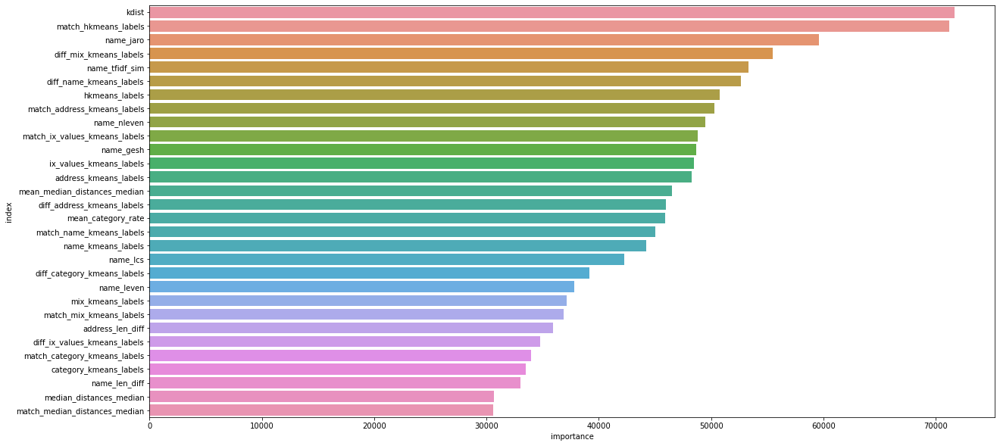

In [54]:
importance_df = pd.DataFrame(models[0].feature_importances_, 
                             index=features, 
                             columns=['importance'])\
                    .sort_values("importance", ascending=False)


plt.figure(figsize=(20, 10))
sns.barplot(x="importance", y="index", data=importance_df.head(30).reset_index(drop=False))
plt.show()

In [55]:
del train_X, train_y, valid_X, valid_y, models

# Change Submission Format

In [56]:
tmp = train[['id', 'match_id', 'label']]
tmp[['pred_0', 'pred_1']] = oof

In [57]:
tmp.to_csv(os.path.join(OUTPUT_PATH, 'oof.csv'), index = False)

### memoryリセットかけた

In [58]:
oof = pd.read_csv(os.path.join(OUTPUT_PATH, 'oof.csv'))
oof.head()

,id,match_id,label,pred_0,pred_1
0,E_000f778cea1dd5,E_b8cf618b944115,1,0.027759,0.972241
1,E_000fa08832fbd7,E_0cce28805091fd,0,0.999835,0.000165
2,E_001ff887b6e717,E_f7aa0821c91956,1,0.005344,0.994656
3,E_00219328bc7ecb,E_6f272b9533b508,1,0.002670,0.997330
4,E_0024fc2bd72ad5,E_b2cc39e9379c00,1,0.089522,0.910478


In [59]:
y_true = pd.read_csv(os.path.join(INPUT_PATH, 'train.csv'))[['id', 'point_of_interest']]
def get_id2poi(input_df: pd.DataFrame) -> dict:
    return dict(zip(input_df['id'], input_df['point_of_interest']))

def get_poi2ids(input_df: pd.DataFrame) -> dict:
    return input_df.groupby('point_of_interest')['id'].apply(set).to_dict()

id2poi = get_id2poi(y_true)
poi2ids = get_poi2ids(y_true)
del y_true

In [60]:
ids = list(data.index.unique())
oof_pred = {
   id_x: [id_x] for id_x in ids
}

for idx, row in tqdm(oof.iterrows()):
    if row['pred_0'] < row['pred_1']:
        oof_pred[row['id']].append(row['match_id'])

0it [00:00, ?it/s]

In [61]:
# ids = list(oof.id.unique())
# oof_pred = {
#    id_x: [id_x] for id_x in ids
# }

# for idx, row in tqdm(oof.iterrows()):
#     if row['pred_0'] < row['pred_1']:
#         oof_pred[row['id']].append(row['match_id'])
#     if 0.9 < row['pred_1'] and len(oof_pred[row['id']]) > 1:
#         base = row['id']
#         match = oof_pred[row['id']]
#         for m in match:
#             if base not in oof_pred[m]:
#                 oof_pred[m].append(base)

In [62]:
scores = []
for id_x in tqdm(ids):
    preds = set(oof_pred[id_x])
    targets = poi2ids[id2poi[id_x]]
    score = len((targets & preds)) / len((targets | preds))
    scores.append(score)
print('cv score is', np.array(scores).mean())
# 0.8643
# 0.8709

  0%|          | 0/1138812 [00:00<?, ?it/s]

cv score is 0.8717005896944966


In [30]:
for base, match in oof_pred.items():
    if len(match) == 1:        
        continue

    for m in match:
        if base not in oof_pred[m]:
            oof_pred[m].append(base)

In [31]:
scores = []
for id_x in tqdm(ids):
    preds = set(oof_pred[id_x])
    targets = poi2ids[id2poi[id_x]]
    score = len((targets & preds)) / len((targets | preds))
    scores.append(score)
print('cv score is', np.array(scores).mean())

  0%|          | 0/1138812 [00:00<?, ?it/s]

cv score is 0.8774470646556609


# Check Misclassification 

In [ ]:
oof['pred'] = oof['pred_1'].round()
tmp = oof[['id', 'match_id', 'label', 'pred', 'pred_1']]

In [ ]:
t = tmp[tmp['label']!=tmp['pred']]
tt = t[t['pred_1']<0.2]

In [39]:
len(t)

294015

In [40]:
tt

,id,match_id,label,pred,pred_1
1856,E_00dcbf399a3c66,E_04852c224633d4,1,0.0,0.017055
4461,E_020e76b9a1aadf,E_9fcab1f6916cf5,1,0.0,0.107608
9905,E_04852c224633d4,E_04852c224633d4,1,0.0,0.017055
24529,E_0b0cce8f893902,E_04852c224633d4,1,0.0,0.017055
30843,E_0deadd4f30d3d5,E_667f89b72fd353,1,0.0,0.112426
...,...,...,...,...,...
13629395,E_327aee37a41d46,E_3eb1d25a6402f4,1,0.0,0.126603
13629397,E_3eb1d25a6402f4,E_327aee37a41d46,1,0.0,0.148675
13629601,E_8c503cfc915096,E_c44f57de58697a,1,0.0,0.061348
13629685,E_8c503cfc915096,E_1ad70db6ae0fb0,1,0.0,0.001235


In [69]:
id = 'E_0146e712d66bb8'
m_id = 'E_512009c07275bc'
ids = [id, m_id]
data[data.index.isin(ids)]
# data[data.id.isin(ids)]

,name,latitude,longitude,address,city,state,zip,country,url,phone,categories,point_of_interest,cv
id,,,,,,,,,,,,,
E_0146e712d66bb8,<MOJIBAKE>,38.415602,-95.925751,<MOJIBAKE>,<MOJIBAKE>,KS,NaN,US,NaN,NaN,Ethiopian Restaurants,P_69622d58c8ee75,0.0
E_512009c07275bc,<MOJIBAKE>,38.415602,-95.925751,<MOJIBAKE>,<MOJIBAKE>,KS,NaN,US,NaN,NaN,Ethiopian Restaurants,P_246d233ae0de45,0.0


In [60]:
train[(train['id']==id) & (train['match_id']==m_id)][['kdist', 'categories_jaro', 'name_jaro', 'categories_lcs', 'name_tfidf_sim', 'name_leven', 'name_nleven']]

,kdist,categories_jaro,name_jaro,categories_lcs,name_tfidf_sim,name_leven,name_nleven
9905,0.0,1.0,1.0,21.0,1.0,0.0,0.0


In [58]:
train.name_lcs.min()

0.0

In [64]:
train[
    (train['kdist']==0.0) &
    (train['categories_jaro']==1.0) & 
    (train['name_jaro']==1.0) & 
    (train['label']==0)
][['id', 'match_id', 'kdist', 'categories_jaro', 'name_jaro', 'categories_lcs', 'name_tfidf_sim', 'name_leven', 'name_nleven', 'label']]

,id,match_id,kdist,categories_jaro,name_jaro,categories_lcs,name_tfidf_sim,name_leven,name_nleven,label
140,E_000fa08832fbd7,E_512009c07275bc,0.0,1.0,1.0,21.0,1.0,0.0,0.0,0
778,E_005c564d80c2d1,E_512009c07275bc,0.0,1.0,1.0,21.0,1.0,0.0,0.0,0
1582,E_00bd2a9a2d54c8,E_512009c07275bc,0.0,1.0,1.0,21.0,1.0,0.0,0.0,0
2767,E_0146e712d66bb8,E_512009c07275bc,0.0,1.0,1.0,21.0,1.0,0.0,0.0,0
2790,E_014a49875a76e4,E_512009c07275bc,0.0,1.0,1.0,21.0,1.0,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...
6809145,E_fef4c4a94984f9,E_c44d10b8f736f9,0.0,1.0,1.0,21.0,1.0,0.0,0.0,0
6809318,E_ff93633cc7fd72,E_c44d10b8f736f9,0.0,1.0,1.0,21.0,1.0,0.0,0.0,0
6809356,E_ffbb249225efe1,E_c44d10b8f736f9,0.0,1.0,1.0,21.0,1.0,0.0,0.0,0
6809369,E_ffc7391cb47ab8,E_c44d10b8f736f9,0.0,1.0,1.0,21.0,1.0,0.0,0.0,0


In [65]:
train[
    (train['kdist']==0.0) &
    (train['categories_jaro']==1.0) & 
    (train['name_jaro']==1.0) & 
    (train['label']==1)
][['id', 'match_id', 'kdist', 'categories_jaro', 'name_jaro', 'categories_lcs', 'name_tfidf_sim', 'name_leven', 'name_nleven', 'label']]

,id,match_id,kdist,categories_jaro,name_jaro,categories_lcs,name_tfidf_sim,name_leven,name_nleven,label
0,E_000002eae2a589,E_000002eae2a589,0.0,1.0,1.0,21.0,1.0,0.0,0.0,1
1,E_000007f24ebc95,E_000007f24ebc95,0.0,1.0,1.0,20.0,1.0,0.0,0.0,1
2,E_000008a8ba4f48,E_000008a8ba4f48,0.0,1.0,1.0,18.0,1.0,0.0,0.0,1
3,E_00001d92066153,E_00001d92066153,0.0,1.0,1.0,19.0,1.0,0.0,0.0,1
4,E_000023d8f4be44,E_000023d8f4be44,0.0,1.0,1.0,4.0,1.0,0.0,0.0,1
...,...,...,...,...,...,...,...,...,...,...
6706754,E_743317b4eb1c75,E_743317b4eb1c75,0.0,1.0,1.0,16.0,1.0,0.0,0.0,1
6736612,E_ee010973acfdad,E_ee010973acfdad,0.0,1.0,1.0,21.0,1.0,0.0,0.0,1
6749528,E_1f721dd2083668,E_1f721dd2083668,0.0,1.0,1.0,16.0,1.0,0.0,0.0,1
6755238,E_3565b9b09b6731,E_c44d10b8f736f9,0.0,1.0,1.0,21.0,1.0,0.0,0.0,1


In [59]:
train.head(20)[['id', 'match_id', 'kdist', 'categories_jaro', 'name_jaro', 'categories_lcs', 'name_tfidf_sim', 'name_leven', 'name_nleven', 'label']]

,id,match_id,kdist,categories_jaro,name_jaro,categories_lcs,name_tfidf_sim,name_leven,name_nleven,label
0,E_000002eae2a589,E_000002eae2a589,0.0,1.0,1.0,21.0,1.0,0.0,0.0,1
1,E_000007f24ebc95,E_000007f24ebc95,0.0,1.0,1.0,20.0,1.0,0.0,0.0,1
2,E_000008a8ba4f48,E_000008a8ba4f48,0.0,1.0,1.0,18.0,1.0,0.0,0.0,1
3,E_00001d92066153,E_00001d92066153,0.0,1.0,1.0,19.0,1.0,0.0,0.0,1
4,E_000023d8f4be44,E_000023d8f4be44,0.0,1.0,1.0,4.0,1.0,0.0,0.0,1
5,E_00002a131a2bf6,E_00002a131a2bf6,0.0,1.0,1.0,17.0,1.0,0.0,0.0,1
6,E_0000764d65557e,E_0000764d65557e,0.0,1.0,1.0,21.0,1.0,0.0,0.0,1
7,E_00007dcd2bb53f,E_00007dcd2bb53f,0.0,1.0,1.0,15.0,1.0,0.0,0.0,1
8,E_0000890af22ff5,E_0000890af22ff5,0.0,1.0,1.0,12.0,1.0,0.0,0.0,1
9,E_0000f17c539685,E_0000f17c539685,0.0,1.0,1.0,10.0,1.0,0.0,0.0,1


In [43]:
# cols = ['kdist_country', 'kdist', 'categories_jaro', 'name_jaro']
# train[(train['id']==id) & (train['match_id']==m_id)][cols]

In [44]:
# train[train['kdist_country']== train['kdist']]

In [45]:
# data[data.index.isin(ids)].loc['E_34199c1154c0d9']['name'].split()

In [46]:
# data[data.index.isin(ids)].loc['E_0258802b17b98e']['name'].split()